# Tabular Datascience Project
## Models

In [31]:
!pip install -r requirments.txt

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.7/229.7 kB 393.3 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 965.4/965.4 kB 1.3 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.0/298.0 kB 142.6 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.2/63.2 kB 61.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 71.4 kB/s eta 0:00:0000:0100:03m
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.9/13.9 MB 117.8 kB/s eta 0:00:0000:0100:04
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.7/42.7 kB 127.6 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 101.5 kB/s eta 0:00:0000:010:01m
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 499.4/499.4 kB 203.8 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 142.1 kB/s eta 0:00:0000:0100:02
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [27]:
from collections import defaultdict
import numpy as np
from sklearn.impute import KNNImputer
from sklearn.mixture import GaussianMixture
from tqdm import tqdm
import sklearn.metrics as metrics
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering, Birch
from sklearn.manifold import TSNE, SpectralEmbedding, Isomap, MDS
import scipy.spatial as sp
import time
from pathlib import Path
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import load_digits
from typing import Dict, List
from sklearn.datasets import load_iris


random_state = 0
np.random.seed(random_state)
sns.set_theme()

In [28]:
def plot_clusters(labels, X, figname: str):
    plt.figure(figsize=(10, 5))
    X_embeddings = TSNE(n_components=2).fit_transform(X)
    plt.scatter(X_embeddings[:, 0], X_embeddings[:, 1], c=labels, s=40, cmap='viridis', zorder=2)
    plt.title(f"Cluster Visualization using TSNE - {figname}")
    plt.legend()
    plt.show()
    plt.clf()


def plot_scores(scores: Dict[str, List[float]], k_range: List[int]):
    for method_name, method_scores in scores.items():
        plt.plot(k_range, method_scores, label=method_name)
    plt.legend()
    plt.title("Method scores over K")
    plt.xlabel("Number Of Neighborhood")
    plt.ylabel("Mean Squared Error")
    plt.show()

In [29]:
def reduce_dimension(X):
    models = [TSNE(n_components=2), Isomap(n_components=2), MDS(n_components=2), SpectralEmbedding(n_components=2)]
    fig, axs = plt.subplots(nrows=len(models), ncols=1, figsize=(8, 8))
    fig.tight_layout()
    for i, model in tqdm(enumerate(models)):
        X_embedded_tsne = model.fit_transform(X)
        axs[i].scatter(X_embedded_tsne[:, 0], X_embedded_tsne[:, 1], s=40, cmap='viridis')
        axs[i].set_title(f"{model} dimensionality reduction")
    plt.show()
    plt.clf()

In [30]:
def cluster_with_nan_by_cosine_sim(X, model):
    clean_X = X[~np.isnan(X).any(axis=1)]
    good_labels = model.fit_predict(clean_X)
    unique_labels = np.unique(good_labels[good_labels != -1])
    k = len(unique_labels)
    nan_X = X[np.isnan(X).any(axis=1)]
    nan_columns = np.unique(np.argwhere(np.isnan(nan_X))[:, 1])
    consine = 1 - sp.distance.cdist(np.delete(nan_X, nan_columns, 1), np.delete(clean_X, nan_columns, 1), 'cosine')
    nan_cosine_per_label = np.zeros((k, nan_X.shape[0]))
    for label_id in unique_labels:
        nan_cosine_per_label[label_id] = consine[:, good_labels == label_id].mean(axis=1)
    labels = np.zeros(X.shape[0])
    labels[~np.isnan(X).any(axis=1)] = good_labels.copy()
    if len(nan_cosine_per_label) != 0:
        labels[np.isnan(X).any(axis=1)] = nan_cosine_per_label.argmax(axis=0)
    else:
        labels[np.isnan(X).any(axis=1)] = 0
    return labels, good_labels

In [31]:
def non_density_based_knn(clusters: np.ndarray, missing_y: np.ndarray, X: np.ndarray, k: int):
    y_pred = missing_y.copy()
    for cluster_id in tqdm(np.unique(clusters)):
        imputer = KNNImputer(n_neighbors=k, weights="uniform")
        curr_X_cluster = X[clusters == cluster_id]
        curr_y_cluster = missing_y[clusters == cluster_id]
        curr_data = np.hstack((curr_X_cluster, curr_y_cluster.reshape(-1, 1)))
        y_pred[clusters == cluster_id] = imputer.fit_transform(curr_data)[:, -1]
    return y_pred


def knn_imputer(clusters: np.ndarray, X: np.ndarray, y_true: np.ndarray, k=15):
    scores = {}
    nan_column = np.argwhere(np.any(np.isnan(X), axis=0))[0][0]
    missing_y = X[:, nan_column]
    scores.update(get_baseline_models_scores(X, missing_y, k, y_true))
    y_pred = non_density_based_knn(clusters, missing_y, X, k)
    scores["CBKnn"] = metrics.mean_squared_error(y_true, y_pred)
    return scores

In [41]:
def _cluster_data(X: np.ndarray, model_obj, model_name: str, min_k: int, max_k: int):
    scores = []
    possible_k = list(range(min_k, max_k))
    clean_X = X[~np.isnan(X).any(axis=1)]
    for k in tqdm(possible_k):
        curr_model = model_obj(k)
        labels, good_labels = cluster_with_nan_by_cosine_sim(X, curr_model)
        scores.append(metrics.silhouette_score(clean_X, good_labels))
    plt.plot(possible_k, scores)
    plt.title(f"silhouette_score over K - {model_name}")
    plt.xlabel("K over time")
    plt.ylabel("Silhouette Score")
    plt.show()
    plt.clf()
    best_k = possible_k[np.argmax(scores)]
    best_model = model_obj(best_k)
    best_clusters, good_labels = cluster_with_nan_by_cosine_sim(X, best_model)
    plot_clusters(good_labels, clean_X, f"{model_name} - {best_k}")
    print(f"{model_name} - {best_k}, score: {np.max(scores)}")
    return best_clusters, np.max(scores)

In [32]:
def cluster_data(X: np.ndarray, min_k=3, max_k=40):
    possible_models = [
        (lambda k: KMeans(k, random_state=random_state), "Kmean"),
        (lambda k: GaussianMixture(k, max_iter=3000), "GaussianMixture"),
        (lambda k: AgglomerativeClustering(k), "AgglomerativeClustering"),
        (lambda k: Birch(n_clusters=k), "Birch")
    ]
    best_model = None
    best_score = 0
    for model, model_name in possible_models:
        model, score = _cluster_data(X, model, model_name, min_k, max_k)
        if score > best_score:
            best_score = score
            best_model = model
    return best_model

In [33]:
max_by_silhouette = True
def get_best_dbscan_params(clean_X: np.ndarray, min_samples: int):
    range_eps = np.linspace(0.1, 10, 1000)
    scores = []
    for eps in range_eps:
        model = DBSCAN(eps=eps, min_samples=min_samples)
        good_labels = model.fit_predict(clean_X)
        noisy_data_count = len(good_labels[good_labels == -1])
        num_clusters = len(np.unique(good_labels[good_labels != -1]))
        print(f"noisy data count with eps={eps}: {noisy_data_count}")
        if noisy_data_count > good_labels.shape[0]*0.3 or num_clusters < 2:
            scores.append(0)
            continue
        if max_by_silhouette:
            try:
                score = metrics.silhouette_score(clean_X, good_labels)
            except:
                score = 0
        else:
            score = num_clusters
        scores.append(num_clusters)
    plt.plot(range_eps, scores)
    plt.show()
    return range_eps[np.argmax(scores)]


def get_densities(clean_X: np.ndarray, labels: np.ndarray, plot_densities: bool = True) -> np.ndarray:
    clusters_ids, counts = np.unique(labels, return_counts=True)
    densities = []
    for label, count in zip(clusters_ids, counts):
        if label == -1:
            continue
        points = clean_X[labels == label]
        volume = (points.max(axis=0) - points.min(axis=0) + 0.0001).prod()
        density = count / volume
        densities.append(density)
    densities = np.array(densities)
    if plot_densities:
        plt.bar(list(range(len(densities))), densities)
        plt.xlabel("cluster id")
        plt.ylabel("weight of k")
        plt.show()
        plt.clf()
    return densities


def _density_based_knn(missing_y: np.ndarray, densities: np.ndarray, all_labels: np.ndarray, k: int, X: np.ndarray):
    y_pred = missing_y.copy()
    min_k = 0.1 * k
    max_k = k
    curr_densities = (((densities - densities.min()) * (max_k - min_k)) / (
            densities.max() - densities.min()) + min_k).astype(int) + 1
    print(curr_densities, k)
    for cluster_id in np.unique(all_labels):
        cluster_k = curr_densities[int(cluster_id)] if cluster_id != -1 else 1
        imputer = KNNImputer(n_neighbors=cluster_k, weights="uniform")
        curr_X_cluster = X[all_labels == cluster_id]
        curr_y_cluster = missing_y[all_labels == cluster_id]
        curr_data = np.hstack((curr_X_cluster, curr_y_cluster.reshape(-1, 1)))
        y_pred[all_labels == cluster_id] = imputer.fit_transform(curr_data)[:, -1]
    return y_pred


def density_based_knn(X: np.ndarray, y_true, min_samples=2, best_eps=None):
    clean_X = X[~np.isnan(X).any(axis=1)]
    nan_column = np.argwhere(np.any(np.isnan(X), axis=0))[0][0]
    missing_y = X[:, nan_column]
    if best_eps is None:
        best_eps = get_best_dbscan_params(clean_X, min_samples)
    best_model = DBSCAN(eps=best_eps, metric="euclidean", min_samples=min_samples, n_jobs=-1)
    all_labels, labels = cluster_with_nan_by_cosine_sim(X, best_model)
    print(f"noisy data count: {len(labels[labels == -1])}")
    plot_clusters(labels, clean_X, "DBSCAN")
    densities = get_densities(clean_X, labels)
    all_scores = defaultdict(list)
    k_range = list(range(10, 60))
    for k in tqdm(k_range):
        scores = get_baseline_models_scores(X, missing_y, k, y_true)
        y_pred = _density_based_knn(missing_y, densities, all_labels, k, X)
        scores["CBKnn"] = metrics.mean_squared_error(y_true, y_pred)
        for key, value in scores.items():
            all_scores[key].append(value)
    plot_scores(all_scores, k_range)
    return all_scores


def get_baseline_models_scores(X, missing_y, k, y_true):
    scores = {}
    for imputer, imputer_name in [(KNNImputer(n_neighbors=k, weights="uniform"), "KNNImputer")]:
        y_pred = imputer.fit_transform(np.hstack((X, missing_y.reshape(-1, 1))))[:, -1]
        scores[imputer_name] = metrics.mean_squared_error(y_true, y_pred)
    return scores

In [34]:
def eval_methods_over_k(X, y_true):
    best_clusters = cluster_data(X)
    all_scores = defaultdict(list)
    k_range = list(range(15, 60))
    for k in k_range:
        scores = knn_imputer(best_clusters, X, y_true.copy(), k)
        for key, value in scores.items():
            all_scores[key].append(value)
    plot_scores(all_scores, k_range)

## Datasets Loaders

In [35]:

def load_mnist(nan_percentage: float):
    MISSING_FEATURE = 35
    df = pd.DataFrame(load_digits().data)
    nan_indices = np.random.uniform(size=df[MISSING_FEATURE].shape[0]) < nan_percentage
    y_true = df[MISSING_FEATURE].values.copy()
    df[MISSING_FEATURE][nan_indices] = np.nan
    scaler = StandardScaler()
    df = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)
    return df, y_true


In [36]:
def load_titanic(nan_percentage: float, uniform_nan: bool = True):
    df_train = pd.read_csv("./datasets/titanic/train.csv")
    df_test = pd.read_csv("./datasets/titanic/test.csv")
    df = pd.concat([df_test, df_train])
    df = df.drop(['PassengerId', 'Name', 'Cabin', 'Ticket'], axis=1)
    df = df[df['Survived'].notna()]
    df = df[df['Embarked'].notna()]
    df = df[df["Age"].notna()]
    print(df["Embarked"].value_counts())
    y_true = df["Age"].values.copy()
    if uniform_nan:
        nan_indices = np.random.uniform(size=df["Age"].shape[0]) < nan_percentage
        df["Age"][nan_indices] = np.nan
    else:
        nan_mask = np.random.uniform(size=df["Embarked"].shape[0]) < 0.8
        df["Age"][(df["Embarked"] == 'C') & nan_mask] = np.nan
    le = LabelEncoder()
    df['Sex'] = le.fit_transform(df['Sex'])
    df['Embarked'] = le.fit_transform(df['Embarked'])
    scaler = StandardScaler()
    df = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)
    return df, y_true

In [37]:
def load_mobile_price_dataset(nan_percentage: float):
    df = pd.concat([pd.read_csv("./datasets/mobile_price/test.csv"),
                    pd.read_csv("./datasets/mobile_price/train.csv")])
    df = df.drop(["id"],axis=1)
    df = df[df["price_range"].notna()]
    NAN_COLUMN = "battery_power"
    nan_indices = np.random.uniform(size=df[NAN_COLUMN].shape[0]) < nan_percentage
    y_true = df[NAN_COLUMN].values.copy()
    df[NAN_COLUMN][nan_indices] = np.nan
    scaler = StandardScaler()
    df = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)
    return df, y_true

In [38]:
def load_iris_dataset(nan_percentage: float):
    iris = load_iris()
    df = pd.DataFrame(data= np.c_[iris['data'], iris['target']],
                         columns= iris['feature_names'] + ['target'])
    NAN_COLUMN = "petal width (cm)"
    nan_indices = np.random.uniform(size=df[NAN_COLUMN].shape[0]) < nan_percentage
    y_true = df[NAN_COLUMN].values.copy()
    df[NAN_COLUMN][nan_indices] = np.nan
    scaler = StandardScaler()
    df = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)
    return df, y_true

# Main Expriments
## load mobile dataset

In [53]:
df, y_true = load_mobile_price_dataset(nan_percentage=0.2)
X = df.values
df.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,-0.907969,-0.990050,0.830779,-1.019184,-0.762495,-1.043966,-1.380644,0.340740,1.349249,-1.101971,...,-1.408949,-1.146784,0.391703,-0.784983,0.283103,1.462493,-1.786861,-1.006018,0.986097,-0.447214
1,-0.496512,1.010051,-1.253064,0.981177,-0.992890,0.957886,1.155024,0.687548,-0.120059,-0.664768,...,0.585778,1.704465,0.467317,1.114266,-0.635317,-0.734267,0.559641,0.994018,-1.014099,0.447214
2,-1.549291,1.010051,-1.253064,0.981177,-0.532099,0.957886,0.493546,1.381165,0.134244,0.209639,...,1.392684,1.074968,0.441498,-0.310171,-0.864922,-0.368140,0.559641,0.994018,-1.014099,0.447214
3,-1.429761,1.010051,1.198517,-1.019184,-0.992890,-1.043966,-1.215274,1.034357,-0.261339,0.646842,...,1.286750,1.236971,0.594569,0.876859,0.512708,-0.002014,0.559641,-1.006018,-1.014099,0.447214
4,1.342401,1.010051,-0.395011,-1.019184,2.002254,0.957886,0.658915,0.340740,0.021220,-1.101971,...,1.268718,-0.091452,-0.657666,-1.022389,-0.864922,0.730240,0.559641,0.994018,-1.014099,-0.447214


### Simple Method
Simple methods witout using densties of cluster for varying K of KNN
Methods:
- KMeans
- GaussianMixture
- AgglomerativeClustering
- Birch

100%|███████████████████████████████████████████| 37/37 [00:12<00:00,  2.92it/s]


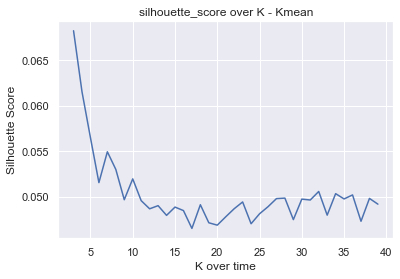

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

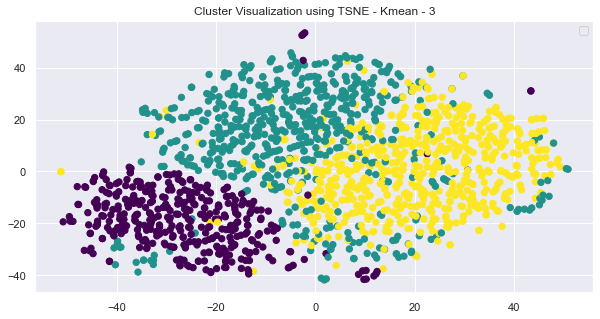

Kmean - 3, score: 0.06823303229389292


100%|███████████████████████████████████████████| 37/37 [00:40<00:00,  1.11s/it]


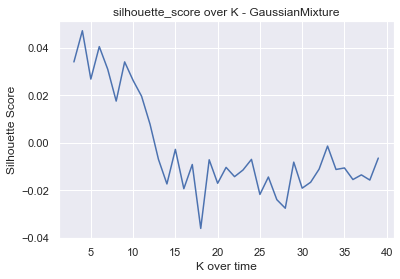

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

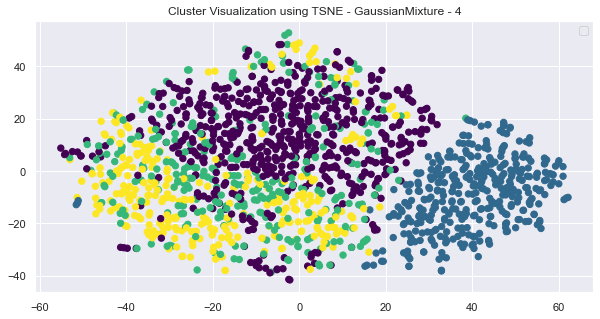

GaussianMixture - 4, score: 0.047214754312410054


100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 18.10it/s]


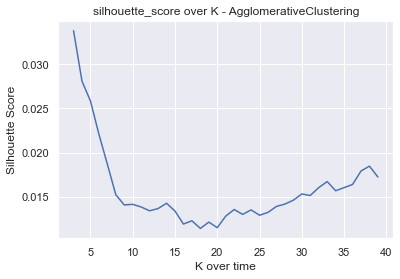

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

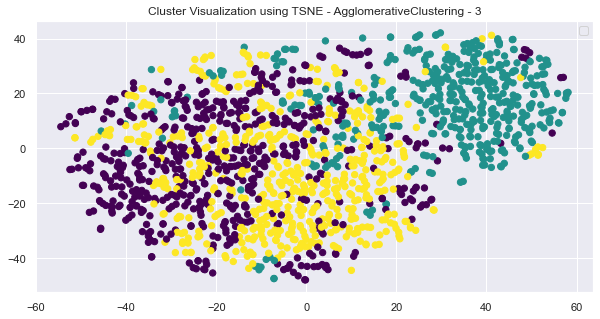

AgglomerativeClustering - 3, score: 0.03380956243111994


100%|███████████████████████████████████████████| 37/37 [00:04<00:00,  8.19it/s]


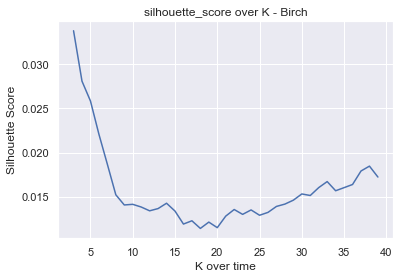

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

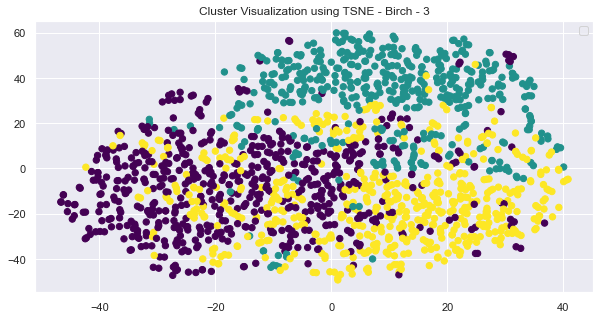

Birch - 3, score: 0.03380956243111994


100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 149.18it/s]


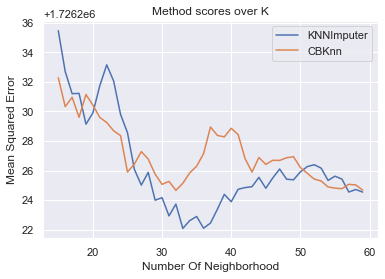

In [56]:
eval_methods_over_k(X, y_true)

### Advanced Method
DBSCAN using densties of cluster for varying K of KNN

Note: we use only DBSCAN becouse the clusting objective there is to cluster points with similar density value

noisy data count with eps=0.1: 1605
noisy data count with eps=0.10990990990990991: 1605
noisy data count with eps=0.11981981981981983: 1605
noisy data count with eps=0.12972972972972974: 1605
noisy data count with eps=0.13963963963963966: 1605
noisy data count with eps=0.14954954954954958: 1605
noisy data count with eps=0.15945945945945947: 1605
noisy data count with eps=0.1693693693693694: 1605
noisy data count with eps=0.17927927927927928: 1605
noisy data count with eps=0.1891891891891892: 1605
noisy data count with eps=0.19909909909909912: 1605
noisy data count with eps=0.20900900900900904: 1605
noisy data count with eps=0.21891891891891893: 1605
noisy data count with eps=0.22882882882882885: 1605
noisy data count with eps=0.23873873873873877: 1605
noisy data count with eps=0.24864864864864866: 1605
noisy data count with eps=0.2585585585585586: 1605
noisy data count with eps=0.2684684684684685: 1605
noisy data count with eps=0.2783783783783784: 1605
noisy data count with eps=0.28828

noisy data count with eps=1.8639639639639642: 1601
noisy data count with eps=1.8738738738738743: 1601
noisy data count with eps=1.883783783783784: 1601
noisy data count with eps=1.893693693693694: 1601
noisy data count with eps=1.903603603603604: 1601
noisy data count with eps=1.9135135135135137: 1601
noisy data count with eps=1.9234234234234238: 1601
noisy data count with eps=1.9333333333333336: 1599
noisy data count with eps=1.9432432432432436: 1599
noisy data count with eps=1.9531531531531534: 1599
noisy data count with eps=1.9630630630630634: 1599
noisy data count with eps=1.9729729729729732: 1599
noisy data count with eps=1.9828828828828833: 1599
noisy data count with eps=1.992792792792793: 1599
noisy data count with eps=2.002702702702703: 1599
noisy data count with eps=2.012612612612613: 1599
noisy data count with eps=2.0225225225225225: 1599
noisy data count with eps=2.0324324324324325: 1599
noisy data count with eps=2.0423423423423426: 1599
noisy data count with eps=2.052252252

noisy data count with eps=3.568468468468469: 437
noisy data count with eps=3.5783783783783787: 431
noisy data count with eps=3.5882882882882887: 424
noisy data count with eps=3.5981981981981987: 413
noisy data count with eps=3.608108108108109: 403
noisy data count with eps=3.6180180180180184: 392
noisy data count with eps=3.6279279279279284: 371
noisy data count with eps=3.6378378378378384: 360
noisy data count with eps=3.6477477477477485: 348
noisy data count with eps=3.657657657657658: 335
noisy data count with eps=3.667567567567568: 320
noisy data count with eps=3.677477477477478: 303
noisy data count with eps=3.6873873873873877: 290
noisy data count with eps=3.6972972972972977: 280
noisy data count with eps=3.7072072072072078: 272
noisy data count with eps=3.717117117117118: 261
noisy data count with eps=3.7270270270270274: 246
noisy data count with eps=3.7369369369369374: 233
noisy data count with eps=3.7468468468468474: 223
noisy data count with eps=3.7567567567567575: 210
noisy 

noisy data count with eps=5.302702702702703: 0
noisy data count with eps=5.312612612612613: 0
noisy data count with eps=5.322522522522522: 0
noisy data count with eps=5.332432432432433: 0
noisy data count with eps=5.342342342342342: 0
noisy data count with eps=5.352252252252253: 0
noisy data count with eps=5.3621621621621625: 0
noisy data count with eps=5.372072072072072: 0
noisy data count with eps=5.3819819819819825: 0
noisy data count with eps=5.391891891891892: 0
noisy data count with eps=5.401801801801802: 0
noisy data count with eps=5.411711711711712: 0
noisy data count with eps=5.421621621621622: 0
noisy data count with eps=5.431531531531531: 0
noisy data count with eps=5.441441441441442: 0
noisy data count with eps=5.451351351351351: 0
noisy data count with eps=5.461261261261262: 0
noisy data count with eps=5.4711711711711715: 0
noisy data count with eps=5.481081081081081: 0
noisy data count with eps=5.4909909909909915: 0
noisy data count with eps=5.500900900900901: 0
noisy dat

noisy data count with eps=7.066666666666667: 0
noisy data count with eps=7.076576576576577: 0
noisy data count with eps=7.0864864864864865: 0
noisy data count with eps=7.096396396396397: 0
noisy data count with eps=7.1063063063063066: 0
noisy data count with eps=7.116216216216217: 0
noisy data count with eps=7.126126126126127: 0
noisy data count with eps=7.136036036036036: 0
noisy data count with eps=7.145945945945947: 0
noisy data count with eps=7.155855855855856: 0
noisy data count with eps=7.165765765765766: 0
noisy data count with eps=7.175675675675676: 0
noisy data count with eps=7.185585585585586: 0
noisy data count with eps=7.195495495495496: 0
noisy data count with eps=7.205405405405406: 0
noisy data count with eps=7.215315315315316: 0
noisy data count with eps=7.225225225225226: 0
noisy data count with eps=7.235135135135136: 0
noisy data count with eps=7.245045045045045: 0
noisy data count with eps=7.254954954954956: 0
noisy data count with eps=7.264864864864865: 0
noisy data 

noisy data count with eps=8.800900900900901: 0
noisy data count with eps=8.810810810810812: 0
noisy data count with eps=8.820720720720722: 0
noisy data count with eps=8.830630630630631: 0
noisy data count with eps=8.840540540540541: 0
noisy data count with eps=8.85045045045045: 0
noisy data count with eps=8.86036036036036: 0
noisy data count with eps=8.870270270270272: 0
noisy data count with eps=8.880180180180181: 0
noisy data count with eps=8.89009009009009: 0
noisy data count with eps=8.9: 0
noisy data count with eps=8.90990990990991: 0
noisy data count with eps=8.919819819819821: 0
noisy data count with eps=8.929729729729731: 0
noisy data count with eps=8.93963963963964: 0
noisy data count with eps=8.94954954954955: 0
noisy data count with eps=8.95945945945946: 0
noisy data count with eps=8.96936936936937: 0
noisy data count with eps=8.97927927927928: 0
noisy data count with eps=8.98918918918919: 0
noisy data count with eps=8.9990990990991: 0
noisy data count with eps=9.00900900900

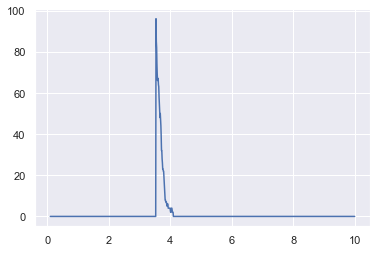

  0%|                                                    | 0/50 [00:00<?, ?it/s]/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


noisy data count: 469


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


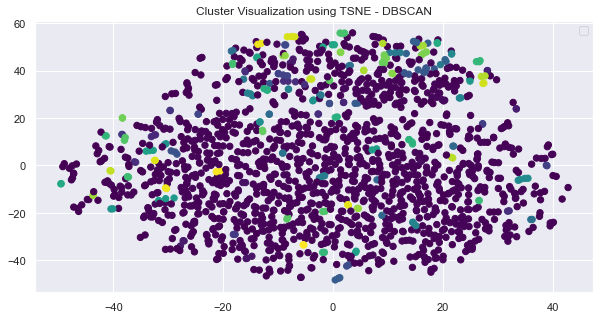

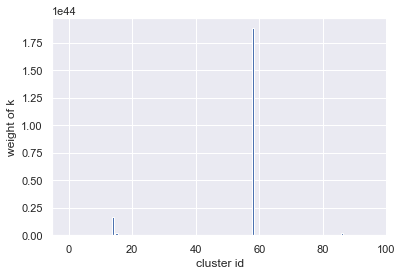

  2%|▉                                           | 1/50 [00:05<04:17,  5.25s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 11  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 10
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

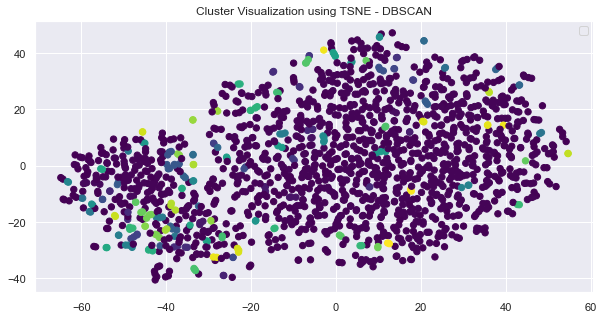

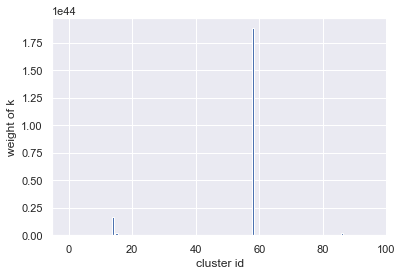

  4%|█▊                                          | 2/50 [00:10<04:21,  5.44s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 12  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 11
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

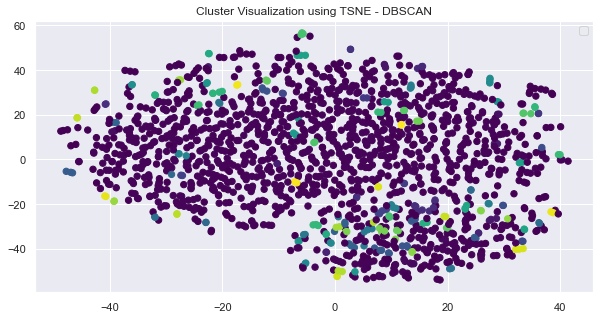

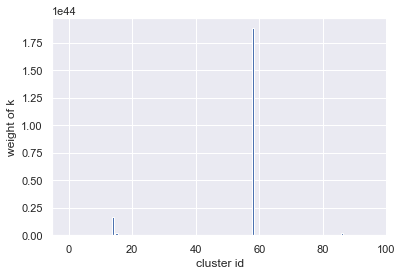

  6%|██▋                                         | 3/50 [00:16<04:25,  5.66s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 13  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 12
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

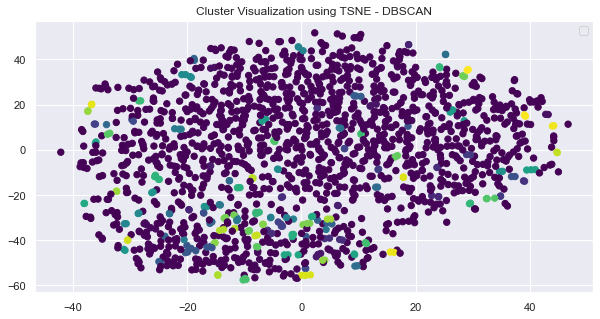

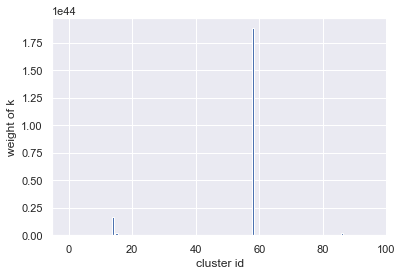

  8%|███▌                                        | 4/50 [00:21<04:11,  5.47s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 14  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 13
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

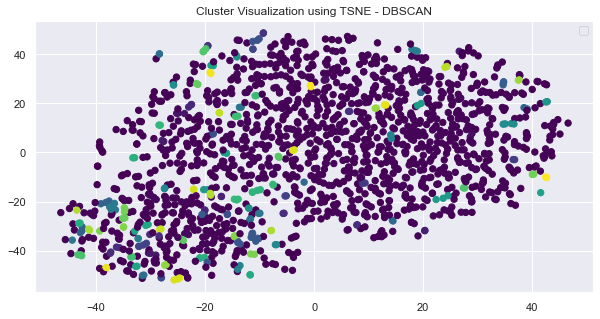

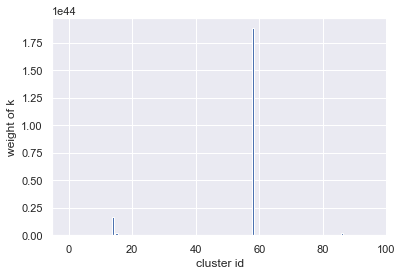

 10%|████▍                                       | 5/50 [00:27<04:04,  5.44s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 15  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 14
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

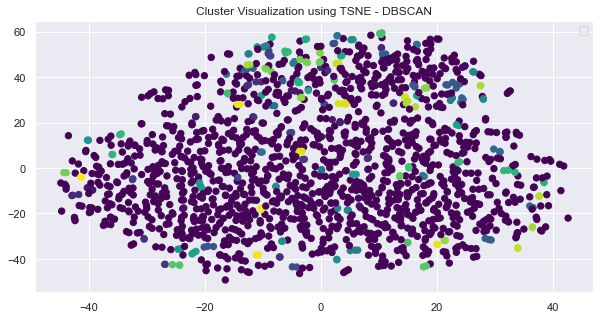

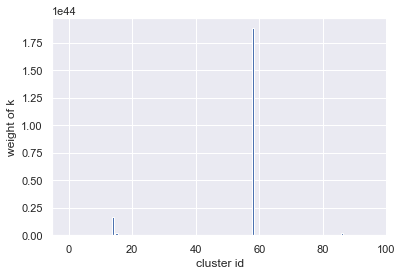

 12%|█████▎                                      | 6/50 [00:32<04:01,  5.48s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 16  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 15
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

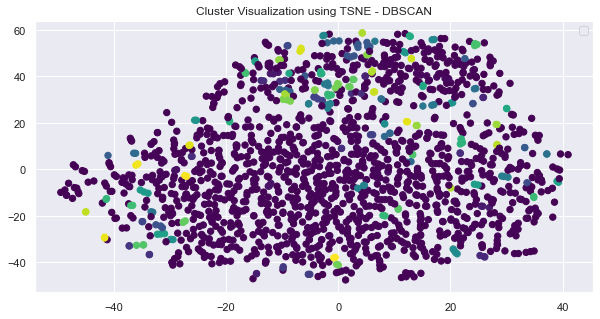

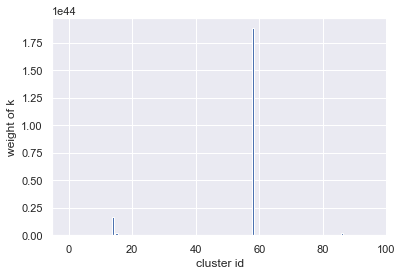

 14%|██████▏                                     | 7/50 [00:37<03:49,  5.33s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 17  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 16
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

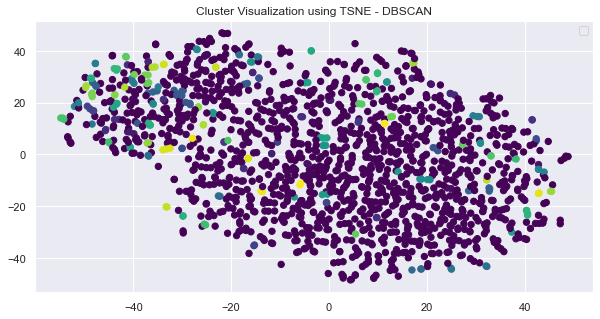

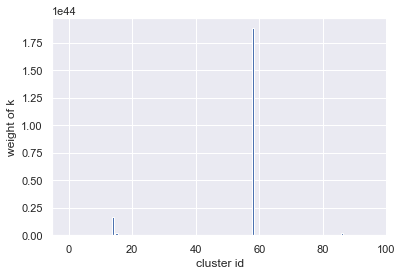

 16%|███████                                     | 8/50 [00:43<03:53,  5.55s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  4  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 18  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 17
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

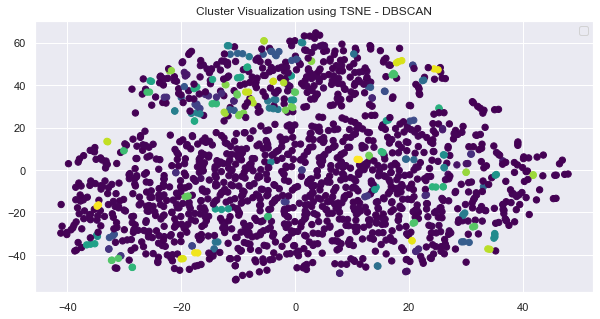

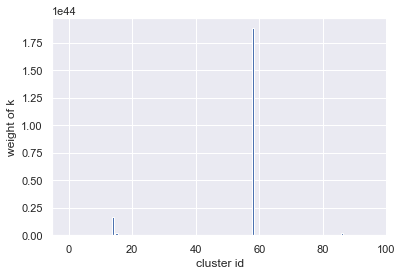

 18%|███████▉                                    | 9/50 [00:49<03:46,  5.52s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  4  3  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 19  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 18
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

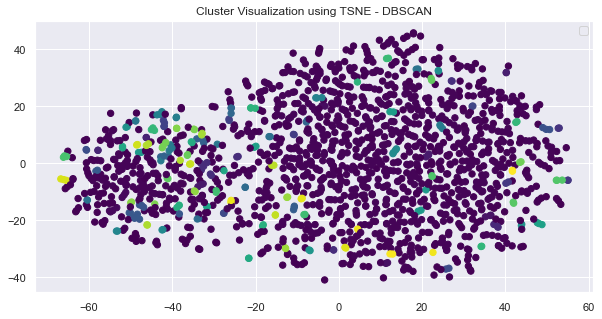

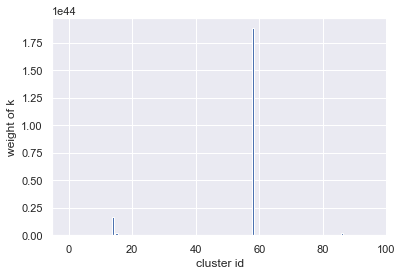

 20%|████████▌                                  | 10/50 [00:54<03:38,  5.47s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  4  3  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2 20  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2] 19
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

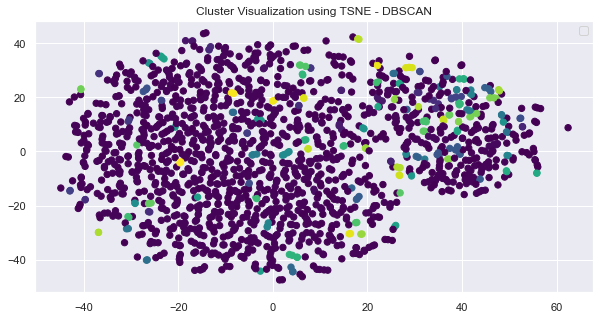

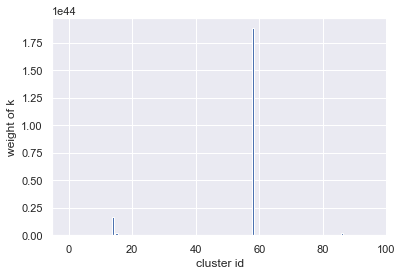

 22%|█████████▍                                 | 11/50 [00:59<03:28,  5.35s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 21  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 20
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

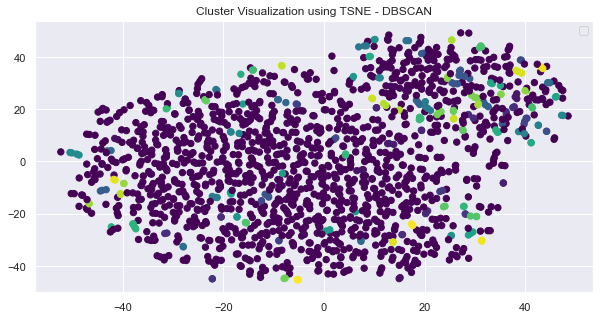

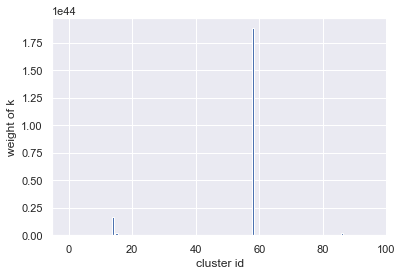

 24%|██████████▎                                | 12/50 [01:05<03:30,  5.55s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 22  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 21
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

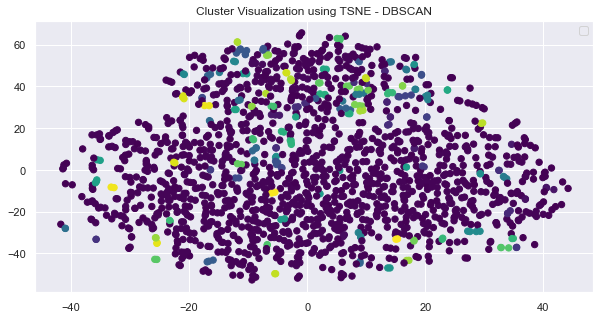

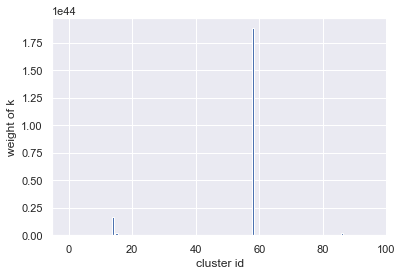

 26%|███████████▏                               | 13/50 [01:11<03:25,  5.55s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 23  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 22
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

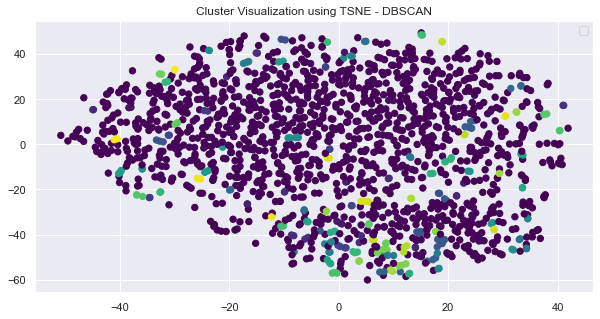

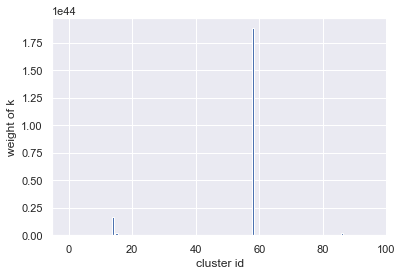

 28%|████████████                               | 14/50 [01:16<03:18,  5.53s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 24  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 23
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

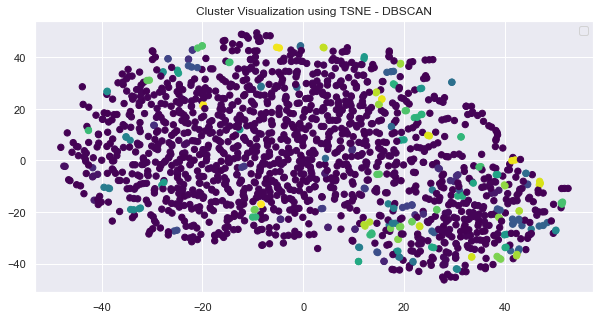

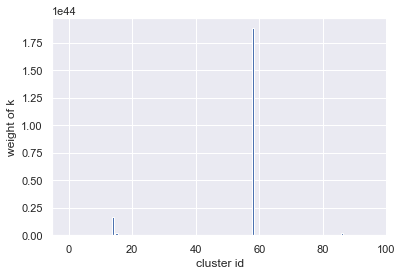

 30%|████████████▉                              | 15/50 [01:22<03:10,  5.44s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 25  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 24
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

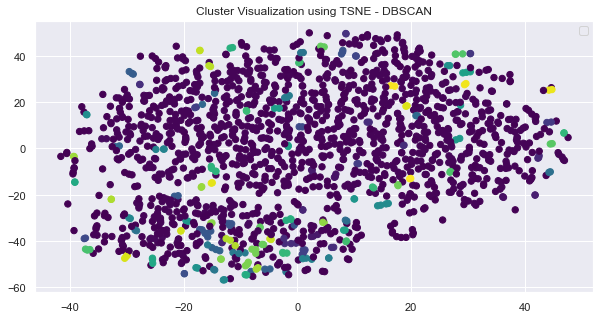

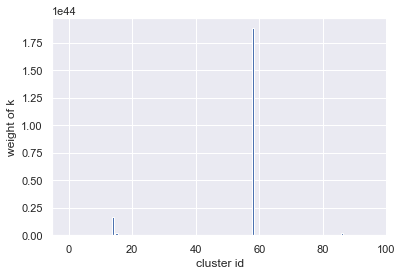

 32%|█████████████▊                             | 16/50 [01:27<03:09,  5.57s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 26  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 25
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

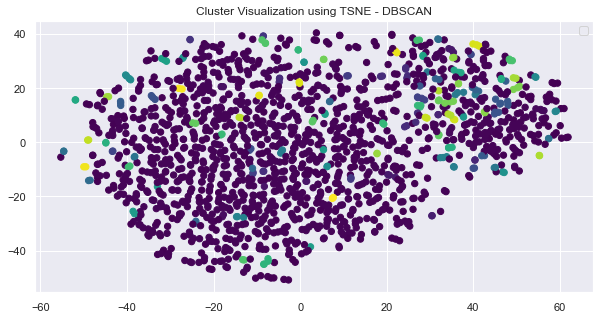

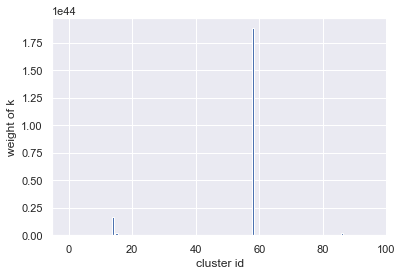

 34%|██████████████▌                            | 17/50 [01:33<03:07,  5.67s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 27  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 26
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

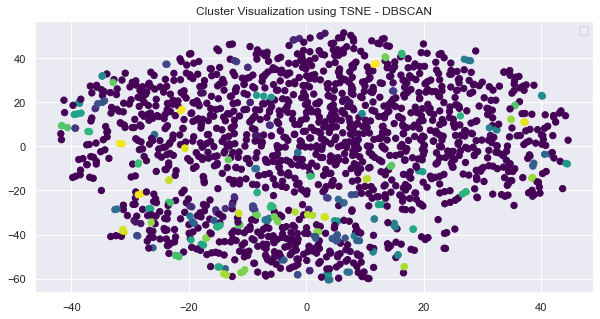

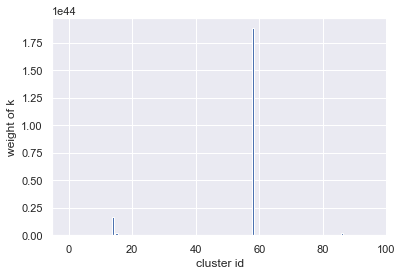

 36%|███████████████▍                           | 18/50 [01:38<02:56,  5.52s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  4  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 28  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 27
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

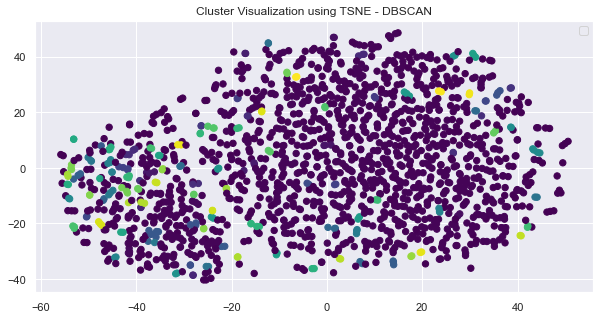

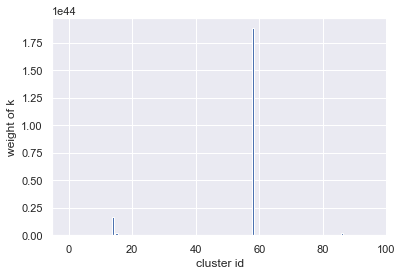

 38%|████████████████▎                          | 19/50 [01:44<02:50,  5.50s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  6  4  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 29  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3  3  3  3  3] 28
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

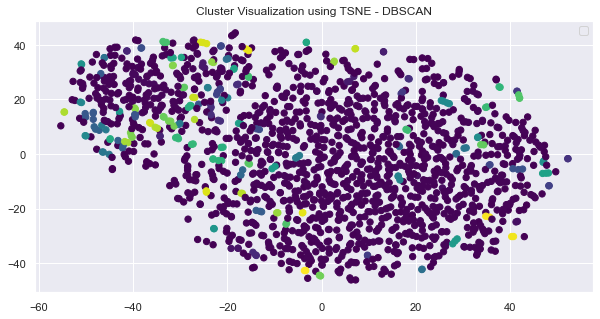

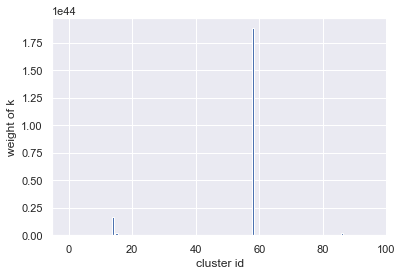

 40%|█████████████████▏                         | 20/50 [01:49<02:42,  5.41s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  6  4  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3 30  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3  3  3  3  3] 29
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

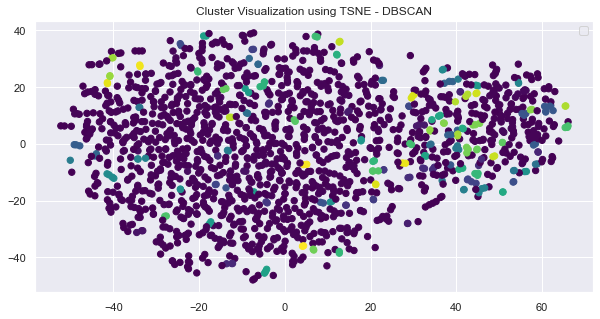

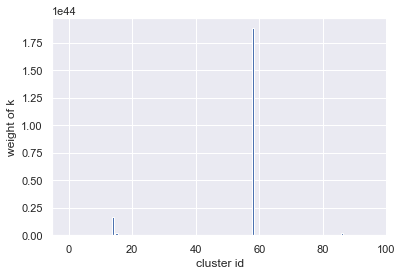

 42%|██████████████████                         | 21/50 [01:55<02:39,  5.48s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 31  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 30
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

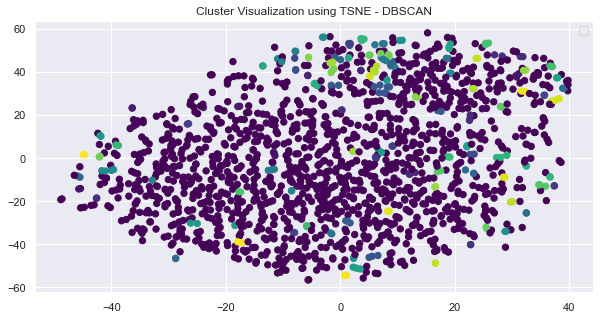

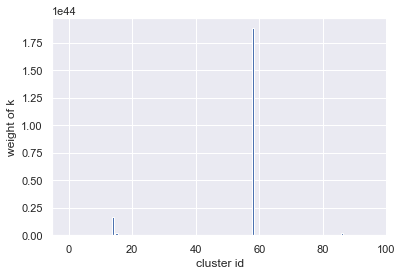

 44%|██████████████████▉                        | 22/50 [02:00<02:32,  5.44s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 32  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 31
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

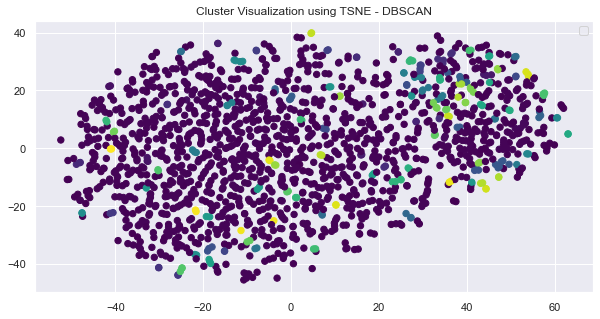

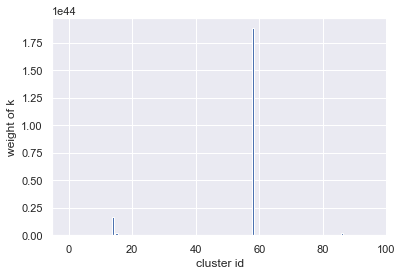

 46%|███████████████████▊                       | 23/50 [02:06<02:28,  5.49s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 33  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 32
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

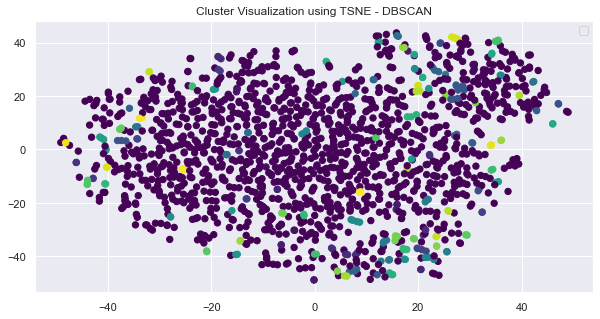

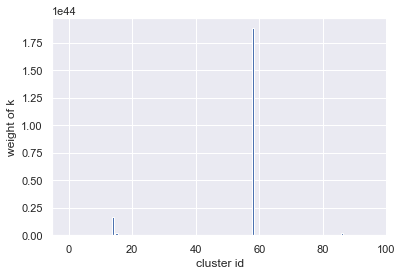

 48%|████████████████████▋                      | 24/50 [02:12<02:31,  5.85s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 34  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 33
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

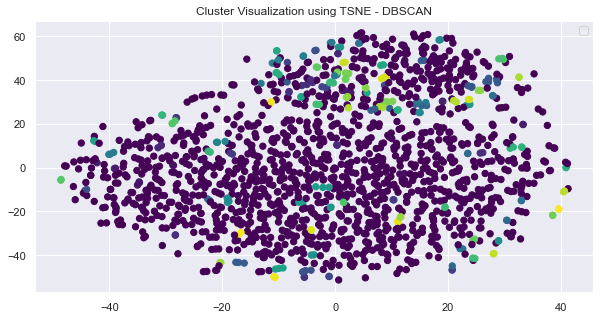

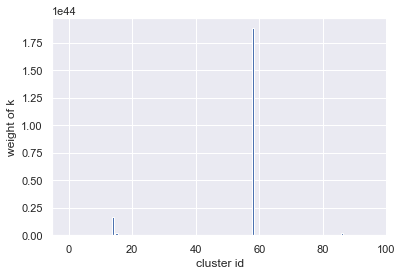

 50%|█████████████████████▌                     | 25/50 [02:18<02:24,  5.79s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  7  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 35  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 34
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

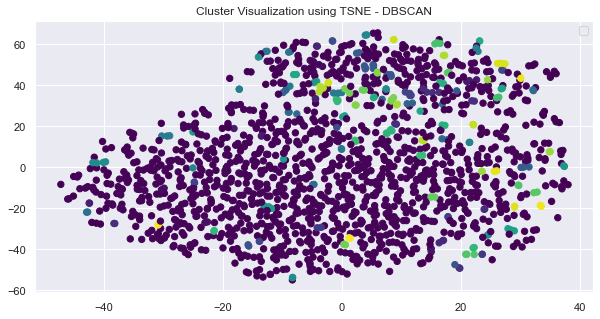

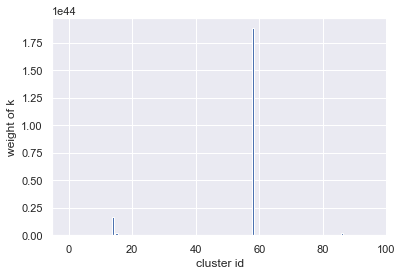

 52%|██████████████████████▎                    | 26/50 [02:23<02:12,  5.54s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  7  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 36  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 35
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

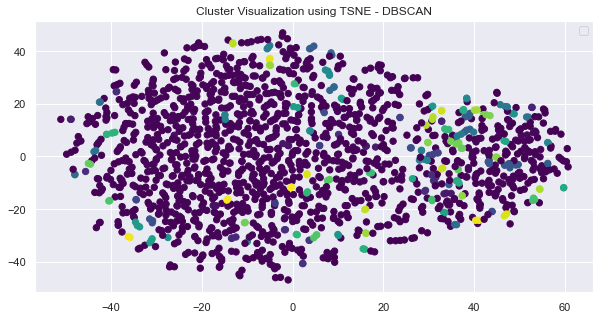

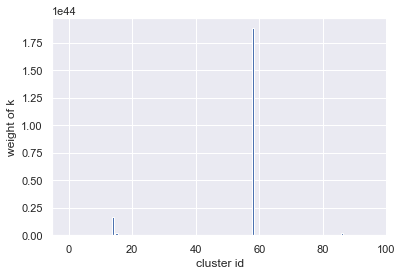

 54%|███████████████████████▏                   | 27/50 [02:29<02:11,  5.72s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  7  5  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 37  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 36
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

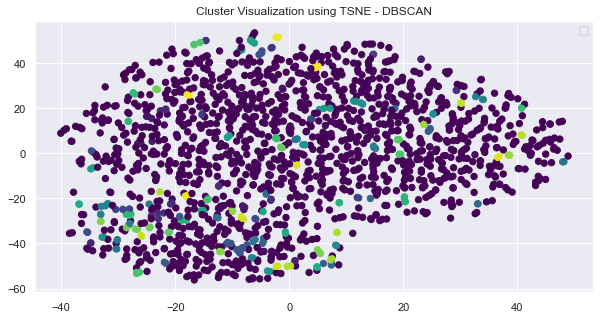

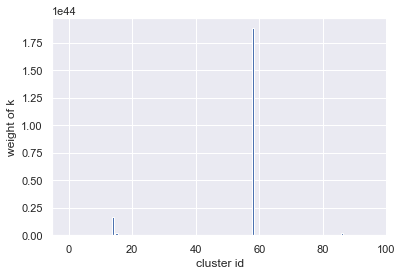

 56%|████████████████████████                   | 28/50 [02:37<02:16,  6.22s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  7  5  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 38  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  5  4  4  4  4  4  4  4  4  4] 37
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

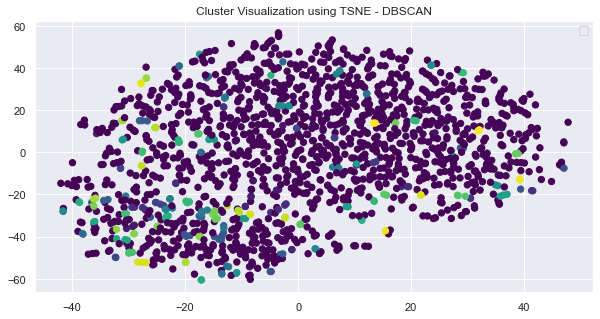

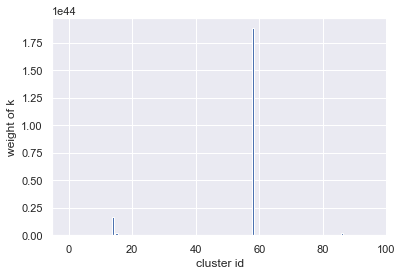

 58%|████████████████████████▉                  | 29/50 [02:43<02:14,  6.41s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  7  5  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 39  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  5  4  4  4  4  4  4  4  4  4] 38
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

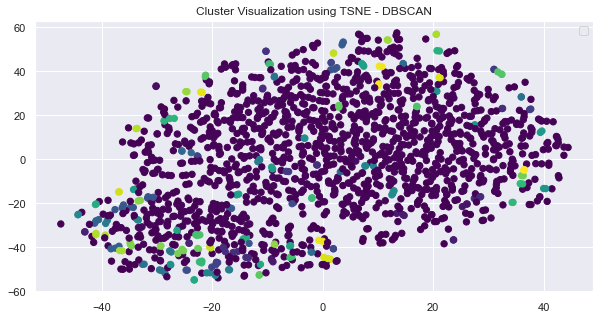

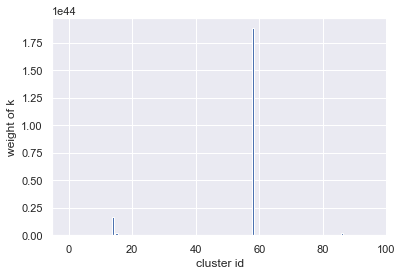

 60%|█████████████████████████▊                 | 30/50 [02:49<02:04,  6.22s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  8  5  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 40  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  5  4  4  4  4  4  4  4  4  4] 39
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

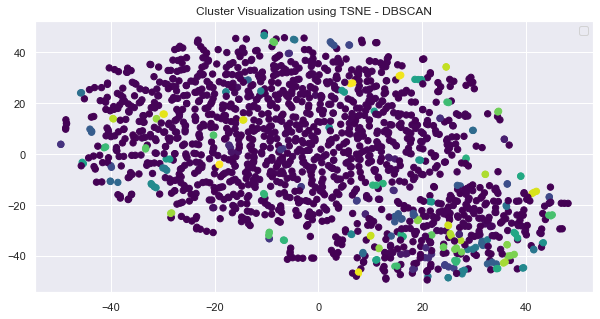

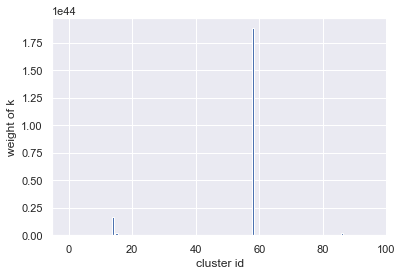

 62%|██████████████████████████▋                | 31/50 [02:55<01:57,  6.17s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 41  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 40
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

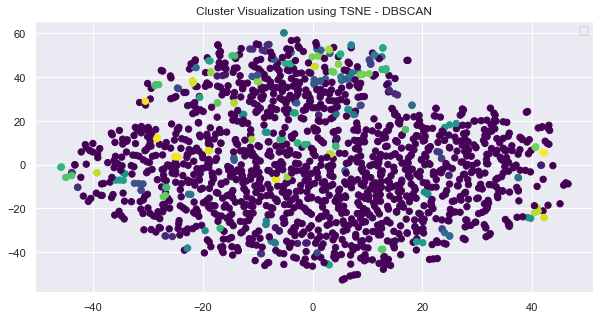

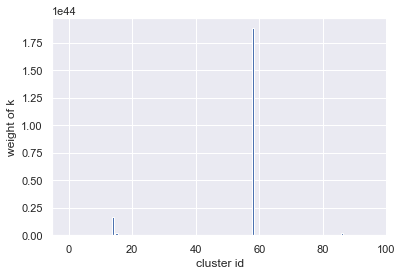

 64%|███████████████████████████▌               | 32/50 [03:01<01:48,  6.04s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 42  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 41
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

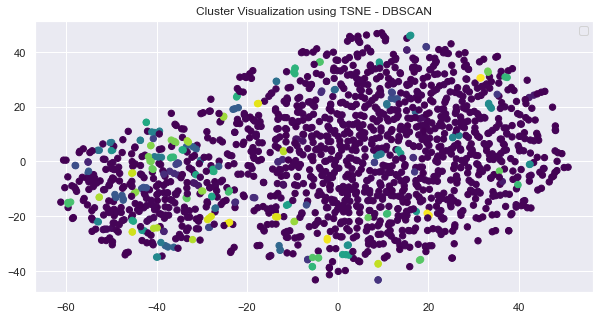

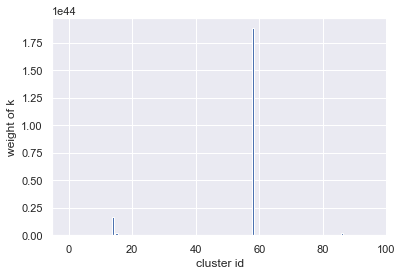

 66%|████████████████████████████▍              | 33/50 [03:06<01:39,  5.85s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 43  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 42
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

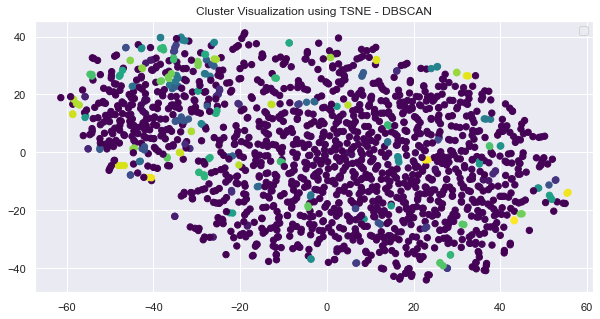

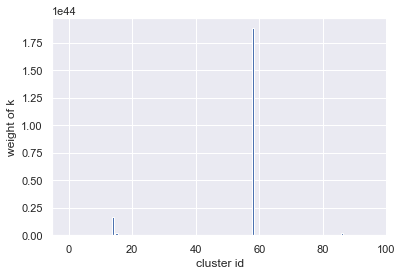

 68%|█████████████████████████████▏             | 34/50 [03:12<01:31,  5.69s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 44  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 43
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

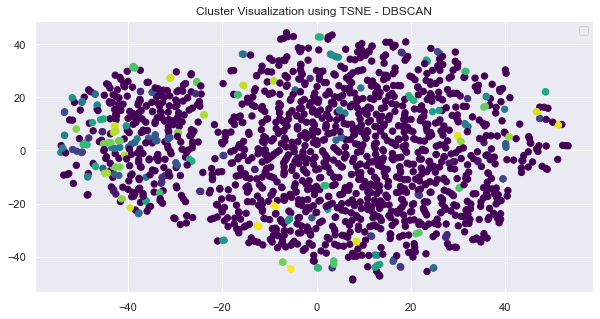

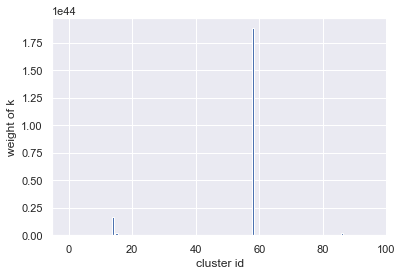

 70%|██████████████████████████████             | 35/50 [03:17<01:23,  5.55s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 45  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 44
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

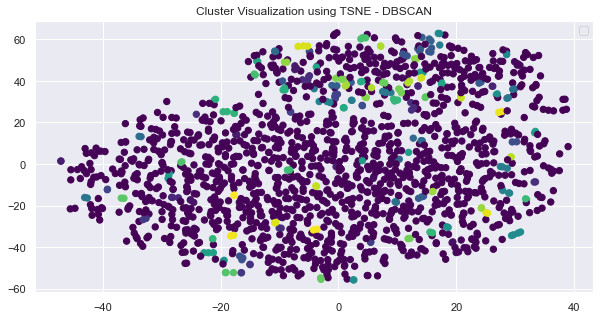

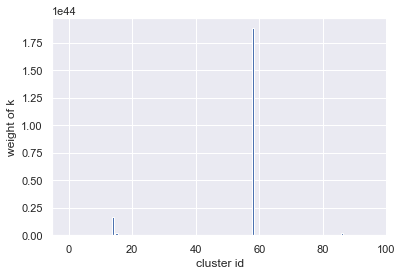

 72%|██████████████████████████████▉            | 36/50 [03:22<01:16,  5.49s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  9  6  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 46  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 45
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

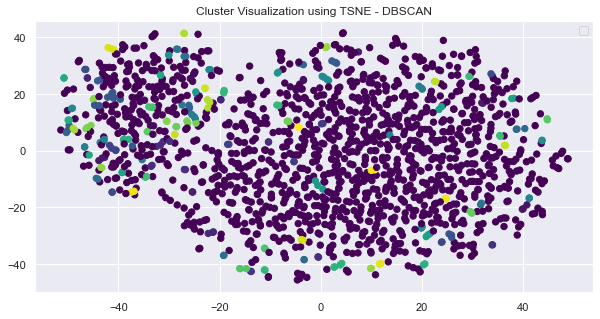

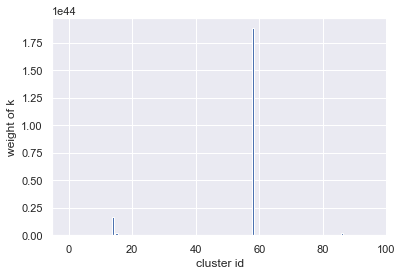

 74%|███████████████████████████████▊           | 37/50 [03:28<01:12,  5.61s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  9  6  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 47  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  6  5  5  5  5  5  5  5  5  5] 46
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

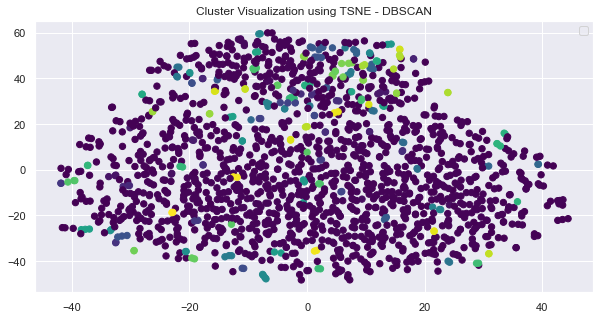

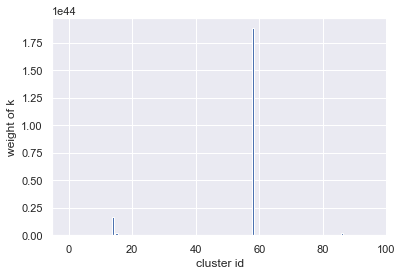

 76%|████████████████████████████████▋          | 38/50 [03:34<01:08,  5.67s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  9  6  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 48  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  6  5  5  5  5  5  5  5  5  5] 47
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

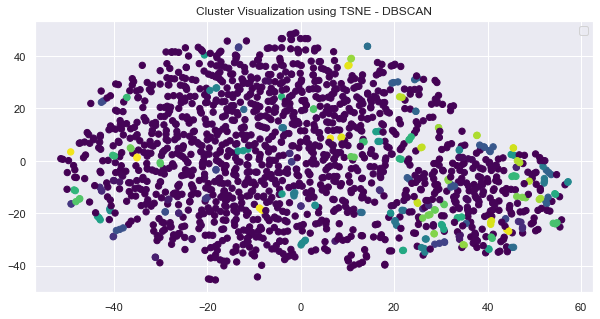

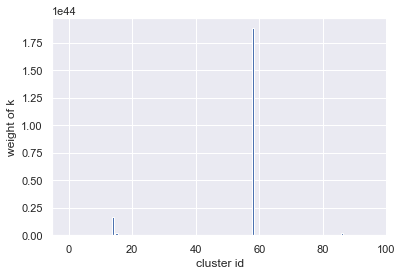

 78%|█████████████████████████████████▌         | 39/50 [03:39<01:01,  5.56s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  9  6  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 49  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  6  5  5  5  5  5  5  5  5  5] 48
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

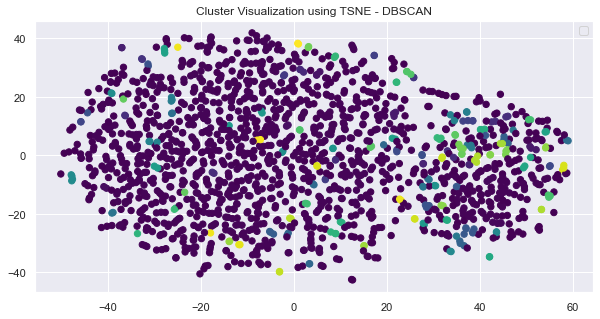

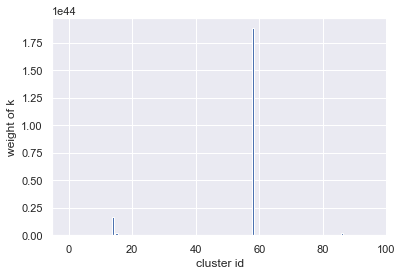

 80%|██████████████████████████████████▍        | 40/50 [03:45<00:56,  5.67s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  9  6  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5 50  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  6  5  5  5  5  5  5  5  5  5] 49
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

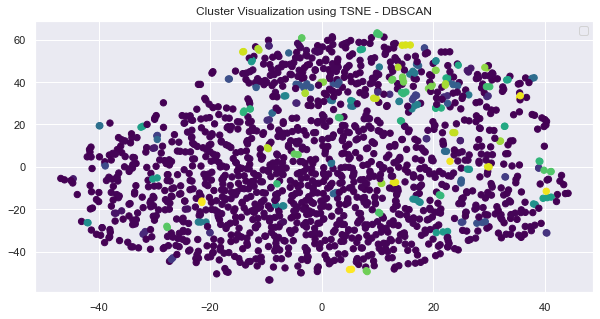

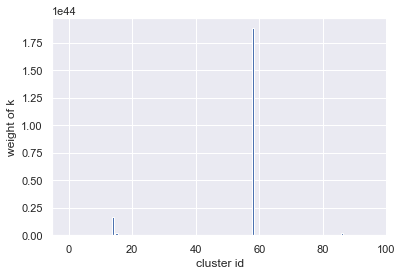

 82%|███████████████████████████████████▎       | 41/50 [03:51<00:50,  5.58s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 51  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 50
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

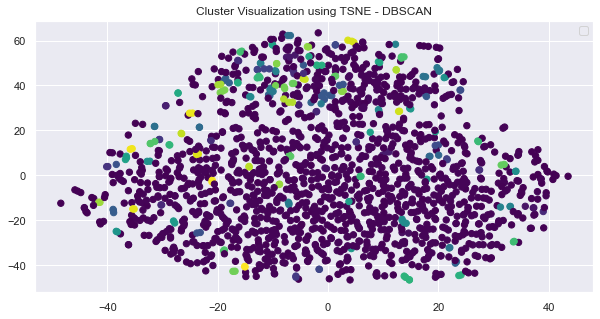

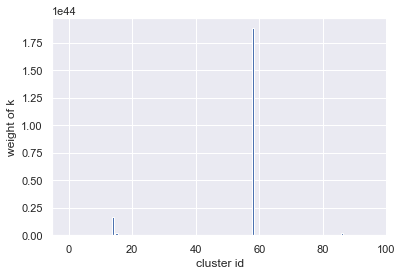

 84%|████████████████████████████████████       | 42/50 [03:56<00:44,  5.51s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 52  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 51
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

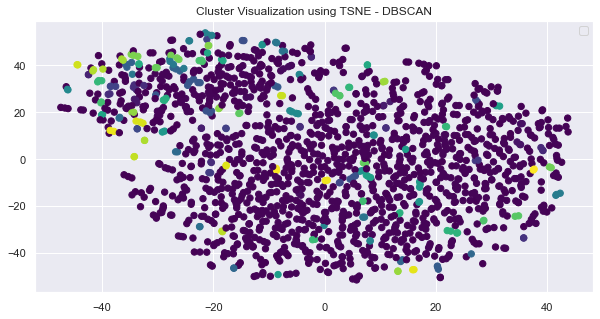

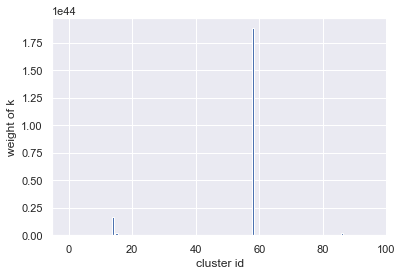

 86%|████████████████████████████████████▉      | 43/50 [04:01<00:38,  5.51s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 53  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 52
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

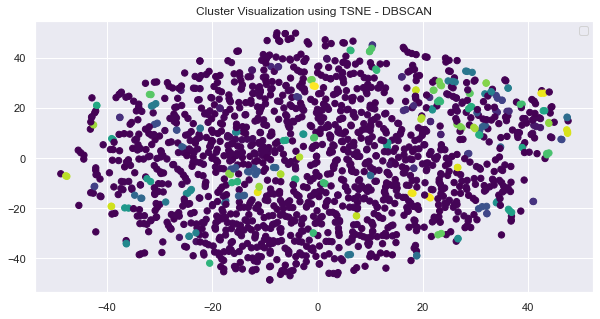

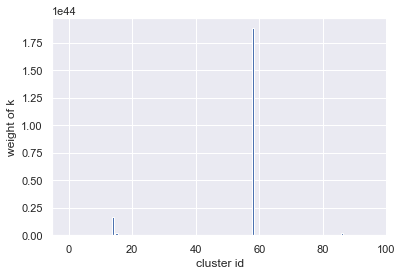

 88%|█████████████████████████████████████▊     | 44/50 [04:07<00:33,  5.56s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 54  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 53
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

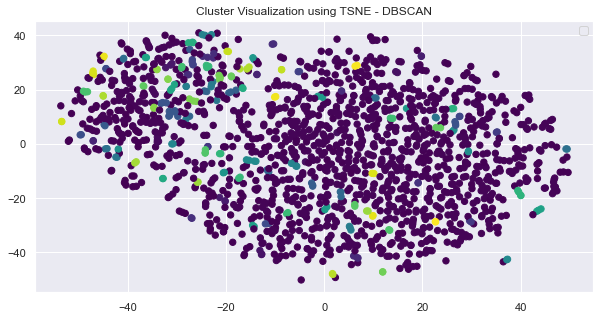

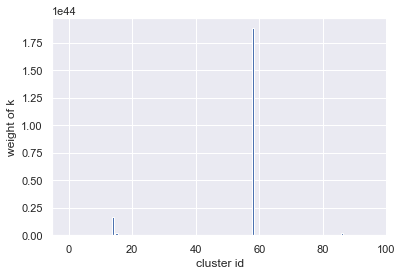

 90%|██████████████████████████████████████▋    | 45/50 [04:12<00:27,  5.41s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  7  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 55  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 54
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

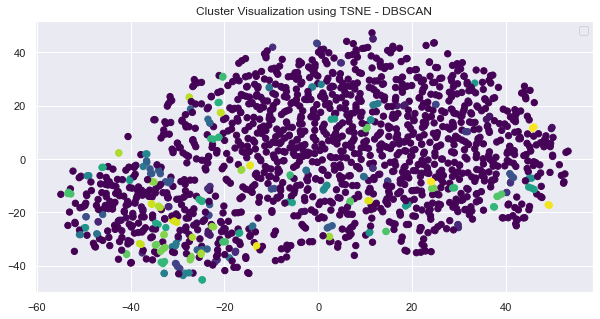

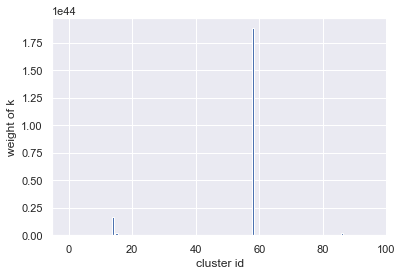

 92%|███████████████████████████████████████▌   | 46/50 [04:18<00:22,  5.52s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  7  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 56  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  7  6  6  6  6  6  6  6  6  6] 55
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

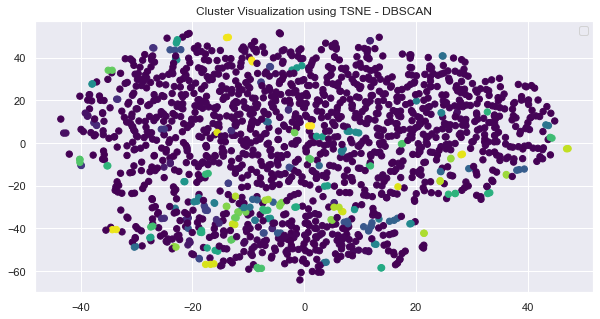

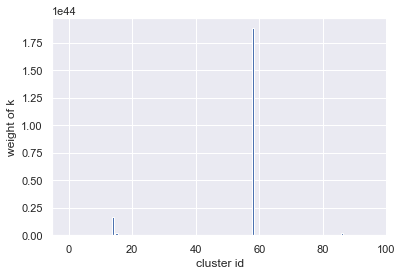

 94%|████████████████████████████████████████▍  | 47/50 [04:23<00:16,  5.40s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 11  7  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 57  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  7  6  6  6  6  6  6  6  6  6] 56
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

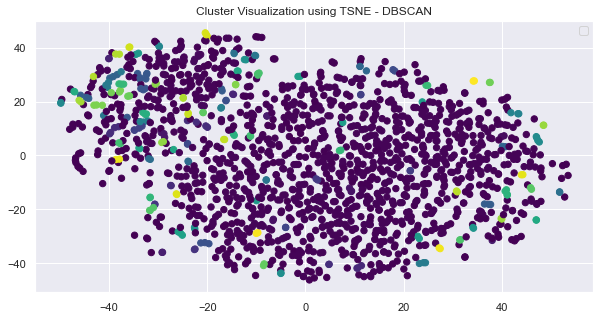

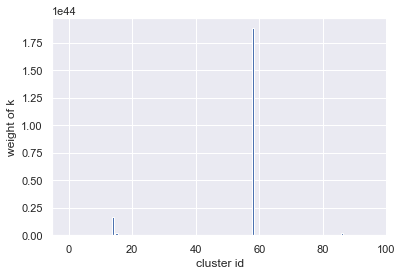

 96%|█████████████████████████████████████████▎ | 48/50 [04:28<00:10,  5.30s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 11  7  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 58  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  7  6  6  6  6  6  6  6  6  6] 57
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

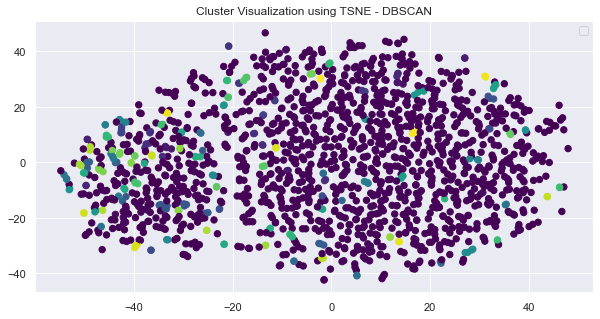

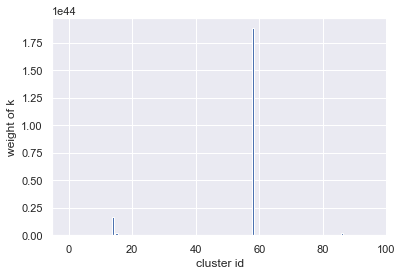

 98%|██████████████████████████████████████████▏| 49/50 [04:33<00:05,  5.25s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 11  7  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 59  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  7  6  6  6  6  6  6  6  6  6] 58
noisy data count: 469


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

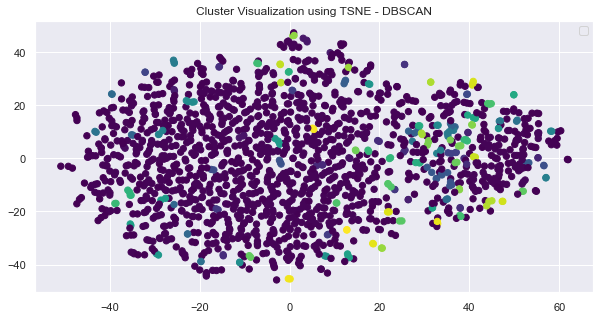

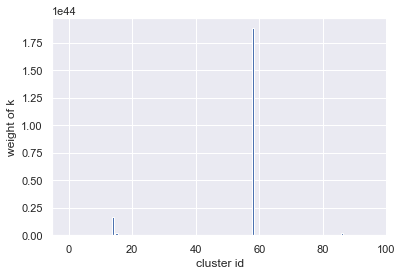

100%|███████████████████████████████████████████| 50/50 [04:39<00:00,  5.59s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6 11  7  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6 60  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  7  6  6  6  6  6  6  6  6  6] 59


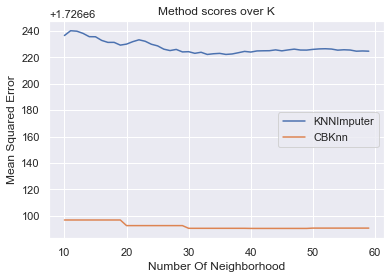

defaultdict(list,
            {'KNNImputer': [1726236.4052686016,
              1726240.0129298135,
              1726239.6767872726,
              1726238.0129889704,
              1726235.5272205262,
              1726235.461032087,
              1726232.70014185,
              1726231.2036555263,
              1726231.222616698,
              1726229.1401447896,
              1726229.901065534,
              1726231.7418690294,
              1726233.1559162622,
              1726232.0619676814,
              1726229.8046269263,
              1726228.5647658925,
              1726226.0838590392,
              1726225.0192866211,
              1726225.8813325919,
              1726223.995166509,
              1726224.168507753,
              1726222.9375838137,
              1726223.7338142158,
              1726222.0881566214,
              1726222.6156605007,
              1726222.896169244,
              1726222.1009165554,
              1726222.4497721465,
              1726223.38

In [69]:
density_based_knn(X, y_true, min_samples=2)

### Let's try with more nan values

In [70]:
df, y_true = load_mobile_price_dataset(nan_percentage=0.4)
X = df.values
df.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,NaN,-0.990050,0.830779,-1.019184,-0.762495,-1.043966,-1.380644,0.340740,1.349249,-1.101971,...,-1.408949,-1.146784,0.391703,-0.784983,0.283103,1.462493,-1.786861,-1.006018,0.986097,-0.447214
1,-0.512096,1.010051,-1.253064,0.981177,-0.992890,0.957886,1.155024,0.687548,-0.120059,-0.664768,...,0.585778,1.704465,0.467317,1.114266,-0.635317,-0.734267,0.559641,0.994018,-1.014099,0.447214
2,-1.550733,1.010051,-1.253064,0.981177,-0.532099,0.957886,0.493546,1.381165,0.134244,0.209639,...,1.392684,1.074968,0.441498,-0.310171,-0.864922,-0.368140,0.559641,0.994018,-1.014099,0.447214
3,NaN,1.010051,1.198517,-1.019184,-0.992890,-1.043966,-1.215274,1.034357,-0.261339,0.646842,...,1.286750,1.236971,0.594569,0.876859,0.512708,-0.002014,0.559641,-1.006018,-1.014099,0.447214
4,1.302116,1.010051,-0.395011,-1.019184,2.002254,0.957886,0.658915,0.340740,0.021220,-1.101971,...,1.268718,-0.091452,-0.657666,-1.022389,-0.864922,0.730240,0.559641,0.994018,-1.014099,-0.447214


100%|███████████████████████████████████████████| 37/37 [00:10<00:00,  3.63it/s]


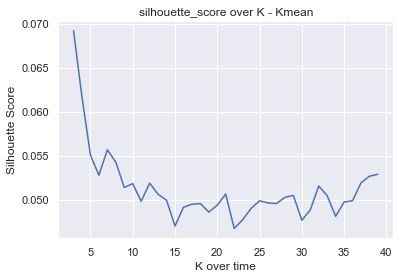

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

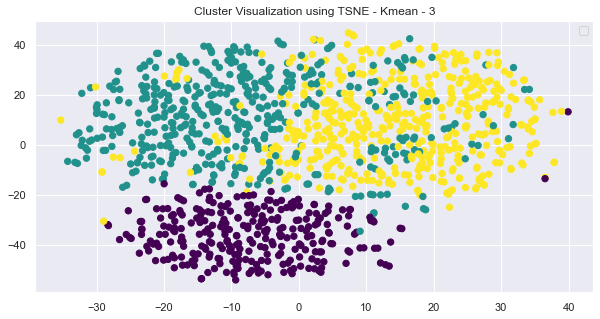

Kmean - 3, score: 0.06918475555229542


100%|███████████████████████████████████████████| 37/37 [00:33<00:00,  1.09it/s]


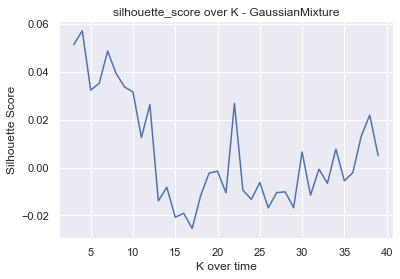

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

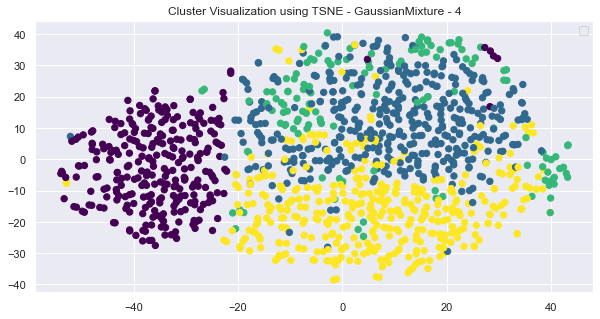

GaussianMixture - 4, score: 0.05722763095041574


100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 25.48it/s]


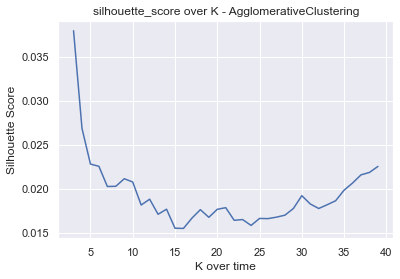

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

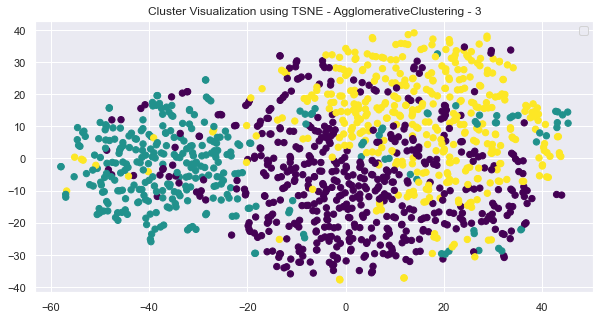

AgglomerativeClustering - 3, score: 0.038002626870228706


100%|███████████████████████████████████████████| 37/37 [00:03<00:00, 11.26it/s]


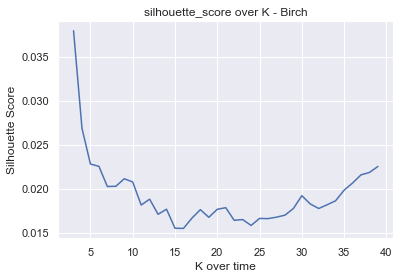

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

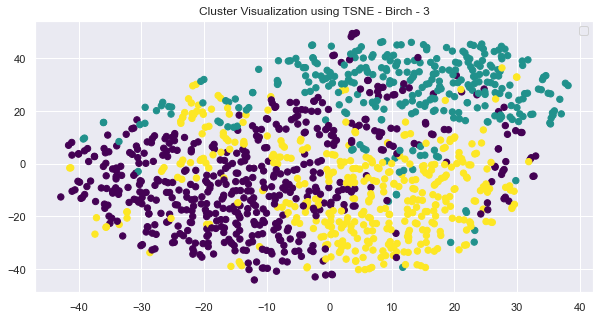

Birch - 3, score: 0.038002626870228706


100%|█████████████████████████████████████████████| 3/3 [00:00<00:00, 88.78it/s]


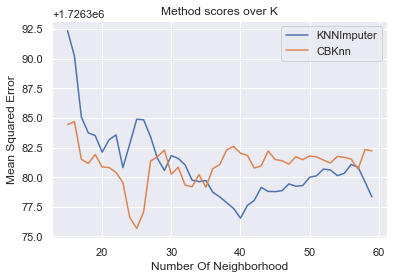

In [72]:
eval_methods_over_k(X, y_true)

noisy data count with eps=0.1: 1214
noisy data count with eps=0.10990990990990991: 1214
noisy data count with eps=0.11981981981981983: 1214
noisy data count with eps=0.12972972972972974: 1214
noisy data count with eps=0.13963963963963966: 1214
noisy data count with eps=0.14954954954954958: 1214
noisy data count with eps=0.15945945945945947: 1214
noisy data count with eps=0.1693693693693694: 1214
noisy data count with eps=0.17927927927927928: 1214
noisy data count with eps=0.1891891891891892: 1214
noisy data count with eps=0.19909909909909912: 1214
noisy data count with eps=0.20900900900900904: 1214
noisy data count with eps=0.21891891891891893: 1214
noisy data count with eps=0.22882882882882885: 1214
noisy data count with eps=0.23873873873873877: 1214
noisy data count with eps=0.24864864864864866: 1214
noisy data count with eps=0.2585585585585586: 1214
noisy data count with eps=0.2684684684684685: 1214
noisy data count with eps=0.2783783783783784: 1214
noisy data count with eps=0.28828

noisy data count with eps=1.9729729729729732: 1210
noisy data count with eps=1.9828828828828833: 1210
noisy data count with eps=1.992792792792793: 1210
noisy data count with eps=2.002702702702703: 1210
noisy data count with eps=2.012612612612613: 1210
noisy data count with eps=2.0225225225225225: 1210
noisy data count with eps=2.0324324324324325: 1210
noisy data count with eps=2.0423423423423426: 1210
noisy data count with eps=2.0522522522522526: 1208
noisy data count with eps=2.062162162162162: 1208
noisy data count with eps=2.0720720720720722: 1208
noisy data count with eps=2.0819819819819823: 1208
noisy data count with eps=2.0918918918918923: 1208
noisy data count with eps=2.1018018018018023: 1208
noisy data count with eps=2.111711711711712: 1208
noisy data count with eps=2.121621621621622: 1208
noisy data count with eps=2.131531531531532: 1208
noisy data count with eps=2.1414414414414416: 1208
noisy data count with eps=2.1513513513513516: 1208
noisy data count with eps=2.1612612612

noisy data count with eps=3.6378378378378384: 362
noisy data count with eps=3.6477477477477485: 356
noisy data count with eps=3.657657657657658: 346
noisy data count with eps=3.667567567567568: 340
noisy data count with eps=3.677477477477478: 330
noisy data count with eps=3.6873873873873877: 315
noisy data count with eps=3.6972972972972977: 311
noisy data count with eps=3.7072072072072078: 303
noisy data count with eps=3.717117117117118: 295
noisy data count with eps=3.7270270270270274: 287
noisy data count with eps=3.7369369369369374: 279
noisy data count with eps=3.7468468468468474: 270
noisy data count with eps=3.7567567567567575: 256
noisy data count with eps=3.766666666666667: 248
noisy data count with eps=3.776576576576577: 241
noisy data count with eps=3.786486486486487: 234
noisy data count with eps=3.7963963963963967: 227
noisy data count with eps=3.8063063063063067: 220
noisy data count with eps=3.8162162162162168: 213
noisy data count with eps=3.826126126126127: 205
noisy da

noisy data count with eps=5.391891891891892: 0
noisy data count with eps=5.401801801801802: 0
noisy data count with eps=5.411711711711712: 0
noisy data count with eps=5.421621621621622: 0
noisy data count with eps=5.431531531531531: 0
noisy data count with eps=5.441441441441442: 0
noisy data count with eps=5.451351351351351: 0
noisy data count with eps=5.461261261261262: 0
noisy data count with eps=5.4711711711711715: 0
noisy data count with eps=5.481081081081081: 0
noisy data count with eps=5.4909909909909915: 0
noisy data count with eps=5.500900900900901: 0
noisy data count with eps=5.510810810810811: 0
noisy data count with eps=5.520720720720721: 0
noisy data count with eps=5.530630630630631: 0
noisy data count with eps=5.540540540540541: 0
noisy data count with eps=5.550450450450451: 0
noisy data count with eps=5.56036036036036: 0
noisy data count with eps=5.570270270270271: 0
noisy data count with eps=5.5801801801801805: 0
noisy data count with eps=5.59009009009009: 0
noisy data c

noisy data count with eps=7.225225225225226: 0
noisy data count with eps=7.235135135135136: 0
noisy data count with eps=7.245045045045045: 0
noisy data count with eps=7.254954954954956: 0
noisy data count with eps=7.264864864864865: 0
noisy data count with eps=7.274774774774775: 0
noisy data count with eps=7.284684684684685: 0
noisy data count with eps=7.294594594594595: 0
noisy data count with eps=7.304504504504505: 0
noisy data count with eps=7.314414414414415: 0
noisy data count with eps=7.324324324324325: 0
noisy data count with eps=7.334234234234235: 0
noisy data count with eps=7.344144144144145: 0
noisy data count with eps=7.354054054054054: 0
noisy data count with eps=7.363963963963965: 0
noisy data count with eps=7.373873873873874: 0
noisy data count with eps=7.383783783783784: 0
noisy data count with eps=7.393693693693694: 0
noisy data count with eps=7.403603603603604: 0
noisy data count with eps=7.413513513513514: 0
noisy data count with eps=7.423423423423424: 0
noisy data co

noisy data count with eps=9.08828828828829: 0
noisy data count with eps=9.0981981981982: 0
noisy data count with eps=9.108108108108109: 0
noisy data count with eps=9.118018018018018: 0
noisy data count with eps=9.127927927927928: 0
noisy data count with eps=9.13783783783784: 0
noisy data count with eps=9.147747747747749: 0
noisy data count with eps=9.157657657657658: 0
noisy data count with eps=9.167567567567568: 0
noisy data count with eps=9.177477477477478: 0
noisy data count with eps=9.187387387387387: 0
noisy data count with eps=9.197297297297299: 0
noisy data count with eps=9.207207207207208: 0
noisy data count with eps=9.217117117117118: 0
noisy data count with eps=9.227027027027027: 0
noisy data count with eps=9.236936936936937: 0
noisy data count with eps=9.246846846846848: 0
noisy data count with eps=9.256756756756758: 0
noisy data count with eps=9.266666666666667: 0
noisy data count with eps=9.276576576576577: 0
noisy data count with eps=9.286486486486487: 0
noisy data count 

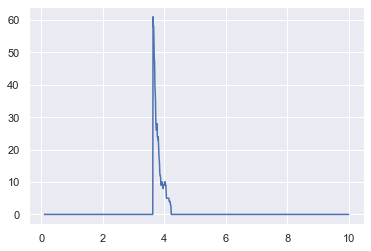

  0%|                                                    | 0/50 [00:00<?, ?it/s]

noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


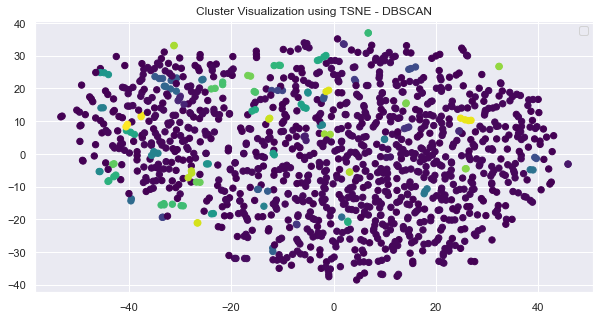

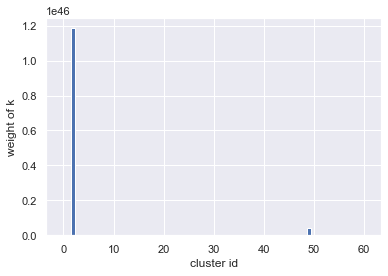

  2%|▉                                           | 1/50 [00:04<04:01,  4.93s/it]

[ 2  2 11  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 10
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

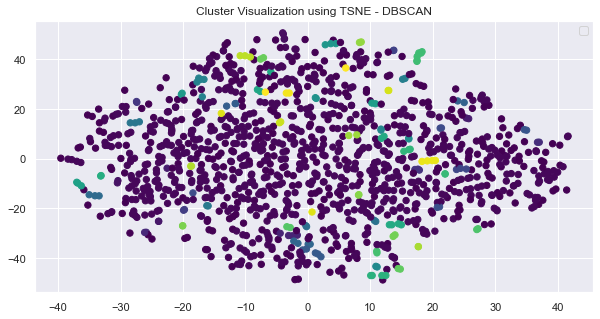

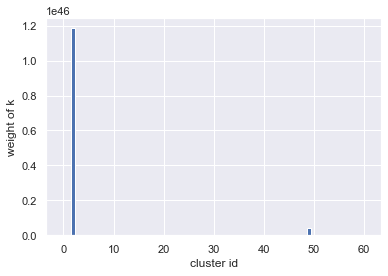

  4%|█▊                                          | 2/50 [00:09<03:48,  4.76s/it]

[ 2  2 12  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 11
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

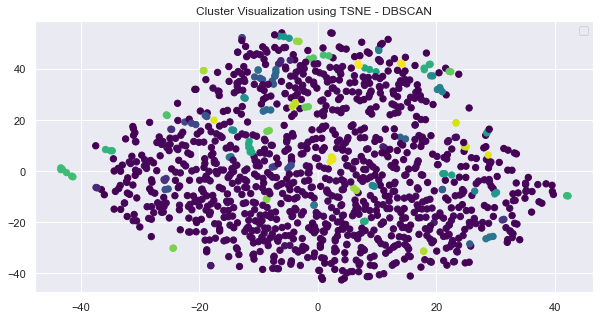

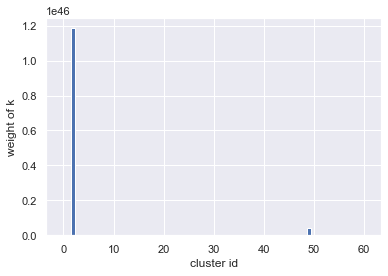

  6%|██▋                                         | 3/50 [00:14<03:39,  4.68s/it]

[ 2  2 13  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 12
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

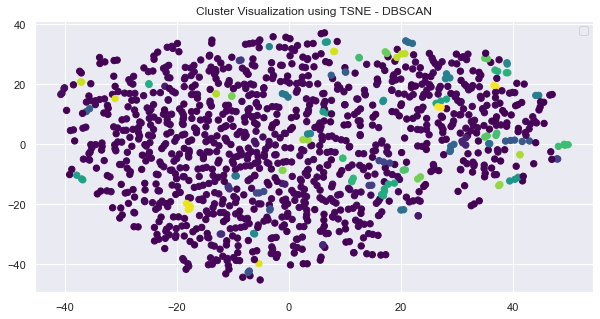

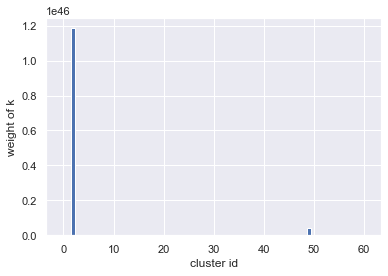

  8%|███▌                                        | 4/50 [00:18<03:27,  4.50s/it]

[ 2  2 14  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 13
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

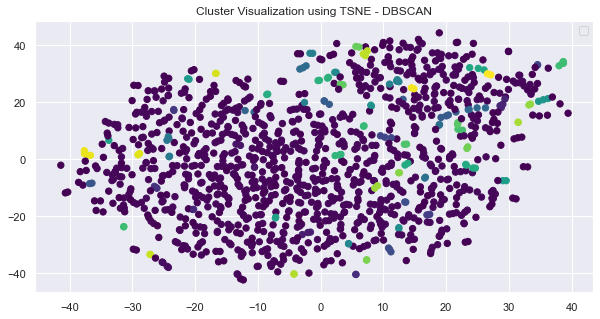

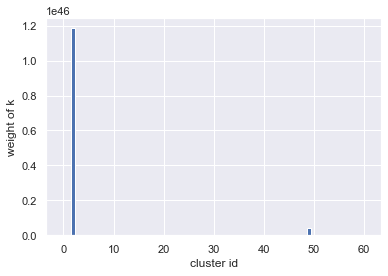

 10%|████▍                                       | 5/50 [00:22<03:22,  4.49s/it]

[ 2  2 15  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 14
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

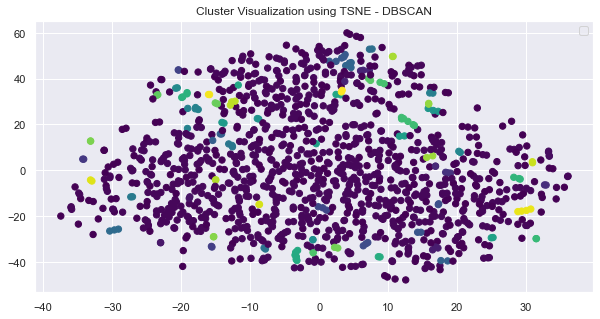

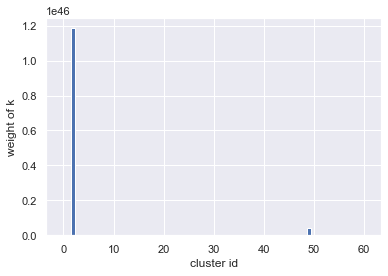

 12%|█████▎                                      | 6/50 [00:27<03:20,  4.55s/it]

[ 2  2 16  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 15
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

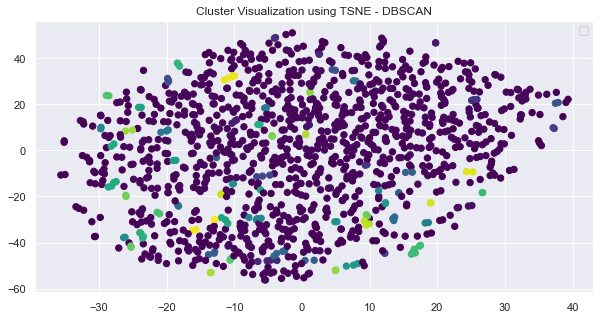

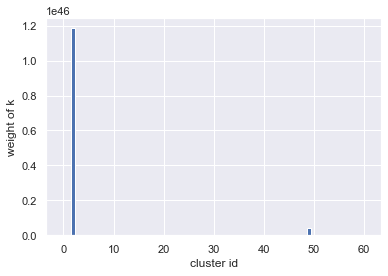

 14%|██████▏                                     | 7/50 [00:31<03:11,  4.45s/it]

[ 2  2 17  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  3  2  2  2  2  2  2  2  2  2  2  2] 16
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

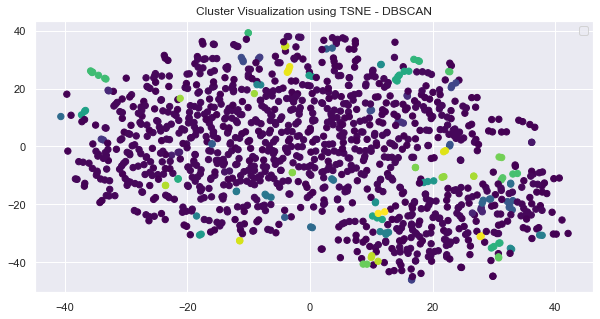

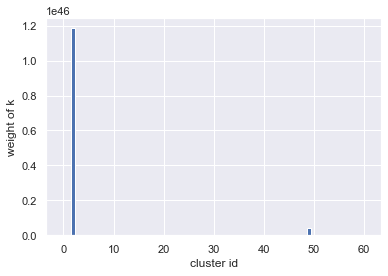

 16%|███████                                     | 8/50 [00:35<03:03,  4.36s/it]

[ 2  2 18  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  3  2  2  2  2  2  2  2  2  2  2  2] 17
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

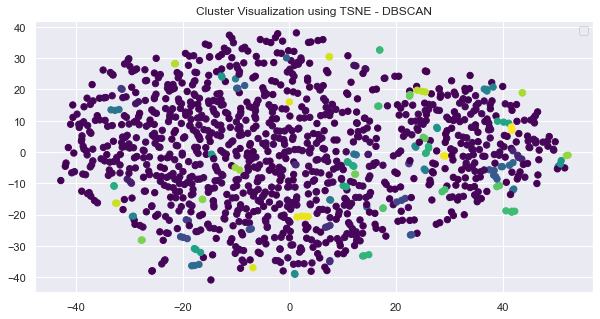

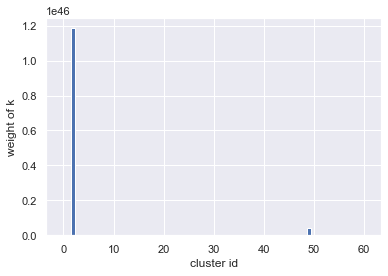

 18%|███████▉                                    | 9/50 [00:40<02:58,  4.34s/it]

[ 2  2 19  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  3  2  2  2  2  2  2  2  2  2  2  2] 18
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

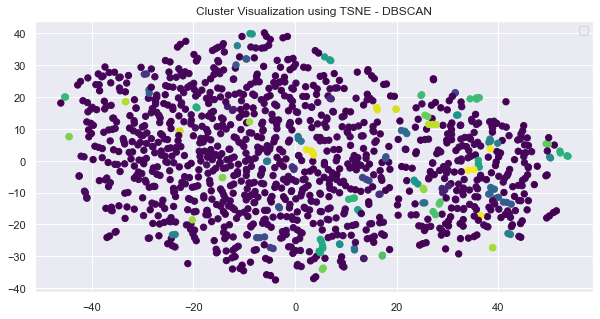

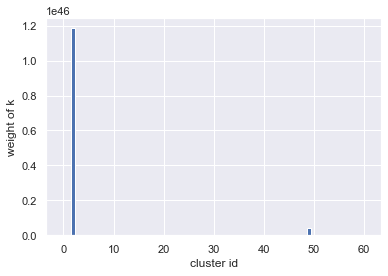

 20%|████████▌                                  | 10/50 [00:44<02:53,  4.33s/it]

[ 2  2 20  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  3  2  2  2  2  2  2  2  2  2  2  2] 19
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

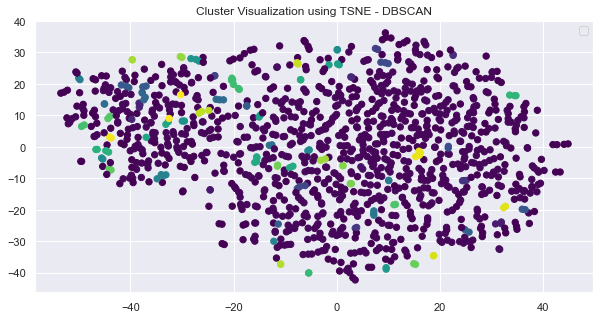

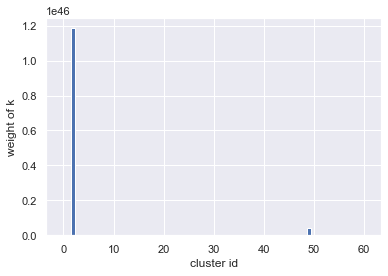

 22%|█████████▍                                 | 11/50 [00:49<02:50,  4.38s/it]

[ 3  3 21  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 20
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

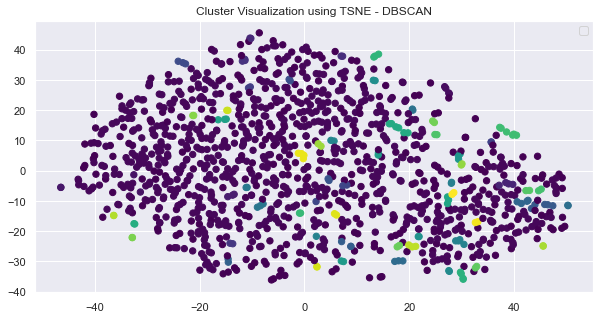

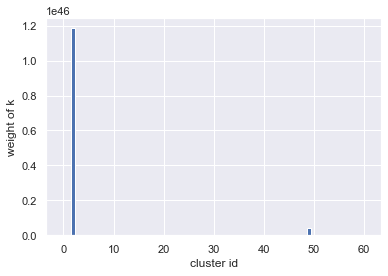

 24%|██████████▎                                | 12/50 [00:53<02:46,  4.37s/it]

[ 3  3 22  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 21
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

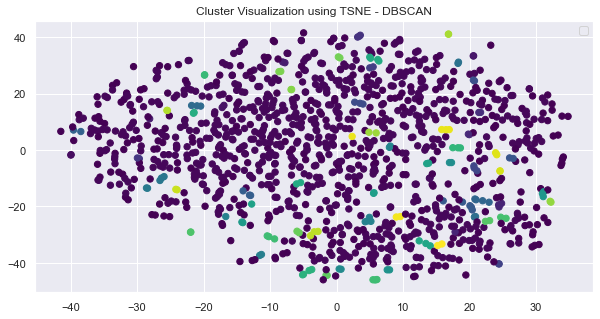

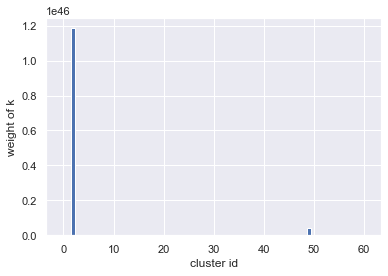

 26%|███████████▏                               | 13/50 [00:57<02:43,  4.41s/it]

[ 3  3 23  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 22
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

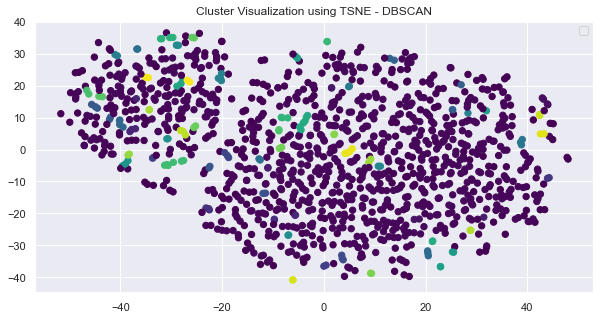

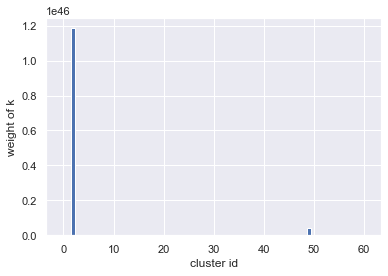

 28%|████████████                               | 14/50 [01:02<02:40,  4.46s/it]

[ 3  3 24  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  4  3  3  3  3  3  3  3  3  3  3  3] 23
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

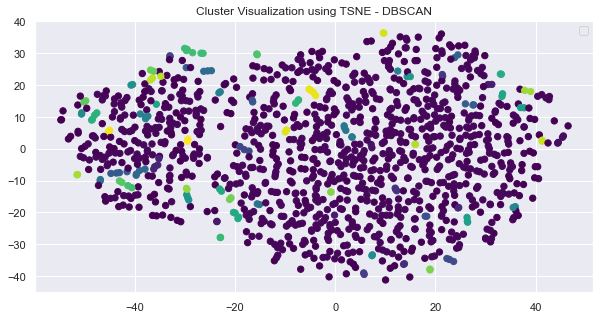

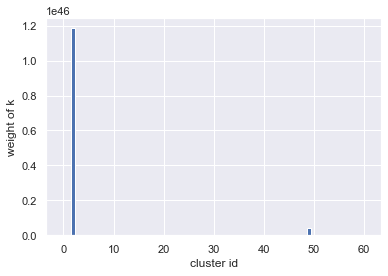

 30%|████████████▉                              | 15/50 [01:07<02:42,  4.63s/it]

[ 3  3 25  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  4  3  3  3  3  3  3  3  3  3  3  3] 24
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

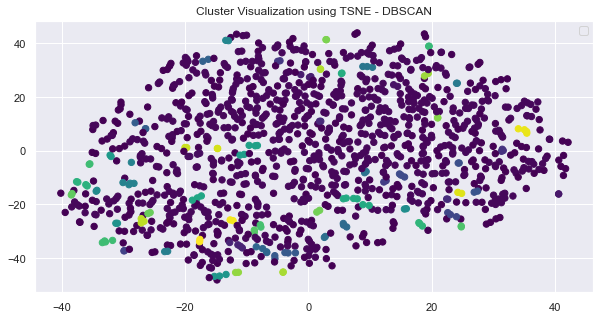

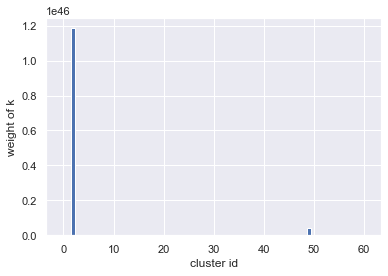

 32%|█████████████▊                             | 16/50 [01:12<02:40,  4.73s/it]

[ 3  3 26  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  4  3  3  3  3  3  3  3  3  3  3  3] 25
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

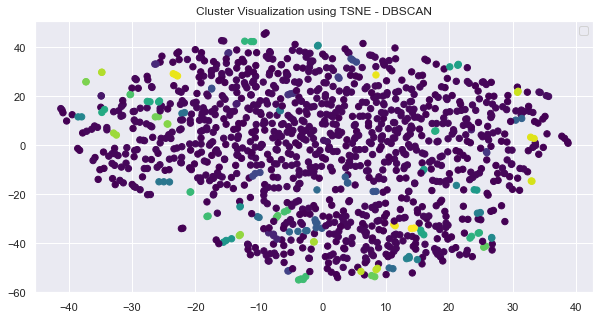

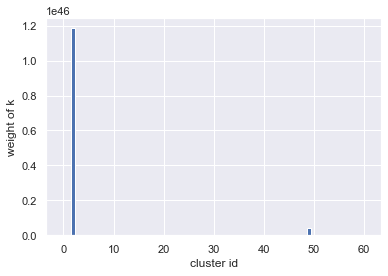

 34%|██████████████▌                            | 17/50 [01:16<02:33,  4.66s/it]

[ 3  3 27  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  4  3  3  3  3  3  3  3  3  3  3  3] 26
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

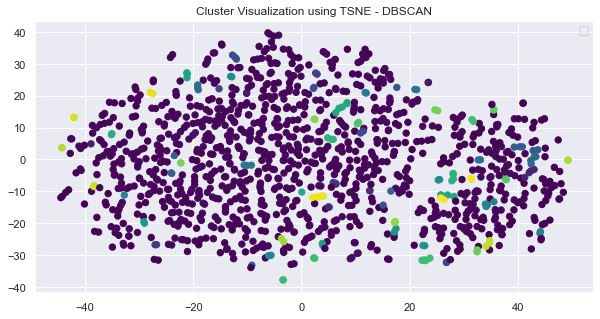

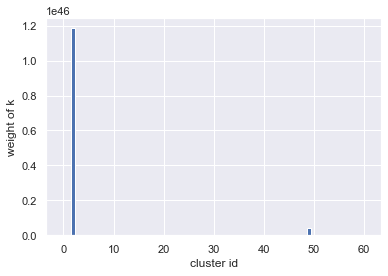

 36%|███████████████▍                           | 18/50 [01:21<02:30,  4.71s/it]

[ 3  3 28  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  4  3  3  3  3  3  3  3  3  3  3  3] 27
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

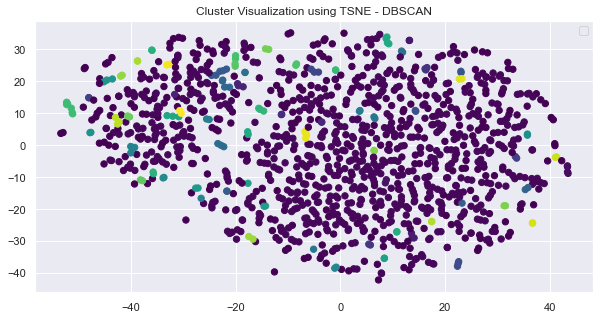

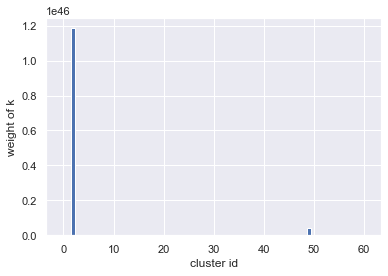

 38%|████████████████▎                          | 19/50 [01:27<02:37,  5.07s/it]

[ 3  3 29  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  4  3  3  3  3  3  3  3  3  3  3  3] 28
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

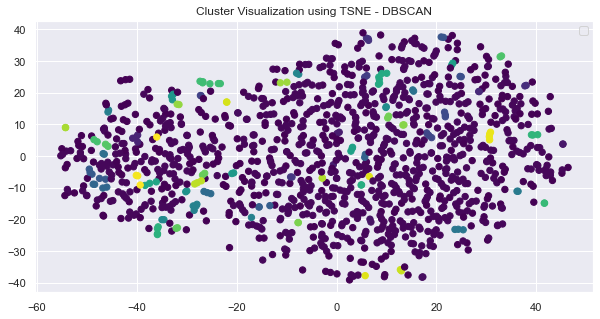

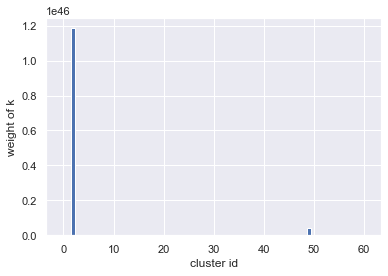

 40%|█████████████████▏                         | 20/50 [01:32<02:27,  4.91s/it]

[ 3  3 30  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  4  3  3  3  3  3  3  3  3  3  3  3] 29
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

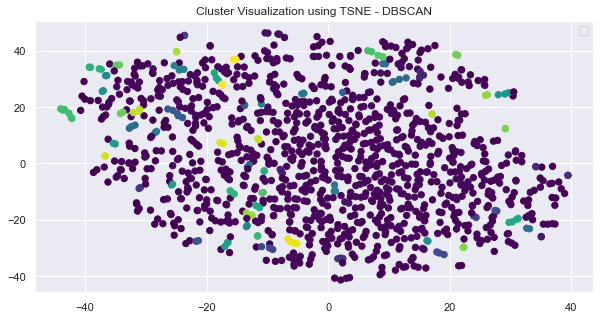

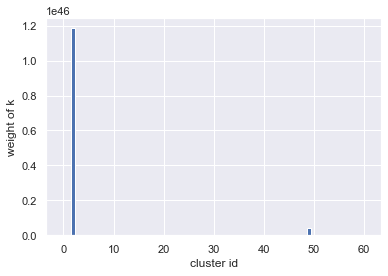

 42%|██████████████████                         | 21/50 [01:37<02:22,  4.93s/it]

[ 4  4 31  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 30
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

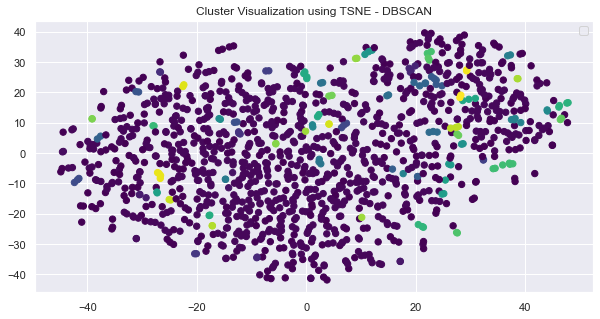

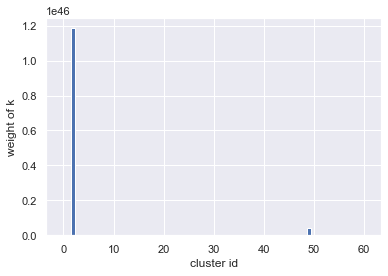

 44%|██████████████████▉                        | 22/50 [01:41<02:16,  4.86s/it]

[ 4  4 32  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  5  4  4  4  4  4  4  4  4  4  4  4] 31
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

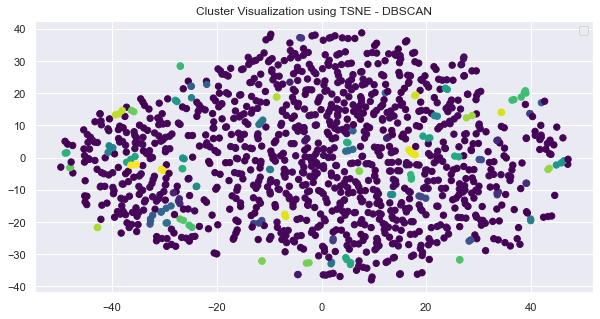

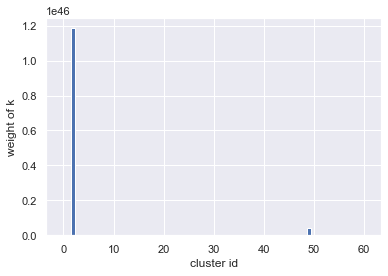

 46%|███████████████████▊                       | 23/50 [01:46<02:06,  4.70s/it]

[ 4  4 33  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  5  4  4  4  4  4  4  4  4  4  4  4] 32
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

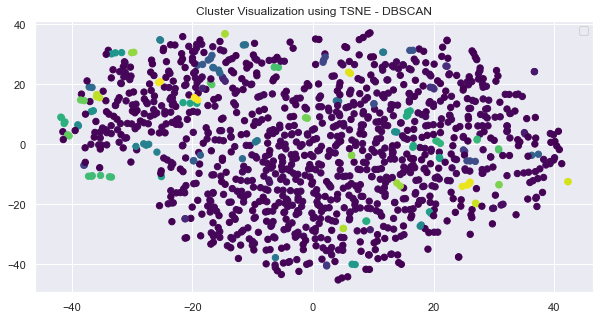

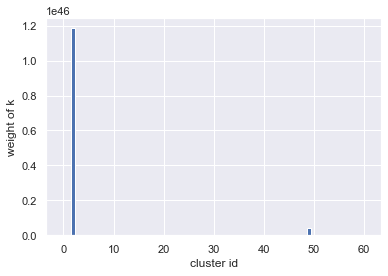

 48%|████████████████████▋                      | 24/50 [01:50<01:59,  4.61s/it]

[ 4  4 34  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  5  4  4  4  4  4  4  4  4  4  4  4] 33
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

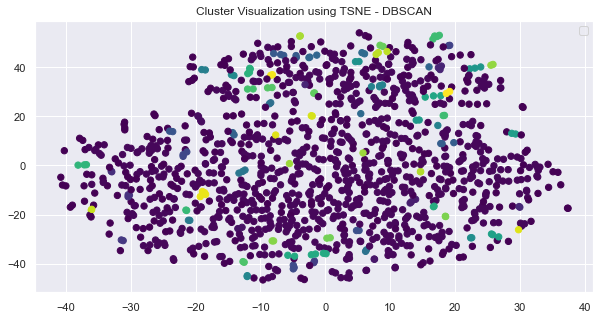

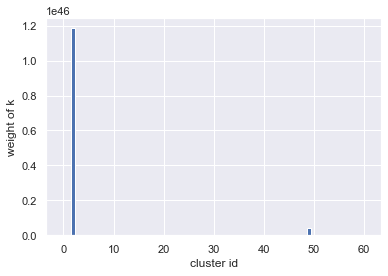

 50%|█████████████████████▌                     | 25/50 [01:54<01:52,  4.52s/it]

[ 4  4 35  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  5  4  4  4  4  4  4  4  4  4  4  4] 34
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

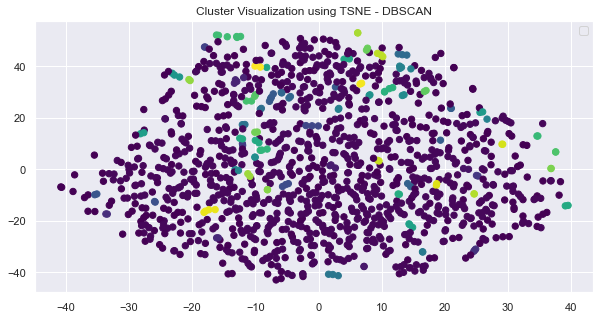

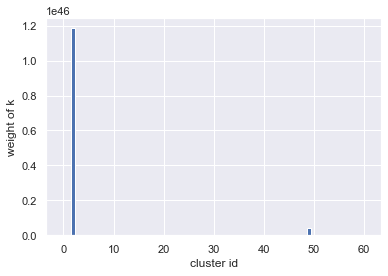

 52%|██████████████████████▎                    | 26/50 [01:59<01:49,  4.55s/it]

[ 4  4 36  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  5  4  4  4  4  4  4  4  4  4  4  4] 35
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

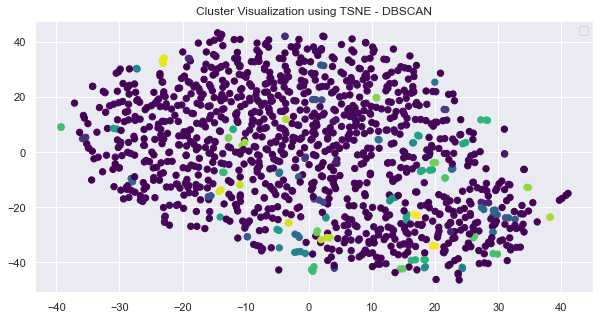

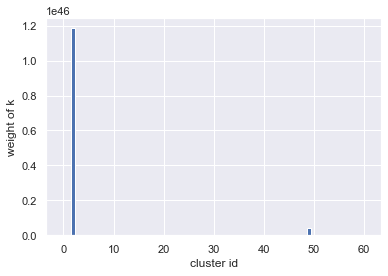

 54%|███████████████████████▏                   | 27/50 [02:03<01:42,  4.45s/it]

[ 4  4 37  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  5  4  4  4  4  4  4  4  4  4  4  4] 36
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

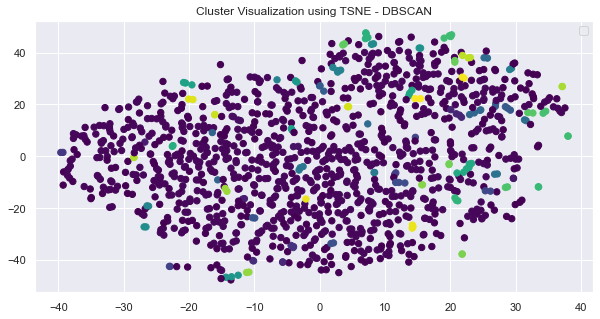

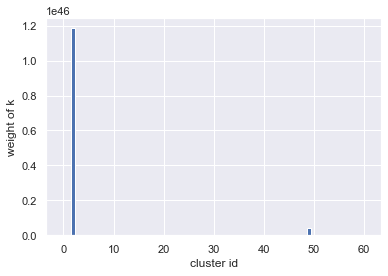

 56%|████████████████████████                   | 28/50 [02:08<01:42,  4.68s/it]

[ 4  4 38  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  5  4  4  4  4  4  4  4  4  4  4  4] 37
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

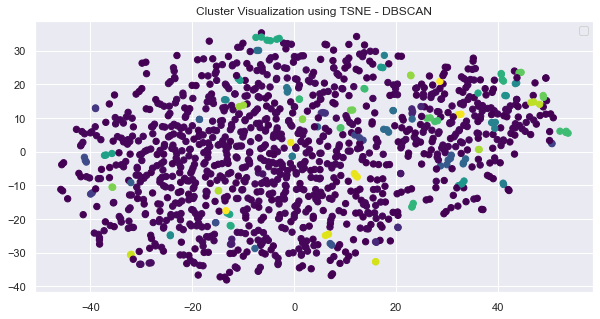

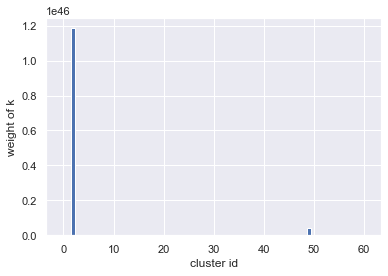

 58%|████████████████████████▉                  | 29/50 [02:15<01:49,  5.23s/it]

[ 4  4 39  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  6  4  4  4  4  4  4  4  4  4  4  4] 38
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

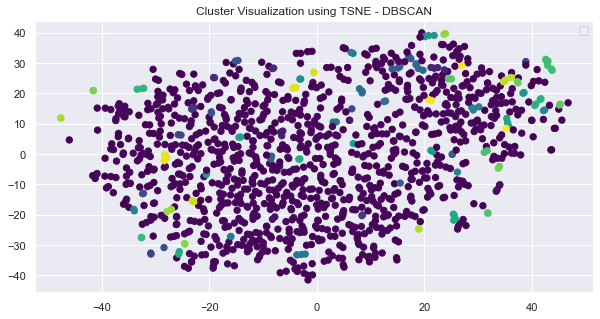

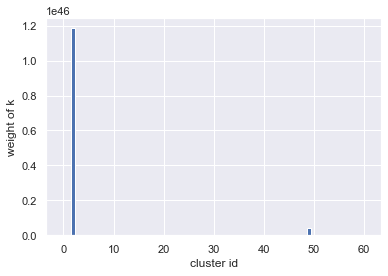

 60%|█████████████████████████▊                 | 30/50 [02:20<01:40,  5.01s/it]

[ 4  4 40  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  6  4  4  4  4  4  4  4  4  4  4  4] 39
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

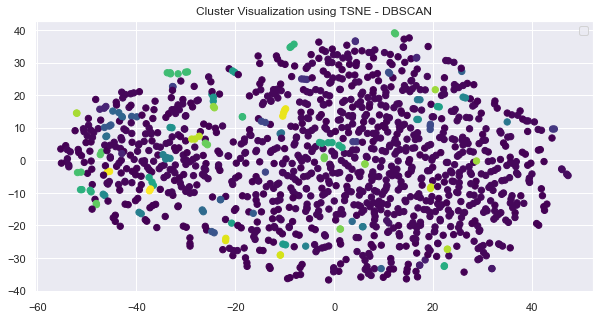

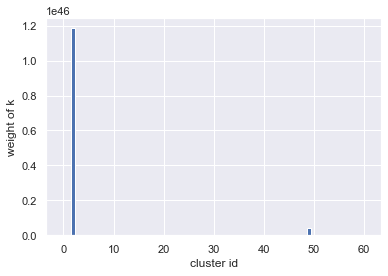

 62%|██████████████████████████▋                | 31/50 [02:24<01:31,  4.82s/it]

[ 5  5 41  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  6  5  5  5  5  5  5  5  5  5  5  5] 40
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

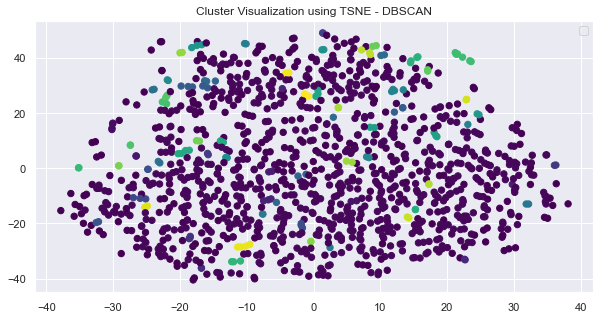

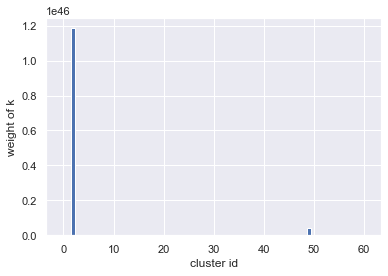

 64%|███████████████████████████▌               | 32/50 [02:28<01:24,  4.67s/it]

[ 5  5 42  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  6  5  5  5  5  5  5  5  5  5  5  5] 41
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

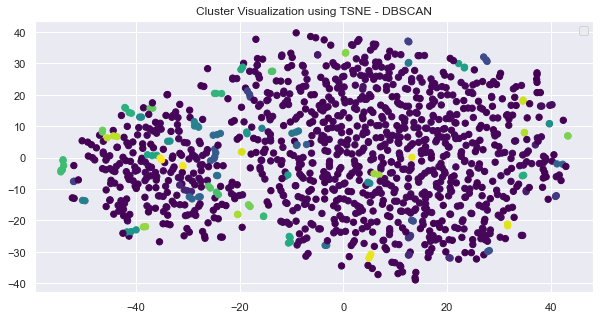

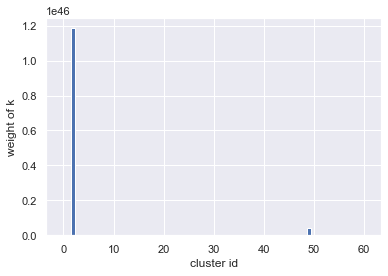

 66%|████████████████████████████▍              | 33/50 [02:33<01:17,  4.56s/it]

[ 5  5 43  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  6  5  5  5  5  5  5  5  5  5  5  5] 42
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

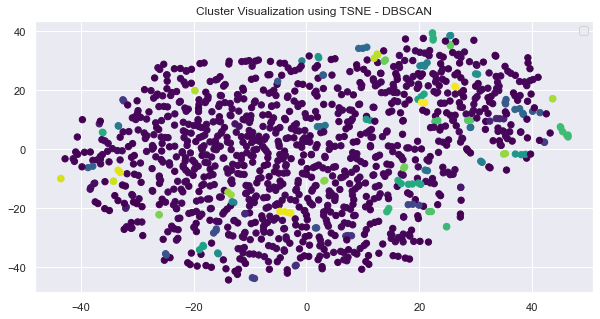

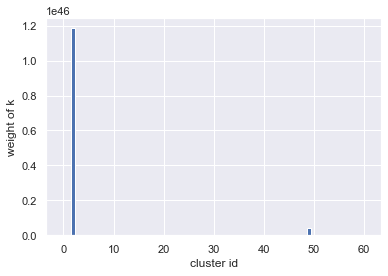

 68%|█████████████████████████████▏             | 34/50 [02:37<01:11,  4.48s/it]

[ 5  5 44  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  6  5  5  5  5  5  5  5  5  5  5  5] 43
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

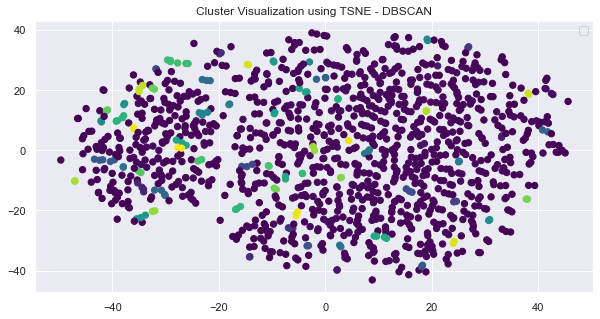

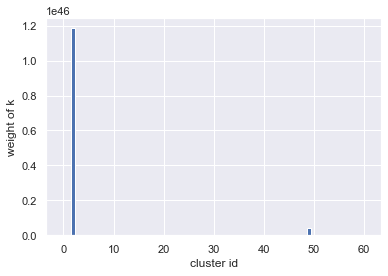

 70%|██████████████████████████████             | 35/50 [02:42<01:10,  4.70s/it]

[ 5  5 45  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  6  5  5  5  5  5  5  5  5  5  5  5] 44
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

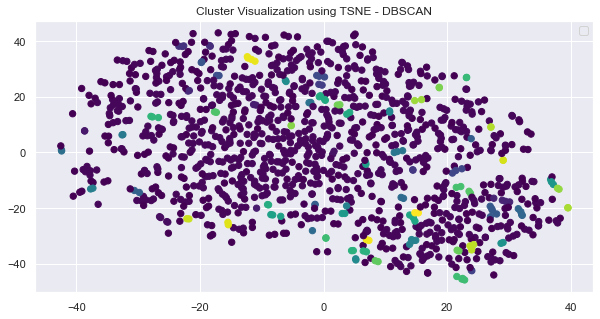

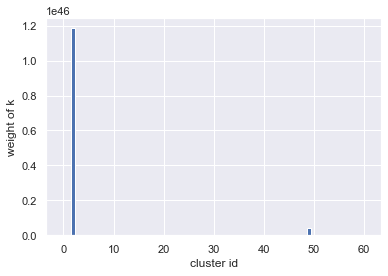

 72%|██████████████████████████████▉            | 36/50 [02:48<01:12,  5.18s/it]

[ 5  5 46  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  6  5  5  5  5  5  5  5  5  5  5  5] 45
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

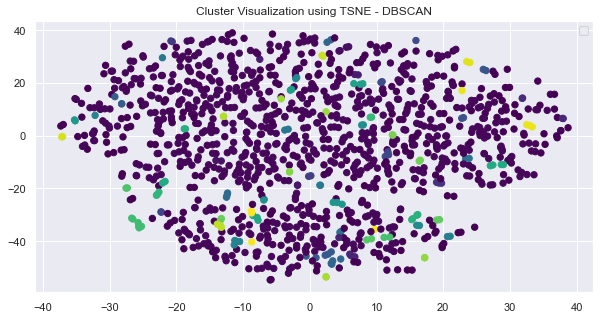

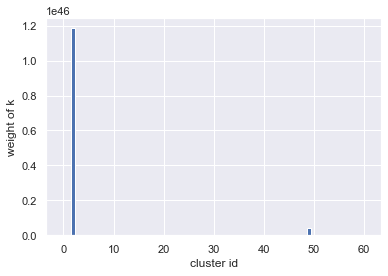

 74%|███████████████████████████████▊           | 37/50 [02:53<01:06,  5.12s/it]

[ 5  5 47  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  7  5  5  5  5  5  5  5  5  5  5  5] 46
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

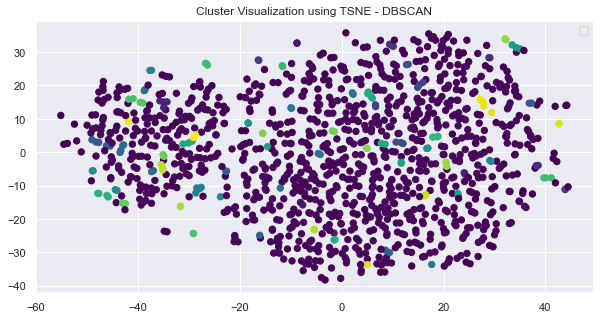

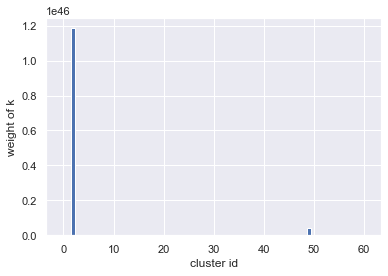

 76%|████████████████████████████████▋          | 38/50 [02:58<00:58,  4.88s/it]

[ 5  5 48  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  7  5  5  5  5  5  5  5  5  5  5  5] 47
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

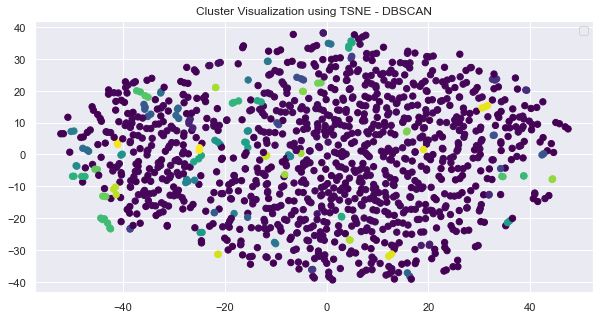

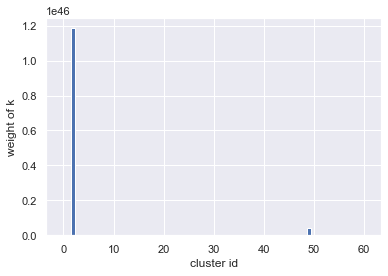

 78%|█████████████████████████████████▌         | 39/50 [03:02<00:53,  4.88s/it]

[ 5  5 49  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  7  5  5  5  5  5  5  5  5  5  5  5] 48
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

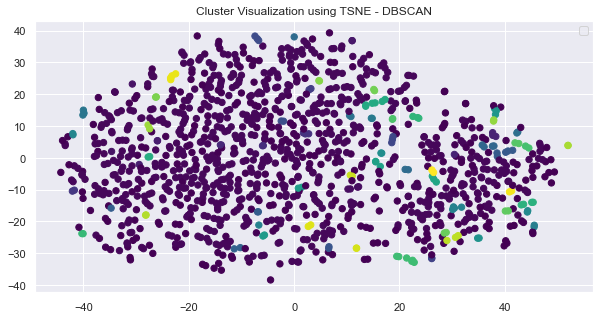

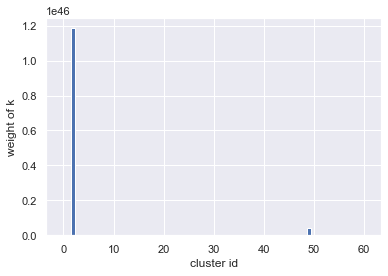

 80%|██████████████████████████████████▍        | 40/50 [03:07<00:47,  4.76s/it]

[ 5  5 50  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  7  5  5  5  5  5  5  5  5  5  5  5] 49
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

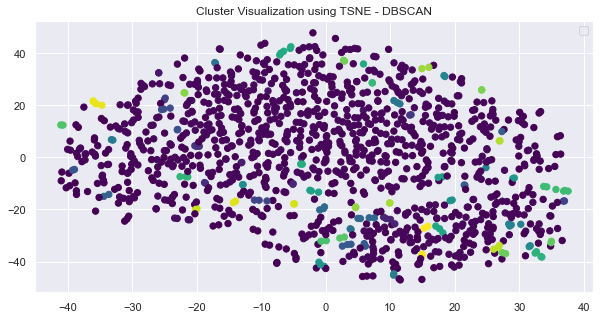

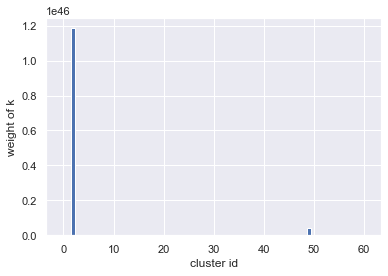

 82%|███████████████████████████████████▎       | 41/50 [03:12<00:42,  4.70s/it]

[ 6  6 51  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  7  6  6  6  6  6  6  6  6  6  6  6] 50
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

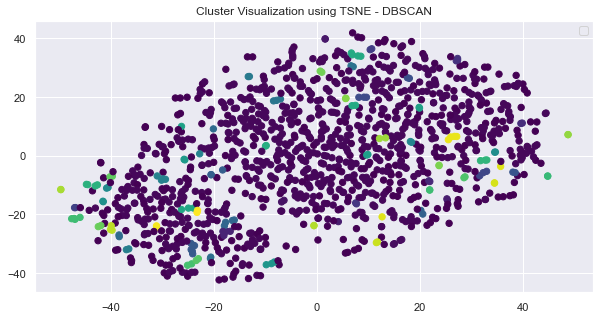

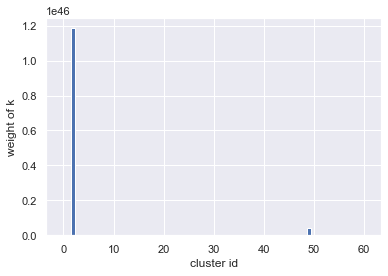

 84%|████████████████████████████████████       | 42/50 [03:17<00:39,  4.88s/it]

[ 6  6 52  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  7  6  6  6  6  6  6  6  6  6  6  6] 51
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

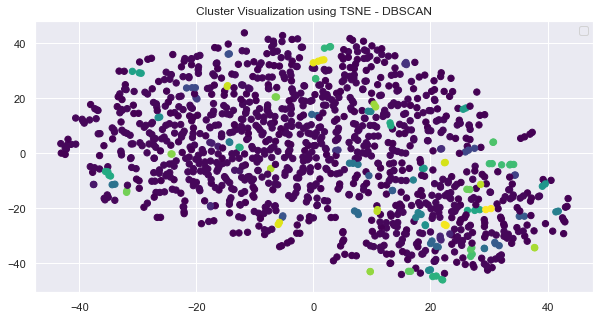

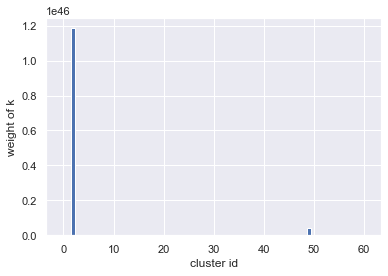

 86%|████████████████████████████████████▉      | 43/50 [03:21<00:33,  4.73s/it]

[ 6  6 53  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  7  6  6  6  6  6  6  6  6  6  6  6] 52
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

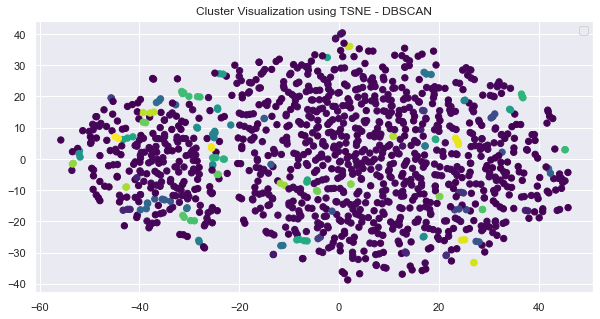

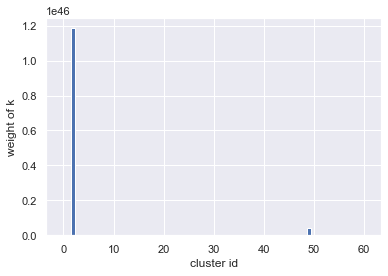

 88%|█████████████████████████████████████▊     | 44/50 [03:27<00:29,  4.95s/it]

[ 6  6 54  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  7  6  6  6  6  6  6  6  6  6  6  6] 53
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

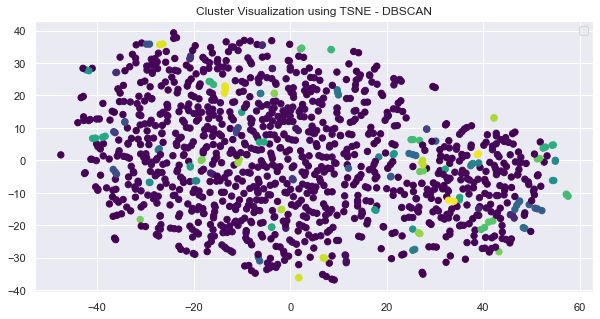

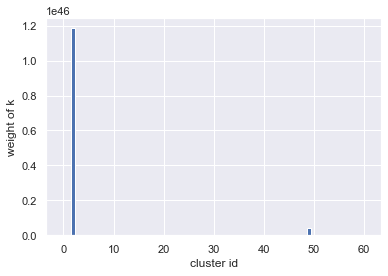

 90%|██████████████████████████████████████▋    | 45/50 [03:31<00:24,  4.87s/it]

[ 6  6 55  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  8  6  6  6  6  6  6  6  6  6  6  6] 54
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

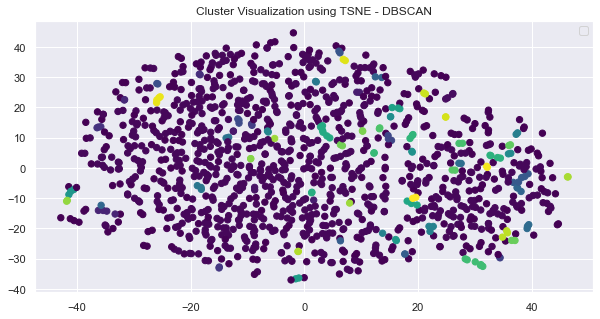

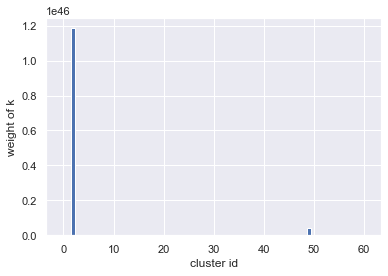

 92%|███████████████████████████████████████▌   | 46/50 [03:36<00:18,  4.74s/it]

[ 6  6 56  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  8  6  6  6  6  6  6  6  6  6  6  6] 55
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

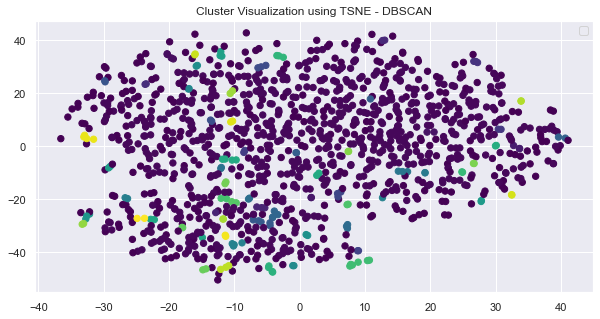

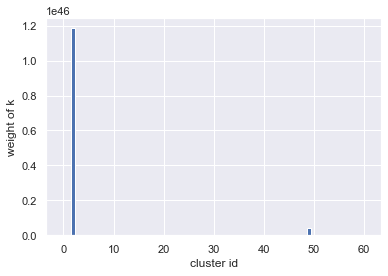

 94%|████████████████████████████████████████▍  | 47/50 [03:40<00:14,  4.68s/it]

[ 6  6 57  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  8  6  6  6  6  6  6  6  6  6  6  6] 56
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

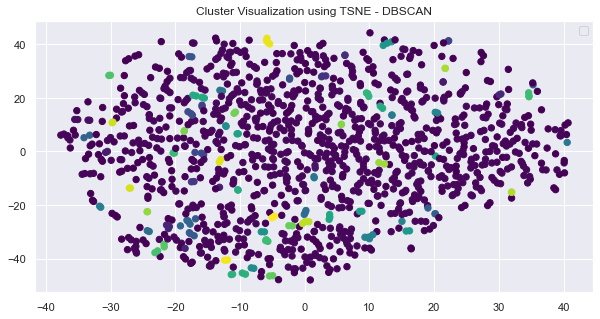

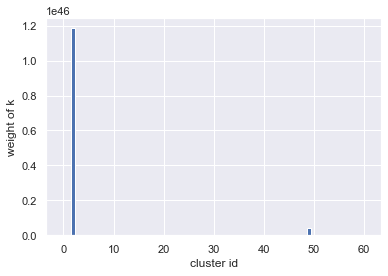

 96%|█████████████████████████████████████████▎ | 48/50 [03:45<00:09,  4.66s/it]

[ 6  6 58  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  8  6  6  6  6  6  6  6  6  6  6  6] 57
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

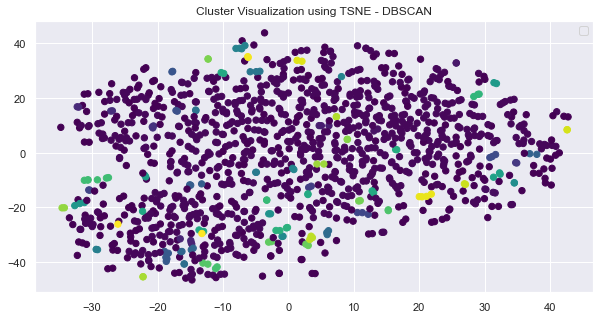

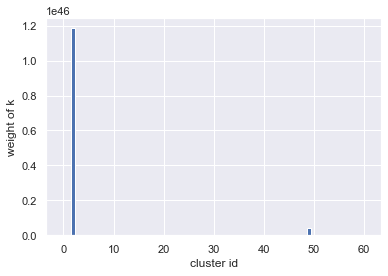

 98%|██████████████████████████████████████████▏| 49/50 [03:50<00:04,  4.69s/it]

[ 6  6 59  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  8  6  6  6  6  6  6  6  6  6  6  6] 58
noisy data count: 362


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

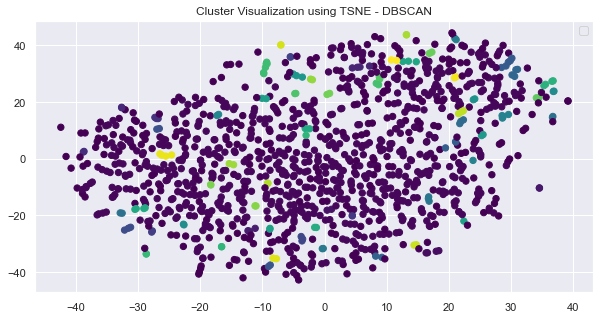

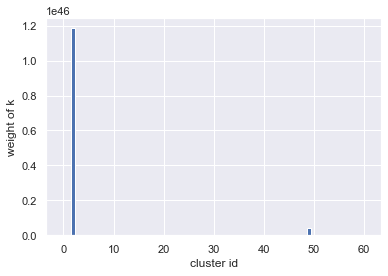

100%|███████████████████████████████████████████| 50/50 [03:54<00:00,  4.69s/it]

[ 6  6 60  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  8  6  6  6  6  6  6  6  6  6  6  6] 59


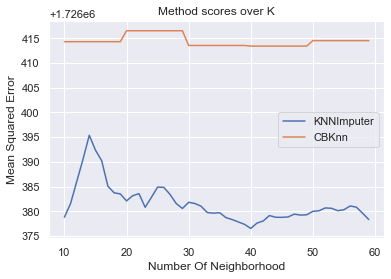

defaultdict(list,
            {'KNNImputer': [1726378.8158352803,
              1726381.6034049946,
              1726386.0949012,
              1726390.5511418048,
              1726395.3773317027,
              1726392.3661964035,
              1726390.2277263852,
              1726385.0790030162,
              1726383.7430317674,
              1726383.5105008052,
              1726382.1102014342,
              1726383.1559098759,
              1726383.5732114895,
              1726380.8116516152,
              1726382.8141433068,
              1726384.8977099878,
              1726384.8430235228,
              1726383.4149960594,
              1726381.5822222547,
              1726380.571550223,
              1726381.8218751776,
              1726381.5815150684,
              1726381.035624289,
              1726379.7531263495,
              1726379.6286673427,
              1726379.7132425068,
              1726378.7287786594,
              1726378.33937458,
              1726377.8

In [73]:
density_based_knn(X, y_true, min_samples=2)

## Load Titanic Dataset

In [74]:
df, y_true = load_titanic(nan_percentage=0.2, uniform_nan=True)
X = df.values
df.head()

S    554
C    130
Q     28
Name: Embarked, dtype: int64


,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked,Survived
0,0.908600,0.756138,-0.534105,0.522511,-0.506787,-0.516380,0.519588,-0.824163
1,-1.482983,-1.322511,0.598393,0.522511,-0.506787,0.694046,-2.049487,1.213352
2,0.908600,-1.322511,NaN,-0.552714,-0.506787,-0.503620,0.519588,1.213352
3,-1.482983,-1.322511,0.386049,0.522511,-0.506787,0.350326,0.519588,1.213352
4,0.908600,0.756138,0.386049,-0.552714,-0.506787,-0.501257,0.519588,-0.824163


100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 12.64it/s]


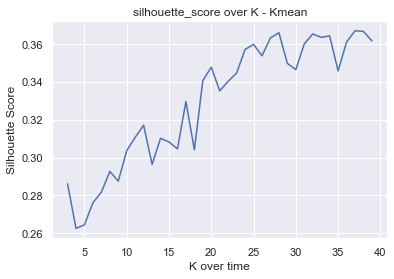

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

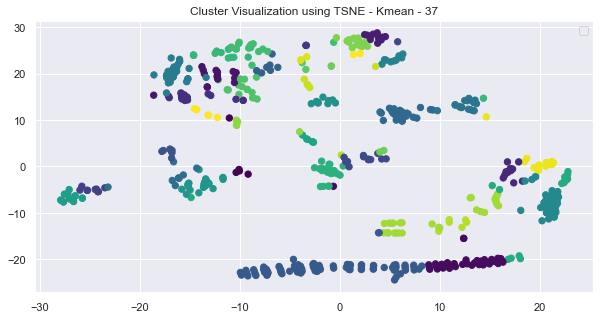

Kmean - 37, score: 0.3671289372509685


100%|███████████████████████████████████████████| 37/37 [00:04<00:00,  8.27it/s]


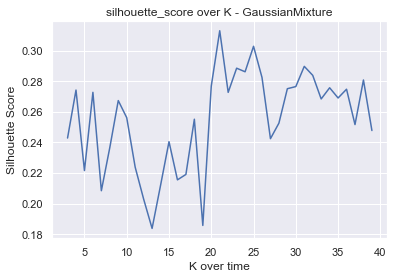

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

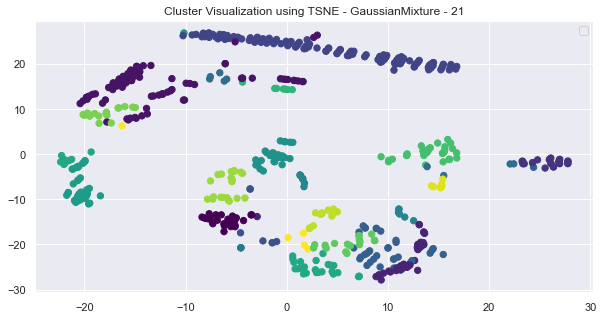

GaussianMixture - 21, score: 0.3129287453474917


100%|██████████████████████████████████████████| 37/37 [00:00<00:00, 113.64it/s]


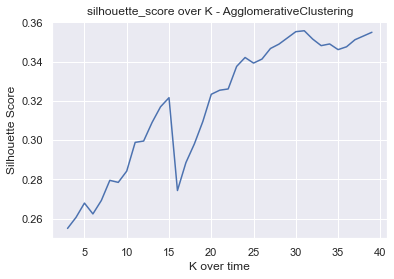

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

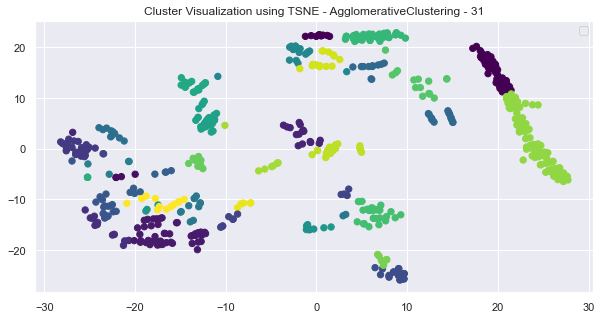

AgglomerativeClustering - 31, score: 0.3556685287418094


100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.73it/s]


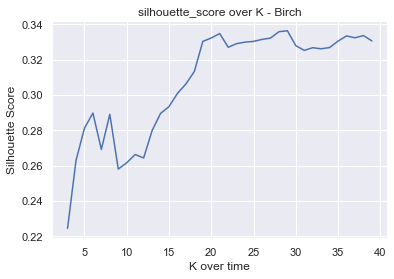

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

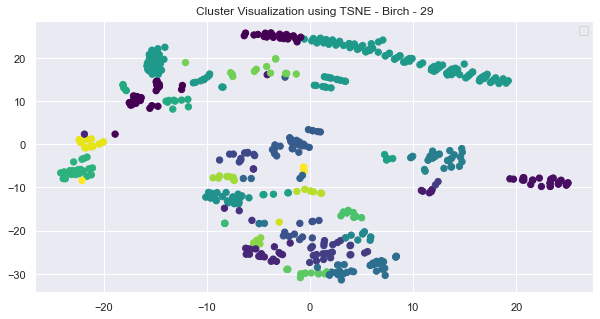

Birch - 29, score: 0.3364480834662112


100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 1448.04it/s]


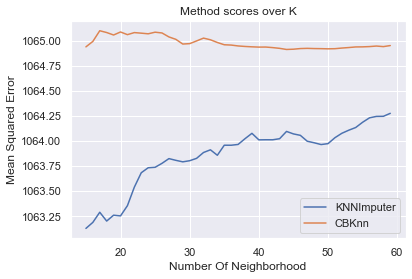

In [75]:
eval_methods_over_k(X, y_true)

noisy data count with eps=0.1: 349
noisy data count with eps=0.10990990990990991: 335
noisy data count with eps=0.11981981981981983: 335
noisy data count with eps=0.12972972972972974: 331
noisy data count with eps=0.13963963963963966: 326
noisy data count with eps=0.14954954954954958: 303
noisy data count with eps=0.15945945945945947: 297
noisy data count with eps=0.1693693693693694: 295
noisy data count with eps=0.17927927927927928: 293
noisy data count with eps=0.1891891891891892: 292
noisy data count with eps=0.19909909909909912: 292
noisy data count with eps=0.20900900900900904: 288
noisy data count with eps=0.21891891891891893: 271
noisy data count with eps=0.22882882882882885: 269
noisy data count with eps=0.23873873873873877: 264
noisy data count with eps=0.24864864864864866: 258
noisy data count with eps=0.2585585585585586: 254
noisy data count with eps=0.2684684684684685: 253
noisy data count with eps=0.2783783783783784: 252
noisy data count with eps=0.28828828828828834: 248
n

noisy data count with eps=1.8243243243243246: 14
noisy data count with eps=1.8342342342342346: 13
noisy data count with eps=1.8441441441441444: 13
noisy data count with eps=1.8540540540540544: 13
noisy data count with eps=1.8639639639639642: 13
noisy data count with eps=1.8738738738738743: 13
noisy data count with eps=1.883783783783784: 13
noisy data count with eps=1.893693693693694: 13
noisy data count with eps=1.903603603603604: 13
noisy data count with eps=1.9135135135135137: 12
noisy data count with eps=1.9234234234234238: 12
noisy data count with eps=1.9333333333333336: 12
noisy data count with eps=1.9432432432432436: 12
noisy data count with eps=1.9531531531531534: 12
noisy data count with eps=1.9630630630630634: 12
noisy data count with eps=1.9729729729729732: 12
noisy data count with eps=1.9828828828828833: 11
noisy data count with eps=1.992792792792793: 11
noisy data count with eps=2.002702702702703: 11
noisy data count with eps=2.012612612612613: 11
noisy data count with eps=

noisy data count with eps=3.548648648648649: 1
noisy data count with eps=3.558558558558559: 1
noisy data count with eps=3.568468468468469: 1
noisy data count with eps=3.5783783783783787: 1
noisy data count with eps=3.5882882882882887: 1
noisy data count with eps=3.5981981981981987: 1
noisy data count with eps=3.608108108108109: 1
noisy data count with eps=3.6180180180180184: 1
noisy data count with eps=3.6279279279279284: 1
noisy data count with eps=3.6378378378378384: 1
noisy data count with eps=3.6477477477477485: 1
noisy data count with eps=3.657657657657658: 1
noisy data count with eps=3.667567567567568: 1
noisy data count with eps=3.677477477477478: 1
noisy data count with eps=3.6873873873873877: 1
noisy data count with eps=3.6972972972972977: 1
noisy data count with eps=3.7072072072072078: 1
noisy data count with eps=3.717117117117118: 1
noisy data count with eps=3.7270270270270274: 1
noisy data count with eps=3.7369369369369374: 1
noisy data count with eps=3.7468468468468474: 1


noisy data count with eps=5.2729729729729735: 0
noisy data count with eps=5.282882882882883: 0
noisy data count with eps=5.292792792792793: 0
noisy data count with eps=5.302702702702703: 0
noisy data count with eps=5.312612612612613: 0
noisy data count with eps=5.322522522522522: 0
noisy data count with eps=5.332432432432433: 0
noisy data count with eps=5.342342342342342: 0
noisy data count with eps=5.352252252252253: 0
noisy data count with eps=5.3621621621621625: 0
noisy data count with eps=5.372072072072072: 0
noisy data count with eps=5.3819819819819825: 0
noisy data count with eps=5.391891891891892: 0
noisy data count with eps=5.401801801801802: 0
noisy data count with eps=5.411711711711712: 0
noisy data count with eps=5.421621621621622: 0
noisy data count with eps=5.431531531531531: 0
noisy data count with eps=5.441441441441442: 0
noisy data count with eps=5.451351351351351: 0
noisy data count with eps=5.461261261261262: 0
noisy data count with eps=5.4711711711711715: 0
noisy dat

noisy data count with eps=7.046846846846847: 0
noisy data count with eps=7.056756756756757: 0
noisy data count with eps=7.066666666666667: 0
noisy data count with eps=7.076576576576577: 0
noisy data count with eps=7.0864864864864865: 0
noisy data count with eps=7.096396396396397: 0
noisy data count with eps=7.1063063063063066: 0
noisy data count with eps=7.116216216216217: 0
noisy data count with eps=7.126126126126127: 0
noisy data count with eps=7.136036036036036: 0
noisy data count with eps=7.145945945945947: 0
noisy data count with eps=7.155855855855856: 0
noisy data count with eps=7.165765765765766: 0
noisy data count with eps=7.175675675675676: 0
noisy data count with eps=7.185585585585586: 0
noisy data count with eps=7.195495495495496: 0
noisy data count with eps=7.205405405405406: 0
noisy data count with eps=7.215315315315316: 0
noisy data count with eps=7.225225225225226: 0
noisy data count with eps=7.235135135135136: 0
noisy data count with eps=7.245045045045045: 0
noisy data 

noisy data count with eps=8.89009009009009: 0
noisy data count with eps=8.9: 0
noisy data count with eps=8.90990990990991: 0
noisy data count with eps=8.919819819819821: 0
noisy data count with eps=8.929729729729731: 0
noisy data count with eps=8.93963963963964: 0
noisy data count with eps=8.94954954954955: 0
noisy data count with eps=8.95945945945946: 0
noisy data count with eps=8.96936936936937: 0
noisy data count with eps=8.97927927927928: 0
noisy data count with eps=8.98918918918919: 0
noisy data count with eps=8.9990990990991: 0
noisy data count with eps=9.00900900900901: 0
noisy data count with eps=9.018918918918919: 0
noisy data count with eps=9.02882882882883: 0
noisy data count with eps=9.03873873873874: 0
noisy data count with eps=9.04864864864865: 0
noisy data count with eps=9.058558558558559: 0
noisy data count with eps=9.068468468468469: 0
noisy data count with eps=9.078378378378378: 0
noisy data count with eps=9.08828828828829: 0
noisy data count with eps=9.0981981981982:

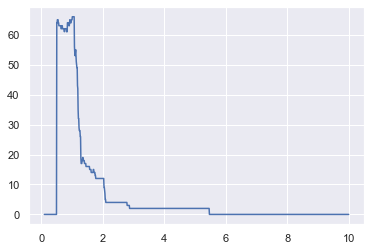

  0%|                                                    | 0/50 [00:00<?, ?it/s]

noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


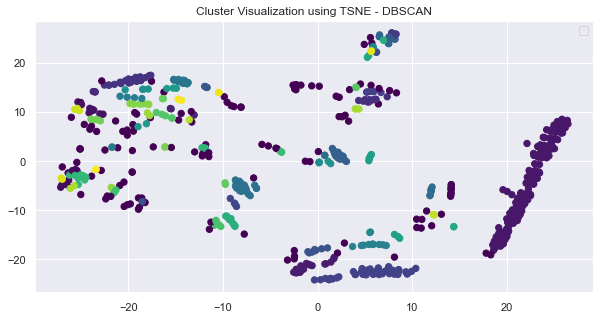

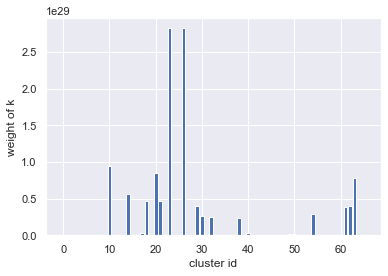

  2%|▉                                           | 1/50 [00:02<02:20,  2.87s/it]

[ 2  2  2  2  2  2  2  2  2  2  5  2  2  2  3  2  2  2  3  2  4  3  2 10
  2  2 11  2  2  3  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  3  3  4  2  2] 10
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

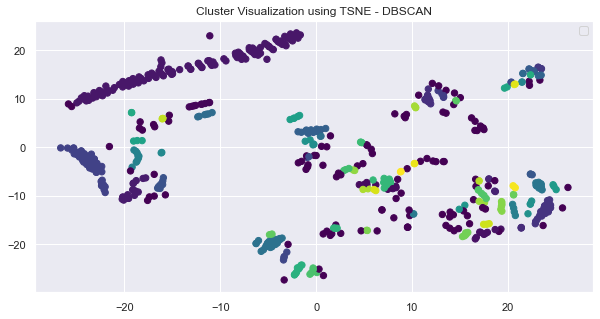

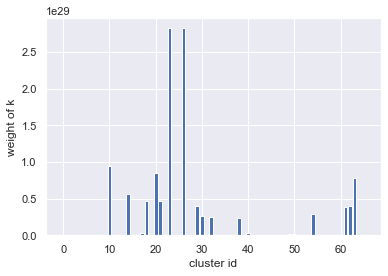

  4%|█▊                                          | 2/50 [00:06<02:25,  3.03s/it]

[ 2  2  2  2  2  2  2  2  2  2  5  2  2  2  4  2  2  2  3  2  5  3  2 11
  2  2 12  2  2  3  3  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  3  2  2  2  2  2  2  3  3  4  2  2] 11
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

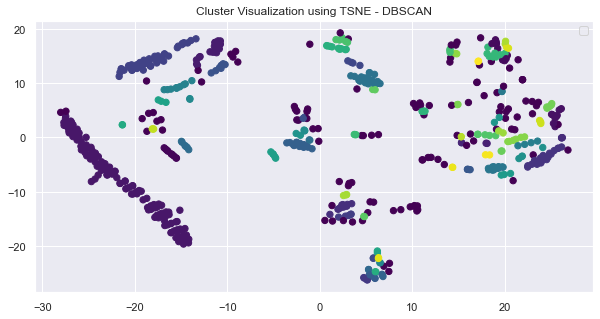

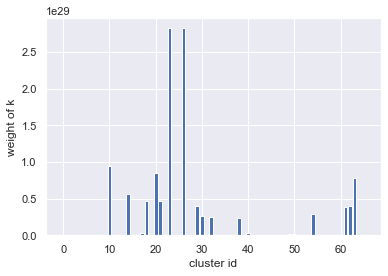

  6%|██▋                                         | 3/50 [00:09<02:23,  3.05s/it]

[ 2  2  2  2  2  2  2  2  2  2  5  2  2  2  4  2  2  2  4  2  5  4  2 12
  2  2 13  2  2  3  3  2  3  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  3  2  2  2  2  2  2  3  3  5  2  2] 12
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

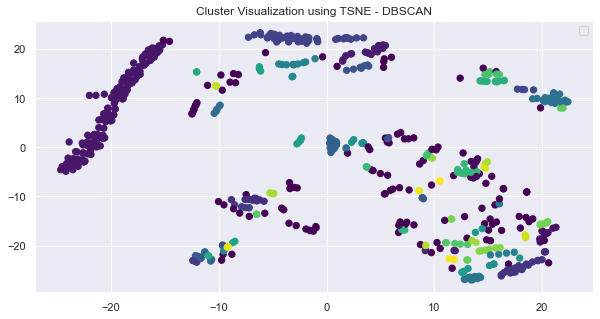

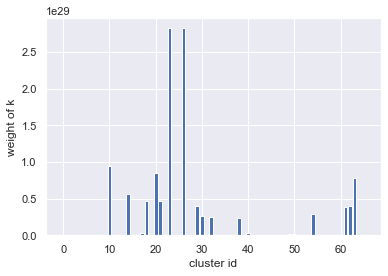

  8%|███▌                                        | 4/50 [00:12<02:18,  3.01s/it]

[ 2  2  2  2  2  2  2  2  2  2  6  2  2  2  4  2  2  2  4  2  5  4  2 13
  2  2 14  2  2  3  3  2  3  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  3  2  2  2  2  2  2  3  3  5  2  2] 13
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

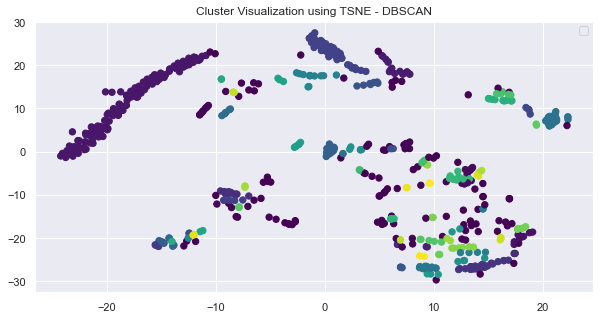

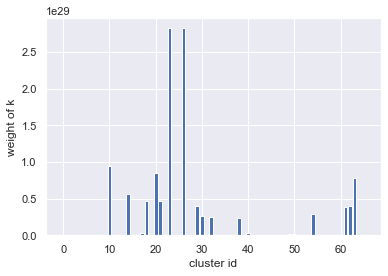

 10%|████▍                                       | 5/50 [00:14<02:12,  2.95s/it]

[ 2  2  2  2  2  2  2  2  2  2  6  2  2  2  4  2  2  2  4  2  6  4  2 14
  2  2 15  2  2  4  3  2  3  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  3  2  2  2  2  2  2  4  4  5  2  2] 14
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

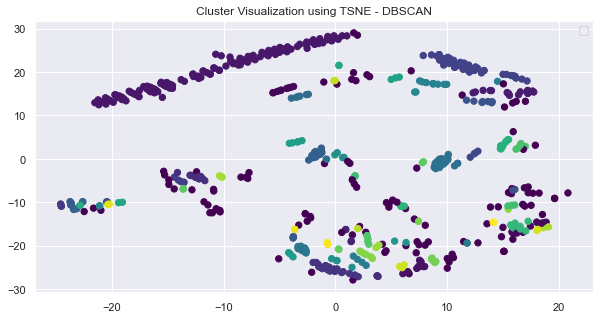

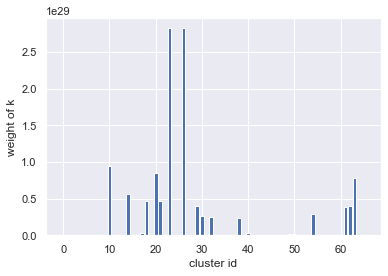

 12%|█████▎                                      | 6/50 [00:17<02:10,  2.96s/it]

[ 2  2  2  2  2  2  2  2  2  2  7  2  2  2  5  2  2  2  4  2  6  4  2 15
  2  2 15  2  2  4  3  2  3  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  3  2  2  2  2  2  2  4  4  6  2  2] 15
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

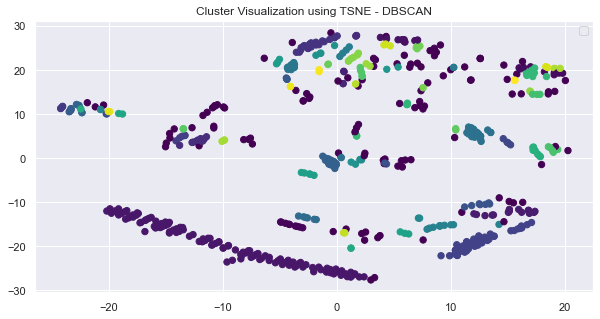

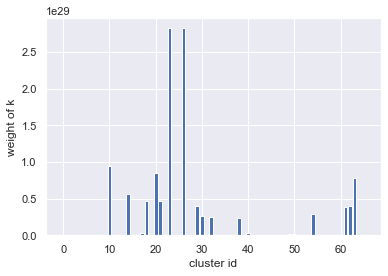

 14%|██████▏                                     | 7/50 [00:20<02:04,  2.90s/it]

[ 2  2  2  2  2  2  2  2  2  2  7  2  2  2  5  2  2  2  5  2  6  5  2 16
  2  2 17  2  2  4  3  2  3  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  4  2  2  2  2  2  2  4  4  6  2  2] 16
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

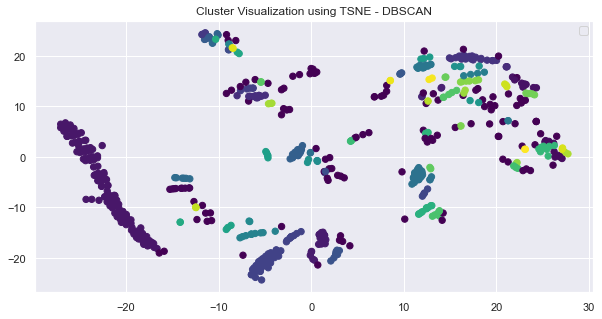

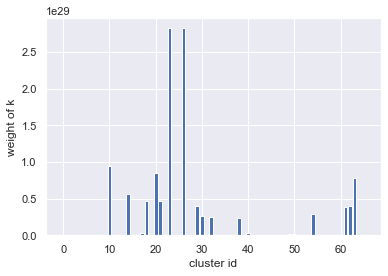

 16%|███████                                     | 8/50 [00:23<02:03,  2.93s/it]

[ 2  2  2  2  2  2  2  2  2  2  7  2  2  2  5  2  2  2  5  2  7  5  2 17
  2  2 18  2  2  4  4  2  4  2  2  2  2  2  3  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  4  2  2  2  2  2  2  4  4  6  2  2] 17
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

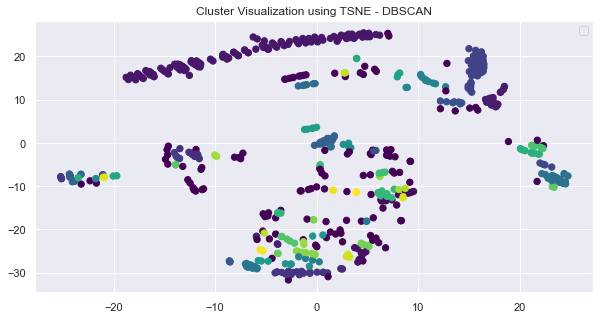

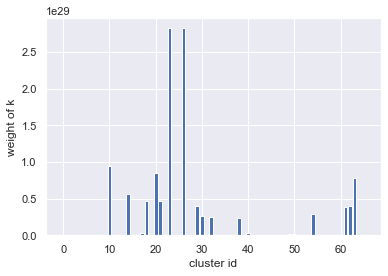

 18%|███████▉                                    | 9/50 [00:26<02:04,  3.04s/it]

[ 2  2  2  2  2  2  2  2  2  2  8  2  2  2  6  2  2  2  5  2  7  5  2 18
  2  2 19  2  2  5  4  2  4  2  2  2  2  2  4  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  4  2  2  2  2  2  2  4  5  7  2  2] 18
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

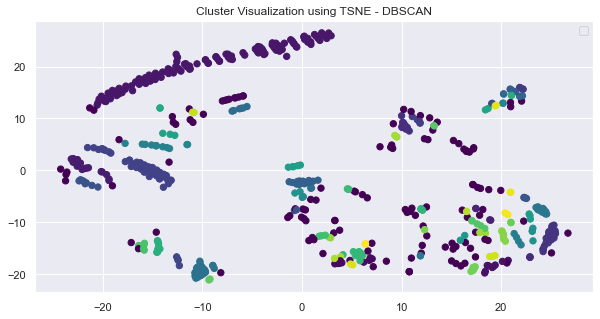

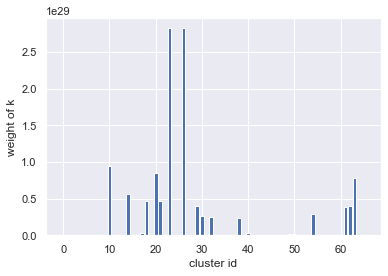

 20%|████████▌                                  | 10/50 [00:30<02:03,  3.09s/it]

[ 2  2  2  2  2  2  2  2  2  2  8  2  2  2  6  2  2  3  5  2  8  5  2 19
  2  2 20  2  2  5  4  2  4  2  2  2  2  2  4  2  3  2  2  2  2  2  2  2
  2  3  2  2  2  2  4  2  2  2  2  2  2  5  5  7  2  2] 19
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

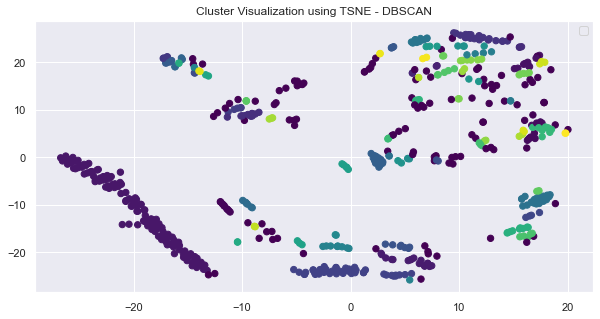

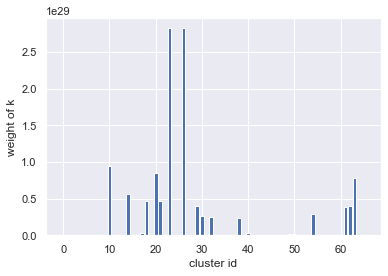

 22%|█████████▍                                 | 11/50 [00:32<01:53,  2.92s/it]

[ 3  3  3  3  3  3  3  3  3  3  9  3  3  3  6  3  3  3  6  3  8  6  3 20
  3  3 21  3  3  5  4  3  4  3  3  3  3  3  4  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  4  3  3  3  3  3  3  5  5  8  3  3] 20
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

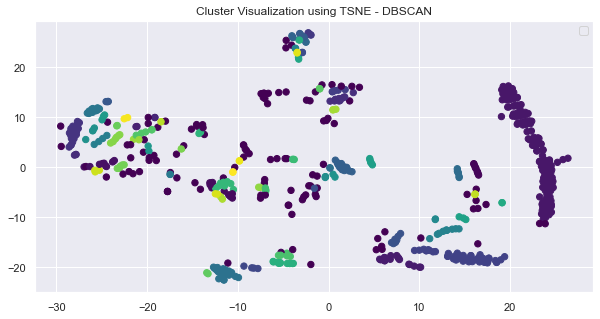

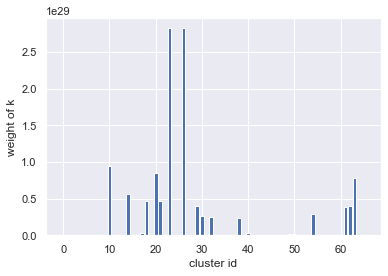

 24%|██████████▎                                | 12/50 [00:35<01:49,  2.88s/it]

[ 3  3  3  3  3  3  3  3  3  3  9  3  3  3  6  3  3  3  6  3  8  6  3 21
  3  3 22  3  3  5  4  3  4  3  3  3  3  3  4  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  5  3  3  3  3  3  3  5  5  8  3  3] 21
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

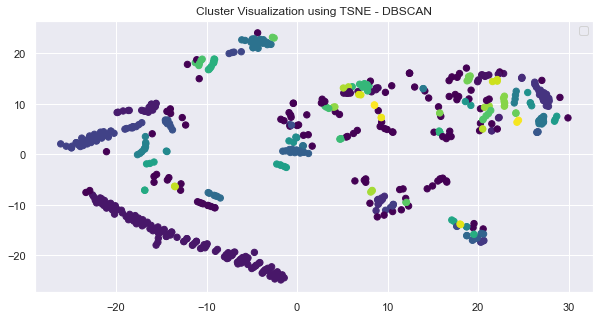

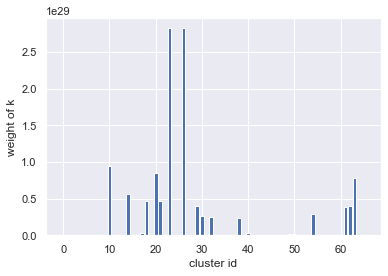

 26%|███████████▏                               | 13/50 [00:38<01:45,  2.86s/it]

[ 3  3  3  3  3  3  3  3  3  3  9  3  3  3  7  3  3  3  6  3  9  6  3 22
  3  3 23  3  3  6  5  3  4  3  3  3  3  3  4  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  5  3  3  3  3  3  3  5  6  8  3  3] 22
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

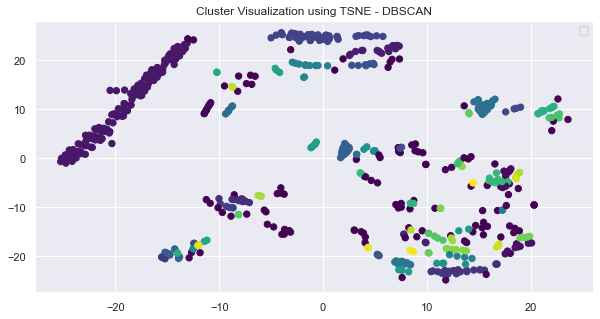

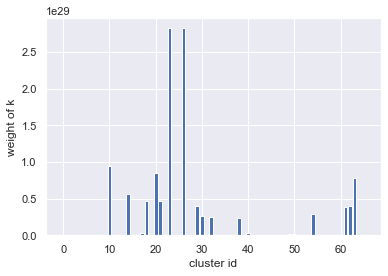

 28%|████████████                               | 14/50 [00:40<01:40,  2.78s/it]

[ 3  3  3  3  3  3  3  3  3  3 10  3  3  3  7  3  3  3  6  3  9  6  3 23
  3  3 24  3  3  6  5  3  5  3  3  3  3  3  5  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  5  3  3  3  3  3  3  6  6  9  3  3] 23
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

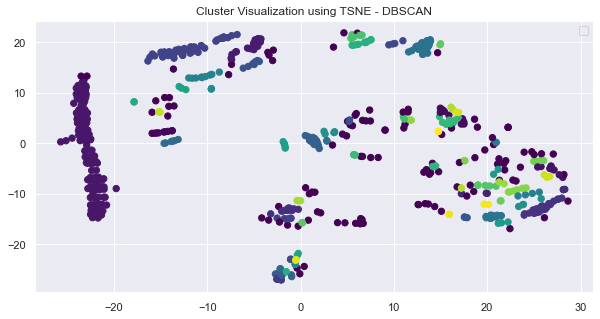

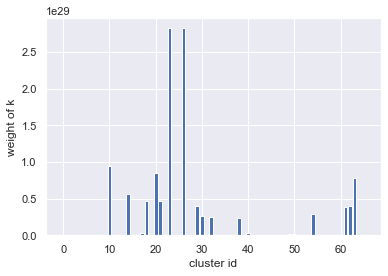

 30%|████████████▉                              | 15/50 [00:43<01:40,  2.88s/it]

[ 3  3  3  3  3  3  3  3  3  3 10  3  3  3  7  3  3  3  7  3  9  7  3 24
  3  3 25  3  3  6  5  3  5  3  3  3  3  3  5  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  5  3  3  3  3  3  3  6  6  9  3  3] 24
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

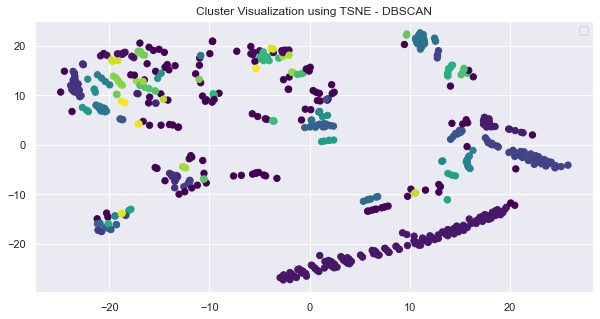

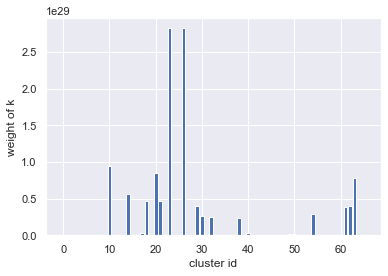

 32%|█████████████▊                             | 16/50 [00:46<01:37,  2.85s/it]

[ 3  3  3  3  3  3  3  3  3  3 11  3  3  3  8  3  3  3  7  3 10  7  3 25
  3  3 26  3  3  6  5  3  5  3  3  3  3  3  5  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  5  3  3  3  3  3  3  6  6  9  3  3] 25
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

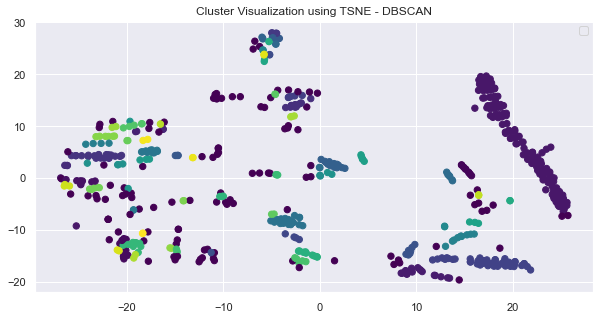

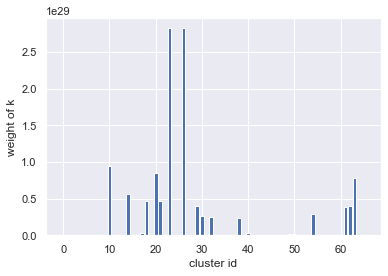

 34%|██████████████▌                            | 17/50 [00:49<01:35,  2.91s/it]

[ 3  3  3  3  3  3  3  3  3  3 11  3  3  3  8  3  3  3  7  3 10  7  3 26
  3  3 27  3  3  6  5  3  5  3  3  3  3  3  5  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  6  3  3  3  3  3  3  6  6 10  3  3] 26
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

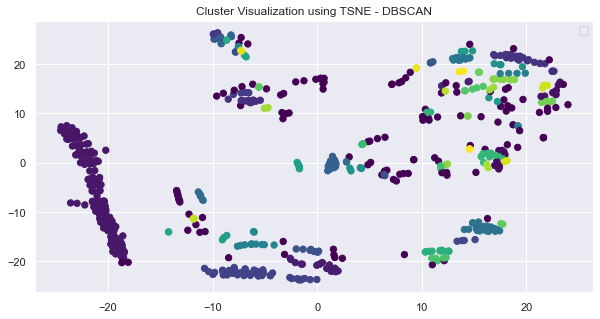

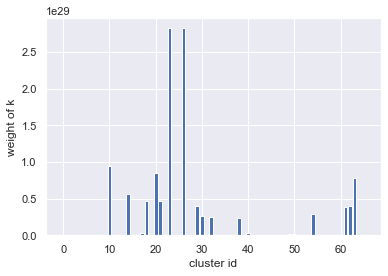

 36%|███████████████▍                           | 18/50 [00:52<01:31,  2.86s/it]

[ 3  3  3  3  3  3  3  3  3  3 11  3  3  3  8  3  3  3  7  3 10  7  3 27
  3  3 28  3  3  7  5  3  5  3  3  3  3  3  5  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  6  3  3  3  3  3  3  6  7 10  3  3] 27
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

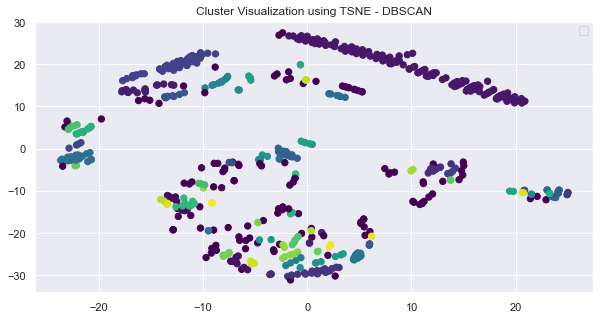

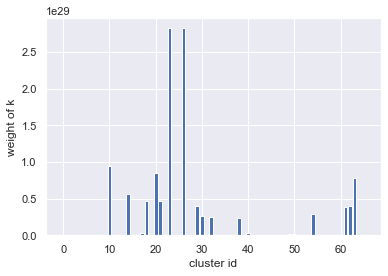

 38%|████████████████▎                          | 19/50 [00:55<01:29,  2.89s/it]

[ 3  3  3  3  3  3  3  3  3  3 12  3  3  3  8  3  3  4  8  3 11  8  3 28
  3  3 29  3  3  7  6  3  5  3  3  3  3  3  5  3  4  3  3  3  3  3  3  3
  3  3  3  3  3  3  6  3  3  3  3  3  3  7  7 10  3  3] 28
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

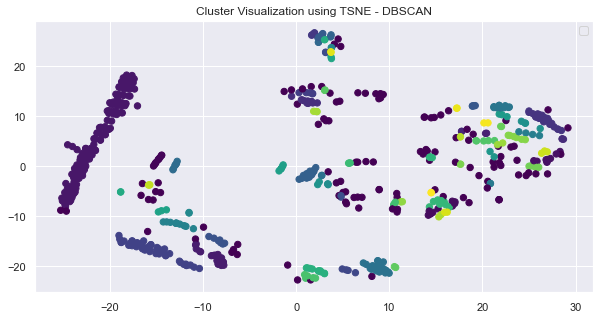

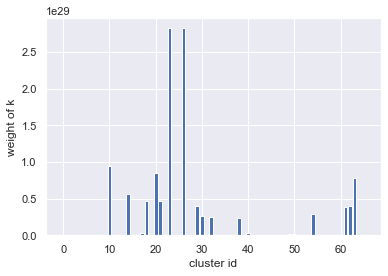

 40%|█████████████████▏                         | 20/50 [00:59<01:32,  3.10s/it]

[ 3  3  3  3  3  3  3  3  3  3 12  3  3  3  9  3  3  4  8  3 11  8  3 29
  3  3 30  3  3  7  6  3  6  3  3  3  3  3  6  3  4  3  3  3  3  3  3  3
  3  4  4  3  3  3  6  3  3  3  3  3  3  7  7 11  3  3] 29
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

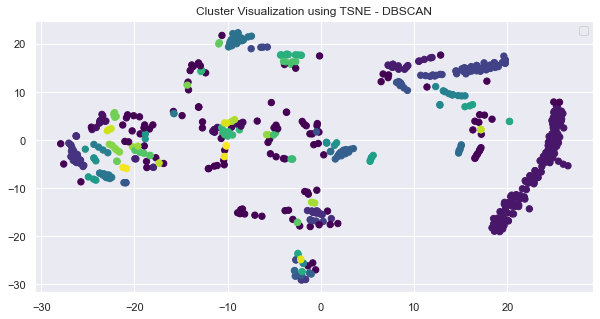

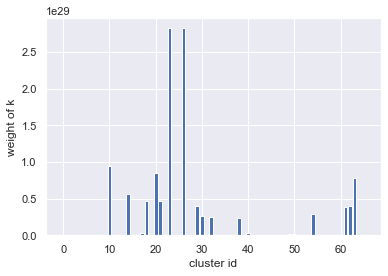

 42%|██████████████████                         | 21/50 [01:02<01:29,  3.10s/it]

[ 4  4  4  4  4  4  4  4  4  4 13  4  4  4  9  4  4  4  8  4 12  8  4 30
  4  4 30  4  4  7  6  4  6  4  4  4  4  4  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  6  4  4  4  4  4  4  7  7 11  4  4] 30
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

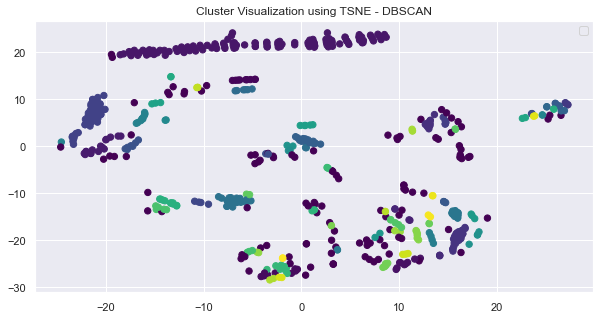

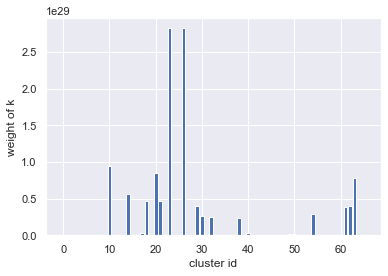

 44%|██████████████████▉                        | 22/50 [01:05<01:27,  3.11s/it]

[ 4  4  4  4  4  4  4  4  4  4 13  4  4  4  9  4  4  4  8  4 12  8  4 31
  4  4 32  4  4  8  6  4  6  4  4  4  4  4  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  7  4  4  4  4  4  4  7  8 11  4  4] 31
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

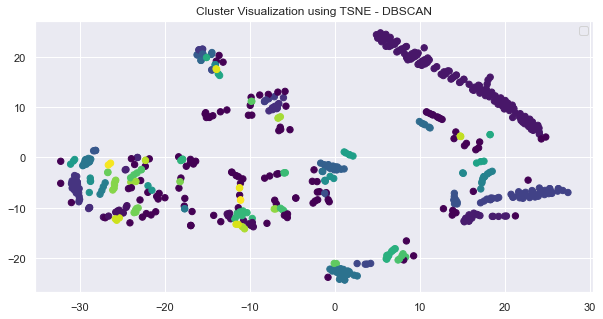

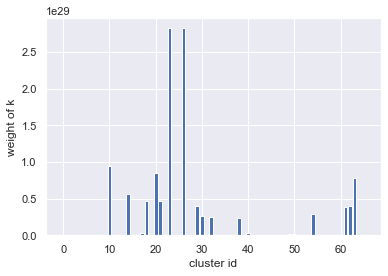

 46%|███████████████████▊                       | 23/50 [01:08<01:23,  3.09s/it]

[ 4  4  4  4  4  4  4  4  4  4 13  4  4  4  9  4  4  4  9  4 12  9  4 32
  4  4 33  4  4  8  6  4  6  4  4  4  4  4  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  7  4  4  4  4  4  4  8  8 12  4  4] 32
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

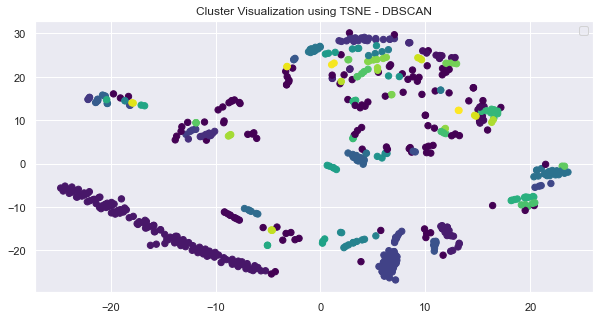

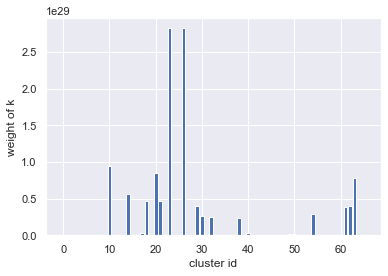

 48%|████████████████████▋                      | 24/50 [01:11<01:17,  3.00s/it]

[ 4  4  4  4  4  4  4  4  4  4 14  4  4  4 10  4  4  4  9  4 13  9  4 33
  4  4 34  4  4  8  7  4  6  4  4  4  4  4  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  7  4  4  4  4  4  4  8  8 12  4  4] 33
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

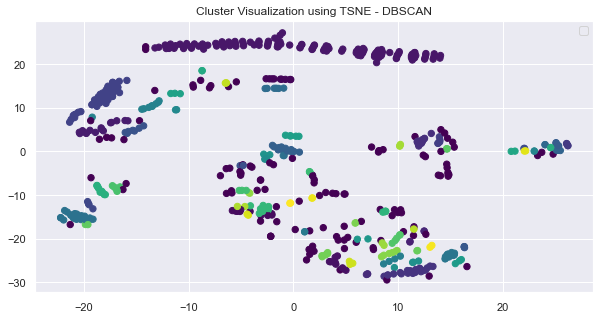

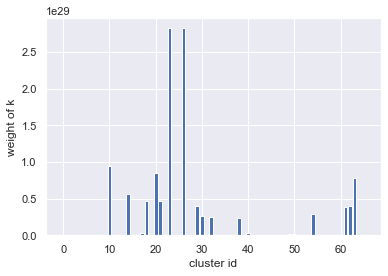

 50%|█████████████████████▌                     | 25/50 [01:14<01:17,  3.12s/it]

[ 4  4  4  4  4  4  4  4  4  4 14  4  4  4 10  4  4  4  9  4 13  9  4 34
  4  4 35  4  4  8  7  4  7  4  4  4  4  4  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  7  4  4  4  4  4  4  8  8 12  4  4] 34
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

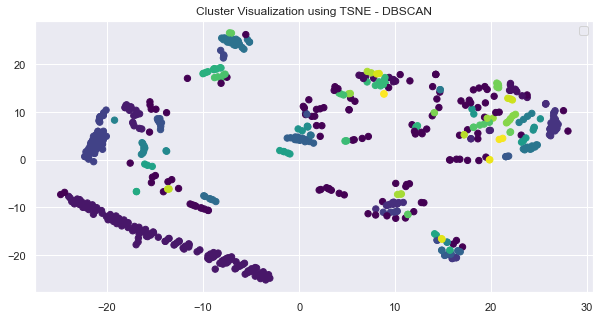

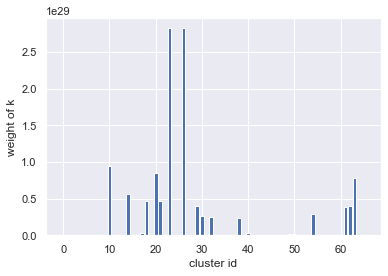

 52%|██████████████████████▎                    | 26/50 [01:17<01:14,  3.11s/it]

[ 4  4  4  4  4  4  4  4  4  4 15  4  4  4 10  4  4  4  9  4 13  9  4 35
  4  4 36  4  4  9  7  4  7  4  4  4  4  4  7  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  7  4  4  4  4  4  4  8  9 13  4  4] 35
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

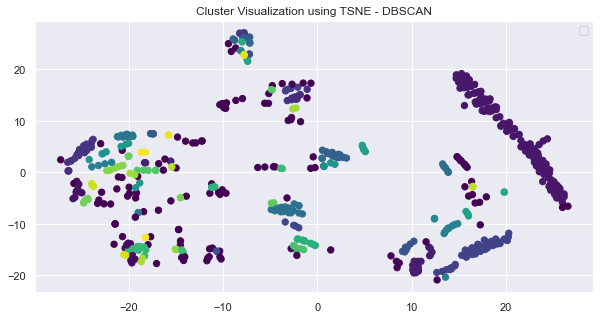

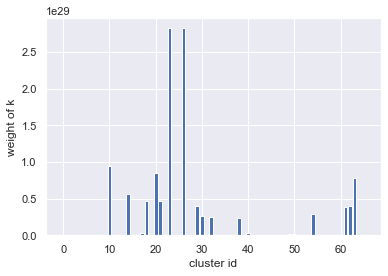

 54%|███████████████████████▏                   | 27/50 [01:20<01:12,  3.16s/it]

[ 4  4  4  4  4  4  4  4  4  4 15  4  4  4 11  4  4  4 10  4 14 10  4 36
  4  4 37  4  4  9  7  4  7  4  4  4  4  4  7  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  8  4  4  4  4  4  4  8  9 13  4  4] 36
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

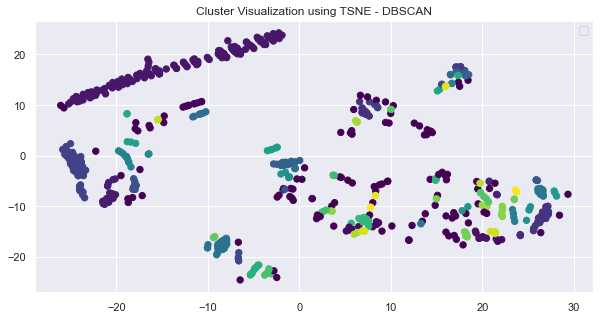

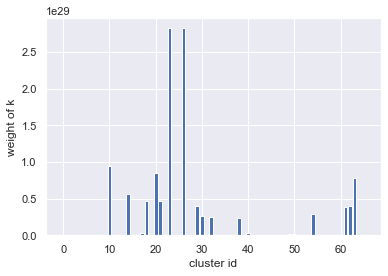

 56%|████████████████████████                   | 28/50 [01:24<01:10,  3.21s/it]

[ 4  4  4  4  4  4  4  4  4  4 15  4  4  4 11  4  4  5 10  4 14 10  4 37
  4  4 38  4  4  9  7  4  7  4  4  4  4  4  7  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  8  4  4  4  4  4  4  9  9 13  4  4] 37
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

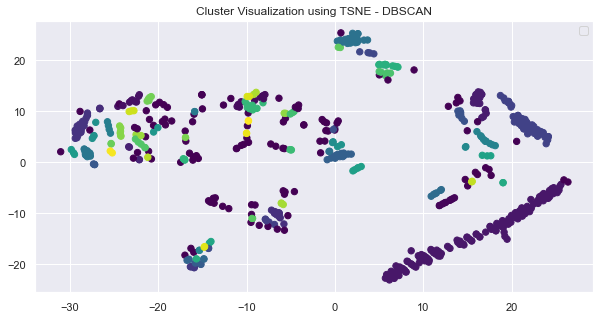

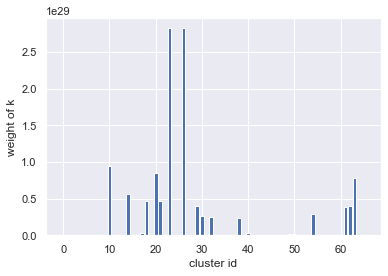

 58%|████████████████████████▉                  | 29/50 [01:27<01:06,  3.19s/it]

[ 4  4  4  4  4  4  4  4  4  4 16  4  4  4 11  4  4  5 10  4 15 10  4 38
  4  4 39  4  4  9  7  4  7  4  4  4  4  4  7  4  5  4  4  4  4  4  4  4
  4  5  4  4  4  4  8  4  4  4  4  4  4  9  9 14  4  4] 38
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

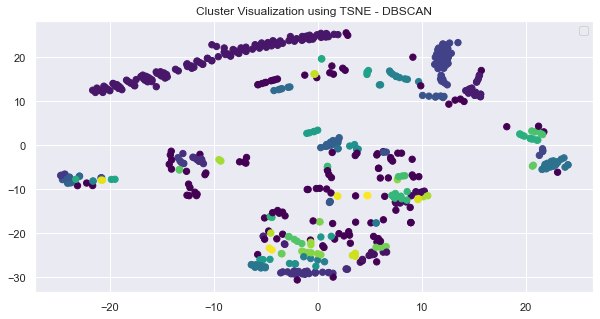

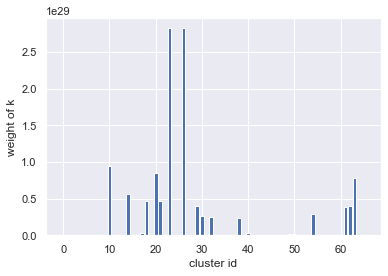

 60%|█████████████████████████▊                 | 30/50 [01:30<01:03,  3.18s/it]

[ 4  4  4  4  4  4  4  4  4  4 16  4  4  4 11  4  4  5 10  4 15 10  4 39
  4  4 40  4  4  9  8  4  7  4  4  4  4  4  7  4  5  4  4  4  4  4  4  4
  4  5  5  4  4  4  8  4  4  4  4  4  4  9  9 14  4  4] 39
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

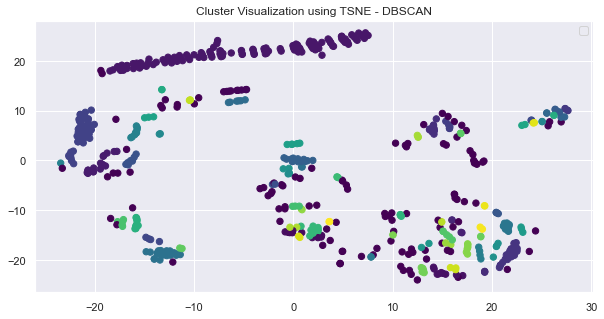

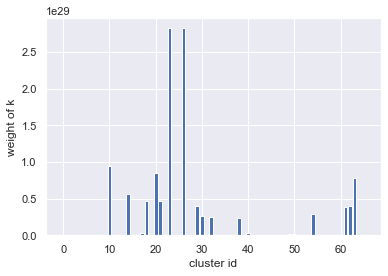

 62%|██████████████████████████▋                | 31/50 [01:33<00:59,  3.12s/it]

[ 5  5  5  5  5  5  5  5  5  5 17  5  5  5 12  5  5  5 11  5 15 11  5 40
  5  5 41  5  5 10  8  5  8  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  8  5  5  5  5  5  5  9 10 15  5  5] 40
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

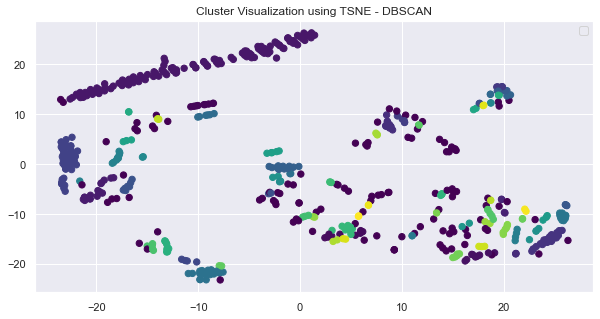

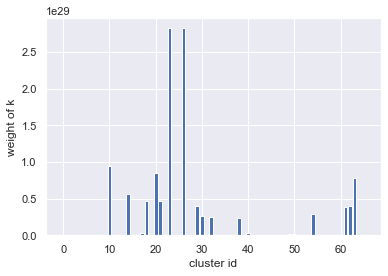

 64%|███████████████████████████▌               | 32/50 [01:37<00:59,  3.30s/it]

[ 5  5  5  5  5  5  5  5  5  5 17  5  5  5 12  5  5  5 11  5 16 11  5 41
  5  5 42  5  5 10  8  5  8  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  8  5  5  5  5  5  5 10 10 15  5  5] 41
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

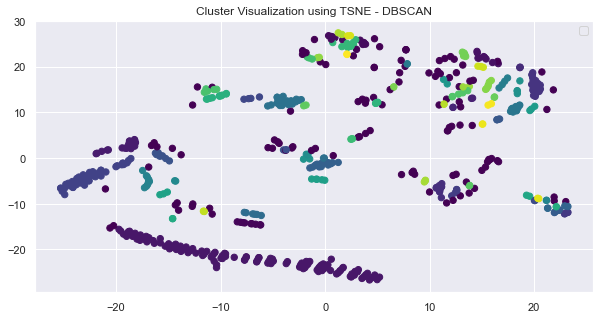

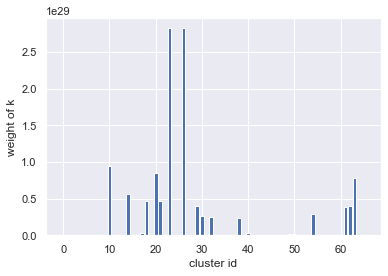

 66%|████████████████████████████▍              | 33/50 [01:40<00:55,  3.27s/it]

[ 5  5  5  5  5  5  5  5  5  5 17  5  5  5 12  5  5  5 11  5 16 11  5 42
  5  5 43  5  5 10  8  5  8  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  9  5  5  5  5  5  5 10 10 15  5  5] 42
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

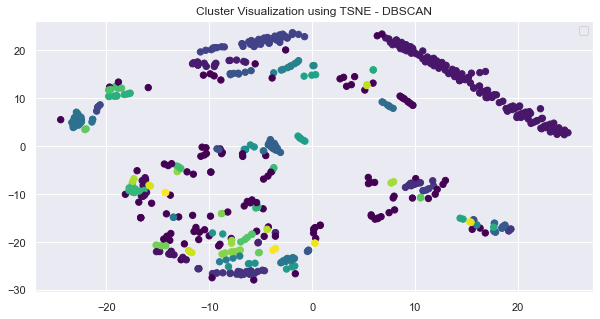

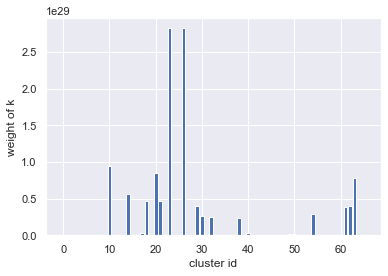

 68%|█████████████████████████████▏             | 34/50 [01:44<00:53,  3.36s/it]

[ 5  5  5  5  5  5  5  5  5  5 18  5  5  5 13  5  5  5 11  5 16 11  5 43
  5  5 44  5  5 10  8  5  8  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  9  5  5  5  5  5  5 10 10 16  5  5] 43
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

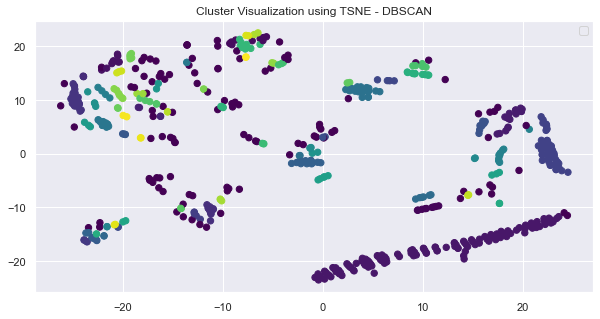

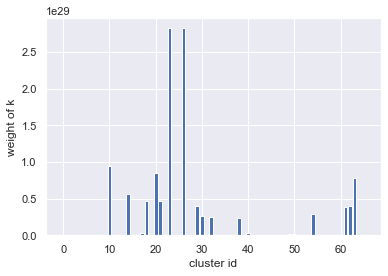

 70%|██████████████████████████████             | 35/50 [01:47<00:51,  3.42s/it]

[ 5  5  5  5  5  5  5  5  5  5 18  5  5  5 13  5  5  5 12  5 17 12  5 44
  5  5 45  5  5 11  9  5  8  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  9  5  5  5  5  5  5 10 11 16  5  5] 44
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

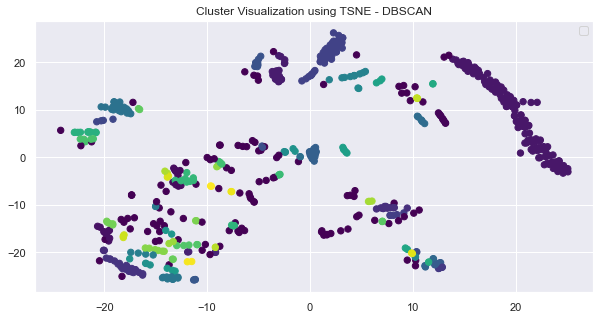

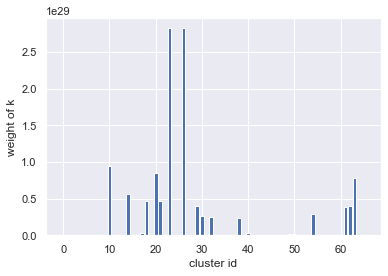

 72%|██████████████████████████████▉            | 36/50 [01:50<00:46,  3.35s/it]

[ 5  5  5  5  5  5  5  5  5  5 19  5  5  5 13  5  5  5 12  5 17 12  5 45
  5  5 46  5  5 11  9  5  9  5  5  5  5  5  8  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  9  5  5  5  5  5  5 10 11 16  5  5] 45
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

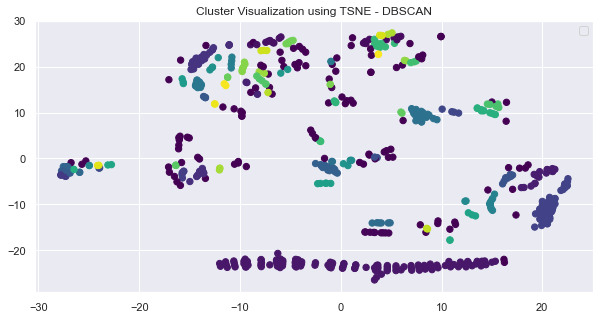

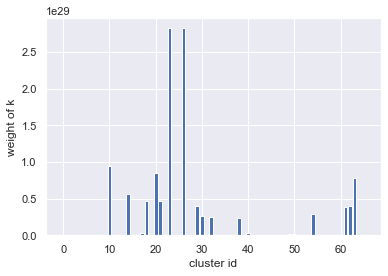

 74%|███████████████████████████████▊           | 37/50 [01:54<00:43,  3.32s/it]

[ 5  5  5  5  5  5  5  5  5  5 19  5  5  5 13  5  5  6 12  5 18 12  5 46
  5  5 47  5  5 11  9  5  9  5  5  5  5  5  9  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  9  5  5  5  5  5  5 11 11 17  5  5] 46
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

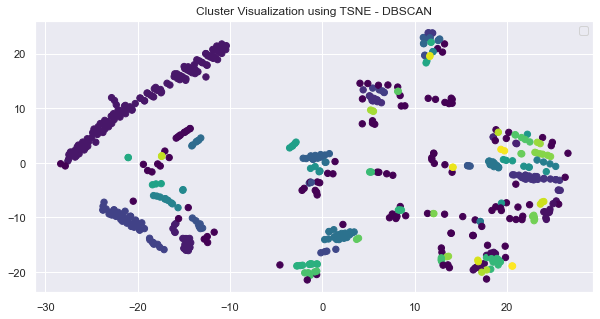

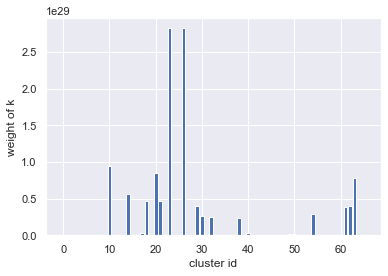

 76%|████████████████████████████████▋          | 38/50 [01:57<00:39,  3.27s/it]

[ 5  5  5  5  5  5  5  5  5  5 19  5  5  5 14  5  5  6 12  5 18 12  5 47
  5  5 48  5  5 11  9  5  9  5  5  5  5  5  9  5  6  5  5  5  5  5  5  5
  5  5  5  5  5  5 10  5  5  5  5  5  5 11 11 17  5  5] 47
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

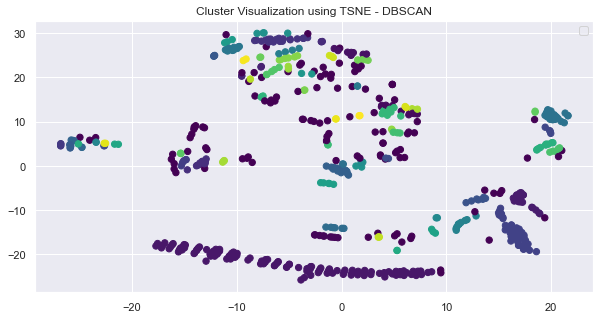

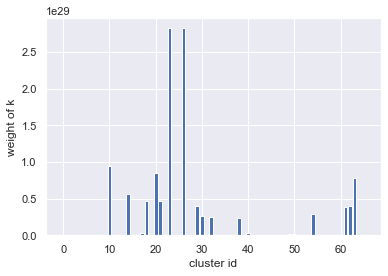

 78%|█████████████████████████████████▌         | 39/50 [02:00<00:34,  3.17s/it]

[ 5  5  5  5  5  5  5  5  5  5 20  5  5  5 14  5  5  6 13  5 18 13  5 48
  5  5 49  5  5 11  9  5  9  5  5  5  5  5  9  5  6  5  5  5  5  5  5  5
  5  6  6  5  5  5 10  5  5  5  5  5  5 11 11 17  5  5] 48
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

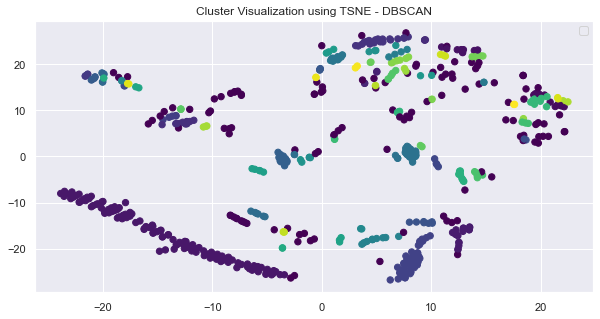

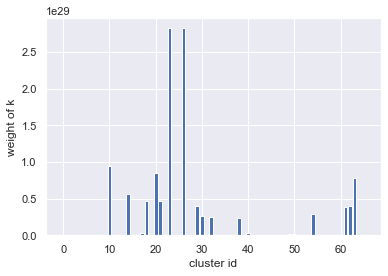

 80%|██████████████████████████████████▍        | 40/50 [02:02<00:30,  3.05s/it]

[ 5  5  5  5  5  5  5  5  5  5 20  5  5  5 14  5  5  6 13  5 19 13  5 49
  5  5 50  5  5 12  9  5  9  5  5  5  5  5  9  5  6  5  5  5  5  5  5  5
  5  6  6  5  5  5 10  5  5  5  5  5  5 11 12 18  5  5] 49
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

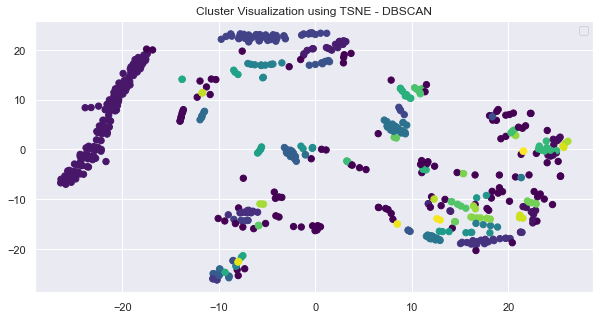

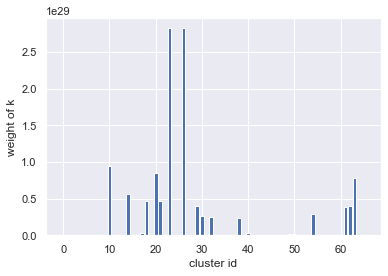

 82%|███████████████████████████████████▎       | 41/50 [02:05<00:26,  2.89s/it]

[ 6  6  6  6  6  6  6  6  6  6 21  6  6  6 15  6  6  6 13  6 19 13  6 50
  6  6 51  6  6 12 10  6  9  6  6  6  6  6  9  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6 10  6  6  6  6  6  6 12 12 18  6  6] 50
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

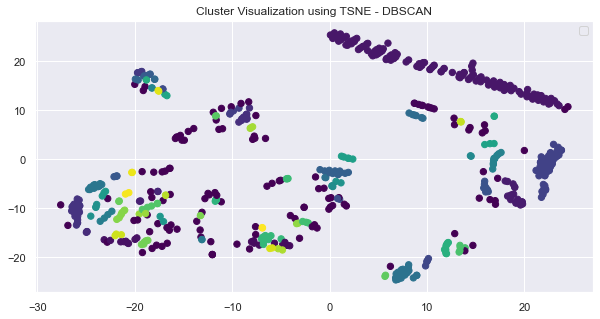

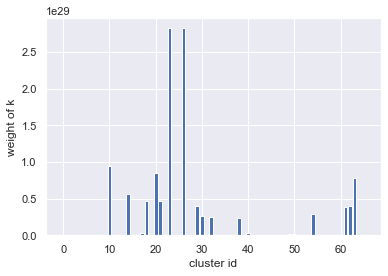

 84%|████████████████████████████████████       | 42/50 [02:08<00:23,  2.99s/it]

[ 6  6  6  6  6  6  6  6  6  6 21  6  6  6 15  6  6  6 13  6 19 13  6 51
  6  6 52  6  6 12 10  6 10  6  6  6  6  6  9  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6 10  6  6  6  6  6  6 12 12 18  6  6] 51
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

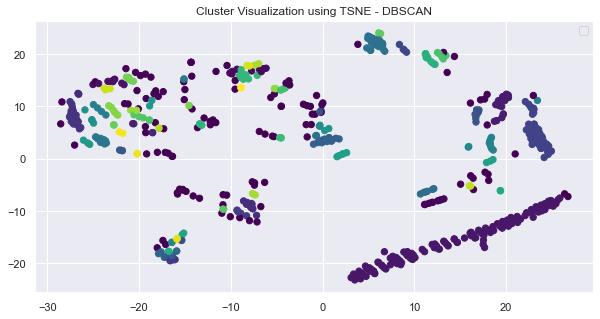

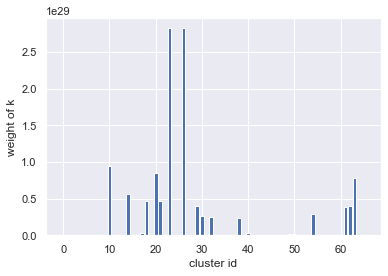

 86%|████████████████████████████████████▉      | 43/50 [02:11<00:21,  3.04s/it]

[ 6  6  6  6  6  6  6  6  6  6 21  6  6  6 15  6  6  6 14  6 20 14  6 52
  6  6 53  6  6 12 10  6 10  6  6  6  6  6 10  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6 11  6  6  6  6  6  6 12 12 19  6  6] 52
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

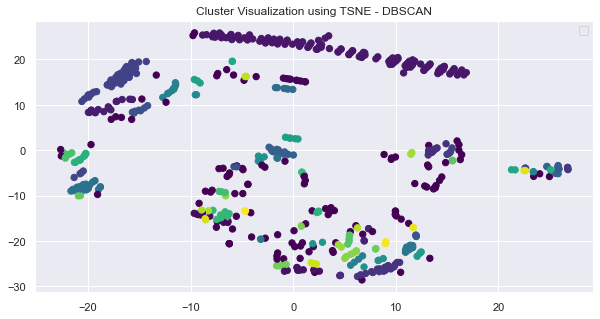

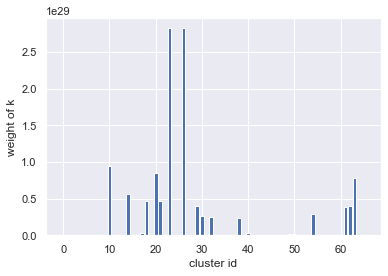

 88%|█████████████████████████████████████▊     | 44/50 [02:14<00:18,  3.08s/it]

[ 6  6  6  6  6  6  6  6  6  6 22  6  6  6 15  6  6  6 14  6 20 14  6 53
  6  6 54  6  6 13 10  6 10  6  6  6  6  6 10  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6 11  6  6  6  6  6  6 12 13 19  6  6] 53
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

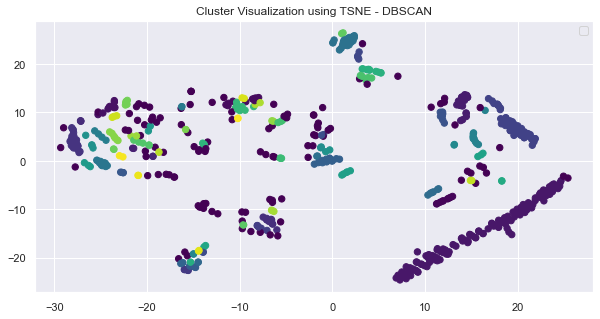

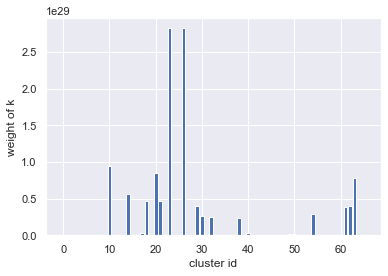

 90%|██████████████████████████████████████▋    | 45/50 [02:18<00:16,  3.23s/it]

[ 6  6  6  6  6  6  6  6  6  6 22  6  6  6 16  6  6  6 14  6 20 14  6 54
  6  6 55  6  6 13 10  6 10  6  6  6  6  6 10  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6 11  6  6  6  6  6  6 12 13 19  6  6] 54
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

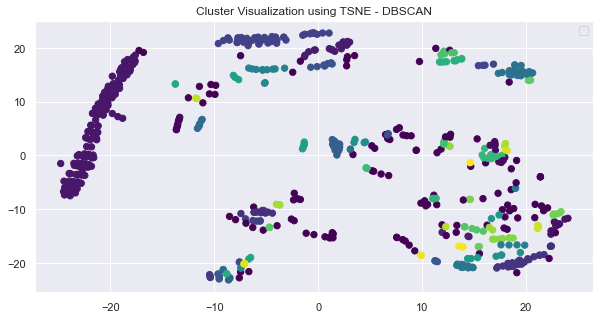

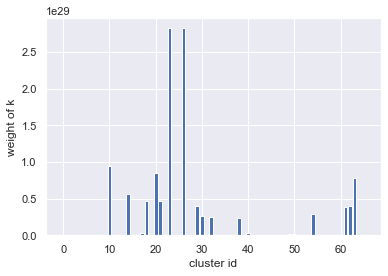

 92%|███████████████████████████████████████▌   | 46/50 [02:21<00:13,  3.28s/it]

[ 6  6  6  6  6  6  6  6  6  6 23  6  6  6 16  6  6  7 14  6 21 14  6 55
  6  6 56  6  6 13 11  6 10  6  6  6  6  6 10  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6 11  6  6  6  6  6  6 13 13 20  6  6] 55
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

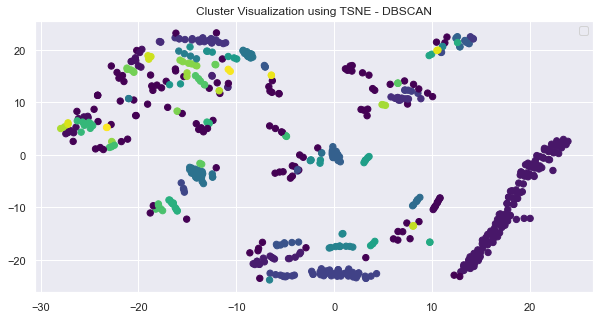

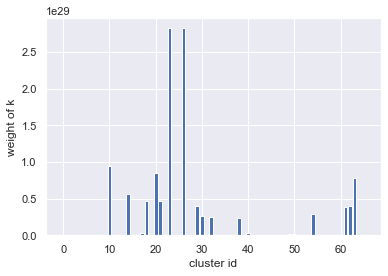

 94%|████████████████████████████████████████▍  | 47/50 [02:28<00:12,  4.16s/it]

[ 6  6  6  6  6  6  6  6  6  6 23  6  6  6 16  6  6  7 15  6 21 15  6 56
  6  6 57  6  6 13 11  6 10  6  6  6  6  6 10  6  7  6  6  6  6  6  6  6
  6  6  6  6  6  6 11  6  6  6  6  6  6 13 13 20  6  6] 56
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

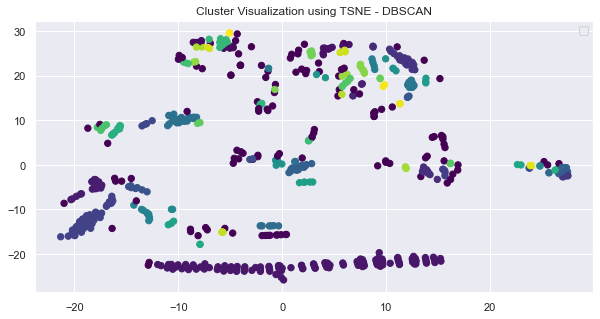

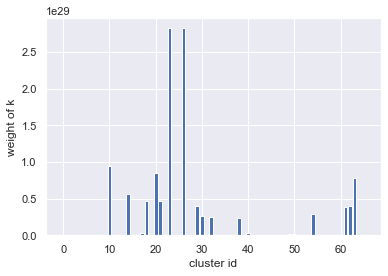

 96%|█████████████████████████████████████████▎ | 48/50 [02:30<00:07,  3.73s/it]

[ 6  6  6  6  6  6  6  6  6  6 23  6  6  6 16  6  6  7 15  6 22 15  6 57
  6  6 58  6  6 14 11  6 11  6  6  6  6  6 10  6  7  6  6  6  6  6  6  6
  6  7  6  6  6  6 12  6  6  6  6  6  6 13 14 21  6  6] 57
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

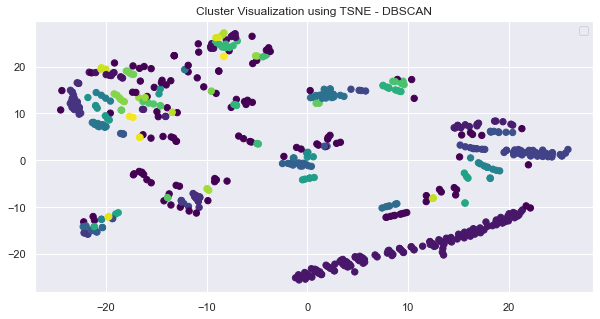

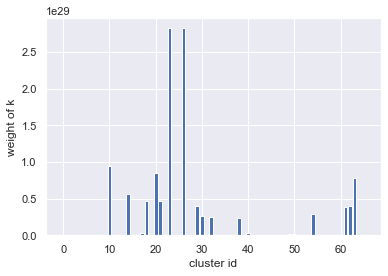

 98%|██████████████████████████████████████████▏| 49/50 [02:33<00:03,  3.47s/it]

[ 6  6  6  6  6  6  6  6  6  6 24  6  6  6 17  6  6  7 15  6 22 15  6 58
  6  6 59  6  6 14 11  6 11  6  6  6  6  6 11  6  7  6  6  6  6  6  6  6
  6  7  7  6  6  6 12  6  6  6  6  6  6 13 14 21  6  6] 58
noisy data count: 113


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

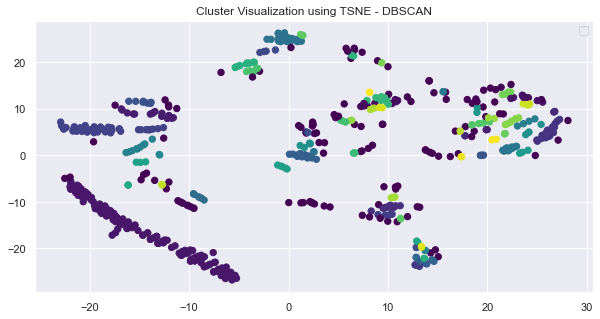

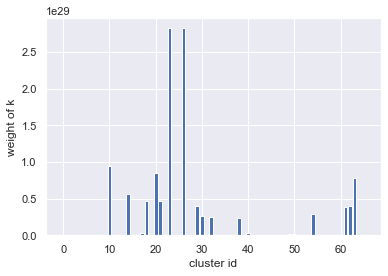

100%|███████████████████████████████████████████| 50/50 [02:36<00:00,  3.13s/it]

[ 6  6  6  6  6  6  6  6  6  6 24  6  6  6 17  6  6  7 15  6 22 15  6 59
  6  6 60  6  6 14 11  6 11  6  6  6  6  6 11  6  7  6  6  6  6  6  6  6
  6  7  7  6  6  6 12  6  6  6  6  6  6 14 14 21  6  6] 59


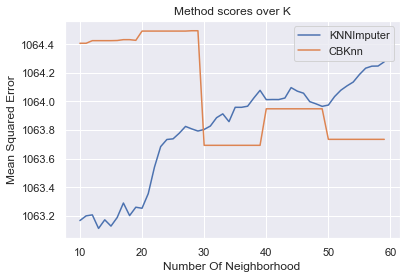

defaultdict(list,
            {'KNNImputer': [1063.1663591786219,
              1063.1992707738748,
              1063.206092839277,
              1063.111415451043,
              1063.1716233770458,
              1063.1276301109017,
              1063.1878452155977,
              1063.2890178047567,
              1063.201049427064,
              1063.2596900963647,
              1063.2524600626448,
              1063.3547176005507,
              1063.5398472917577,
              1063.683716001274,
              1063.733498152747,
              1063.738111340896,
              1063.777774214033,
              1063.824834178574,
              1063.8076897554276,
              1063.7925997718041,
              1063.8038221085849,
              1063.8275692175944,
              1063.8858815071073,
              1063.9127790065188,
              1063.8582428875895,
              1063.9585952790533,
              1063.9584586002973,
              1063.966260681458,
              1064.023812

In [76]:
density_based_knn(X, y_true, min_samples=2)

### Let's try with non uniform_nan - 80% nan given Embarked='C'(128/712)

In [77]:
df, y_true = load_titanic(nan_percentage=0.8, uniform_nan=False)
X = df.values
df.head()

S    554
C    130
Q     28
Name: Embarked, dtype: int64


,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked,Survived
0,0.908600,0.756138,-0.527470,0.522511,-0.506787,-0.516380,0.519588,-0.824163
1,-1.482983,-1.322511,NaN,0.522511,-0.506787,0.694046,-2.049487,1.213352
2,0.908600,-1.322511,-0.248458,-0.552714,-0.506787,-0.503620,0.519588,1.213352
3,-1.482983,-1.322511,0.379318,0.522511,-0.506787,0.350326,0.519588,1.213352
4,0.908600,0.756138,0.379318,-0.552714,-0.506787,-0.501257,0.519588,-0.824163


100%|███████████████████████████████████████████| 37/37 [00:03<00:00, 10.69it/s]


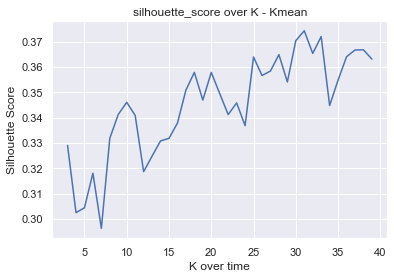

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

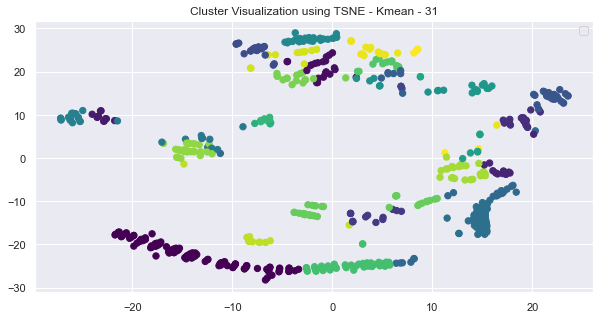

Kmean - 31, score: 0.37439112306907696


100%|███████████████████████████████████████████| 37/37 [00:03<00:00, 11.47it/s]


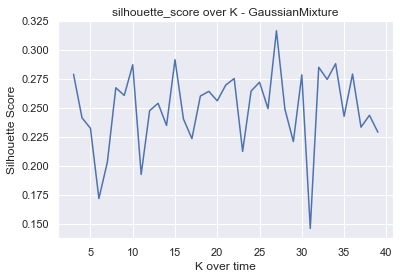

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

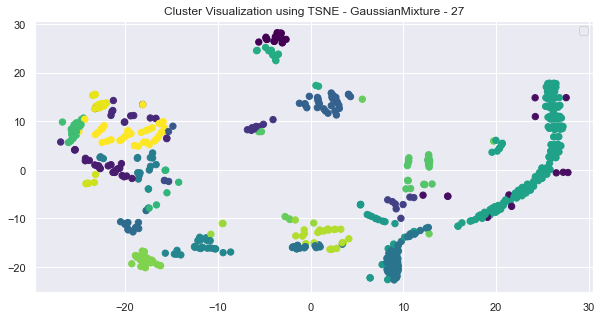

GaussianMixture - 27, score: 0.31651146965318017


100%|██████████████████████████████████████████| 37/37 [00:00<00:00, 106.29it/s]


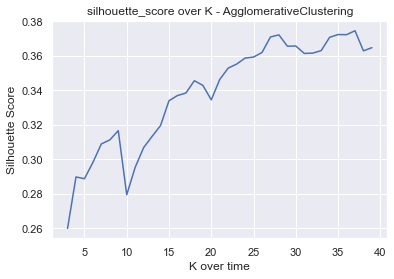

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

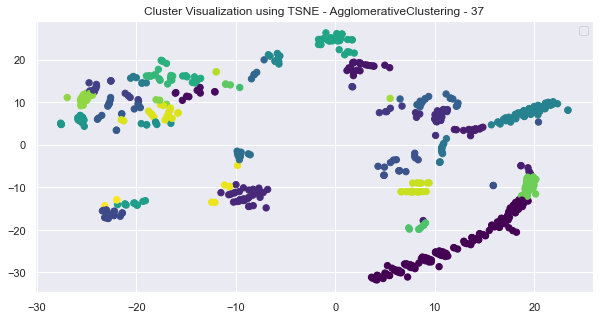

AgglomerativeClustering - 37, score: 0.37456962924819437


100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 35.83it/s]


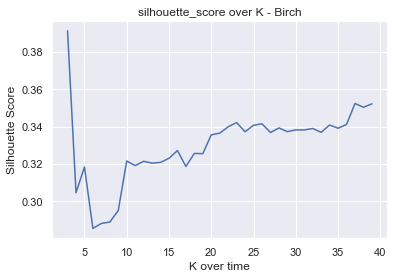

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

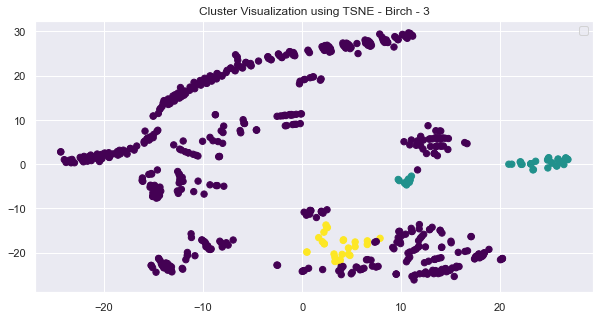

Birch - 3, score: 0.39128953140601824


100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 718.41it/s]


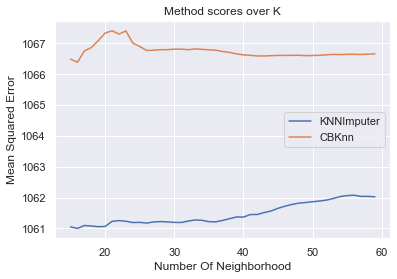

In [78]:
eval_methods_over_k(X, y_true)

noisy data count with eps=0.1: 333
noisy data count with eps=0.10990990990990991: 323
noisy data count with eps=0.11981981981981983: 319
noisy data count with eps=0.12972972972972974: 314
noisy data count with eps=0.13963963963963966: 290
noisy data count with eps=0.14954954954954958: 275
noisy data count with eps=0.15945945945945947: 271
noisy data count with eps=0.1693693693693694: 269
noisy data count with eps=0.17927927927927928: 267
noisy data count with eps=0.1891891891891892: 266
noisy data count with eps=0.19909909909909912: 266
noisy data count with eps=0.20900900900900904: 263
noisy data count with eps=0.21891891891891893: 237
noisy data count with eps=0.22882882882882885: 234
noisy data count with eps=0.23873873873873877: 228
noisy data count with eps=0.24864864864864866: 223
noisy data count with eps=0.2585585585585586: 221
noisy data count with eps=0.2684684684684685: 221
noisy data count with eps=0.2783783783783784: 221
noisy data count with eps=0.28828828828828834: 209
n

noisy data count with eps=1.8540540540540544: 10
noisy data count with eps=1.8639639639639642: 10
noisy data count with eps=1.8738738738738743: 10
noisy data count with eps=1.883783783783784: 10
noisy data count with eps=1.893693693693694: 10
noisy data count with eps=1.903603603603604: 10
noisy data count with eps=1.9135135135135137: 9
noisy data count with eps=1.9234234234234238: 9
noisy data count with eps=1.9333333333333336: 9
noisy data count with eps=1.9432432432432436: 9
noisy data count with eps=1.9531531531531534: 9
noisy data count with eps=1.9630630630630634: 9
noisy data count with eps=1.9729729729729732: 9
noisy data count with eps=1.9828828828828833: 9
noisy data count with eps=1.992792792792793: 9
noisy data count with eps=2.002702702702703: 9
noisy data count with eps=2.012612612612613: 9
noisy data count with eps=2.0225225225225225: 9
noisy data count with eps=2.0324324324324325: 9
noisy data count with eps=2.0423423423423426: 7
noisy data count with eps=2.052252252252

noisy data count with eps=3.6180180180180184: 1
noisy data count with eps=3.6279279279279284: 1
noisy data count with eps=3.6378378378378384: 1
noisy data count with eps=3.6477477477477485: 1
noisy data count with eps=3.657657657657658: 1
noisy data count with eps=3.667567567567568: 1
noisy data count with eps=3.677477477477478: 1
noisy data count with eps=3.6873873873873877: 1
noisy data count with eps=3.6972972972972977: 1
noisy data count with eps=3.7072072072072078: 1
noisy data count with eps=3.717117117117118: 1
noisy data count with eps=3.7270270270270274: 1
noisy data count with eps=3.7369369369369374: 1
noisy data count with eps=3.7468468468468474: 1
noisy data count with eps=3.7567567567567575: 1
noisy data count with eps=3.766666666666667: 1
noisy data count with eps=3.776576576576577: 1
noisy data count with eps=3.786486486486487: 1
noisy data count with eps=3.7963963963963967: 1
noisy data count with eps=3.8063063063063067: 1
noisy data count with eps=3.8162162162162168: 1

noisy data count with eps=5.4711711711711715: 0
noisy data count with eps=5.481081081081081: 0
noisy data count with eps=5.4909909909909915: 0
noisy data count with eps=5.500900900900901: 0
noisy data count with eps=5.510810810810811: 0
noisy data count with eps=5.520720720720721: 0
noisy data count with eps=5.530630630630631: 0
noisy data count with eps=5.540540540540541: 0
noisy data count with eps=5.550450450450451: 0
noisy data count with eps=5.56036036036036: 0
noisy data count with eps=5.570270270270271: 0
noisy data count with eps=5.5801801801801805: 0
noisy data count with eps=5.59009009009009: 0
noisy data count with eps=5.6000000000000005: 0
noisy data count with eps=5.60990990990991: 0
noisy data count with eps=5.61981981981982: 0
noisy data count with eps=5.62972972972973: 0
noisy data count with eps=5.63963963963964: 0
noisy data count with eps=5.64954954954955: 0
noisy data count with eps=5.65945945945946: 0
noisy data count with eps=5.669369369369369: 0
noisy data count 

noisy data count with eps=7.264864864864865: 0
noisy data count with eps=7.274774774774775: 0
noisy data count with eps=7.284684684684685: 0
noisy data count with eps=7.294594594594595: 0
noisy data count with eps=7.304504504504505: 0
noisy data count with eps=7.314414414414415: 0
noisy data count with eps=7.324324324324325: 0
noisy data count with eps=7.334234234234235: 0
noisy data count with eps=7.344144144144145: 0
noisy data count with eps=7.354054054054054: 0
noisy data count with eps=7.363963963963965: 0
noisy data count with eps=7.373873873873874: 0
noisy data count with eps=7.383783783783784: 0
noisy data count with eps=7.393693693693694: 0
noisy data count with eps=7.403603603603604: 0
noisy data count with eps=7.413513513513514: 0
noisy data count with eps=7.423423423423424: 0
noisy data count with eps=7.433333333333334: 0
noisy data count with eps=7.443243243243244: 0
noisy data count with eps=7.453153153153154: 0
noisy data count with eps=7.463063063063063: 0
noisy data co

noisy data count with eps=9.177477477477478: 0
noisy data count with eps=9.187387387387387: 0
noisy data count with eps=9.197297297297299: 0
noisy data count with eps=9.207207207207208: 0
noisy data count with eps=9.217117117117118: 0
noisy data count with eps=9.227027027027027: 0
noisy data count with eps=9.236936936936937: 0
noisy data count with eps=9.246846846846848: 0
noisy data count with eps=9.256756756756758: 0
noisy data count with eps=9.266666666666667: 0
noisy data count with eps=9.276576576576577: 0
noisy data count with eps=9.286486486486487: 0
noisy data count with eps=9.296396396396396: 0
noisy data count with eps=9.306306306306308: 0
noisy data count with eps=9.316216216216217: 0
noisy data count with eps=9.326126126126127: 0
noisy data count with eps=9.336036036036036: 0
noisy data count with eps=9.345945945945946: 0
noisy data count with eps=9.355855855855857: 0
noisy data count with eps=9.365765765765767: 0
noisy data count with eps=9.375675675675677: 0
noisy data co

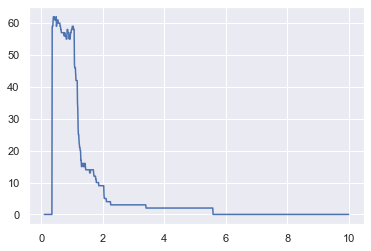

  0%|                                                    | 0/50 [00:00<?, ?it/s]/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


noisy data count: 167


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


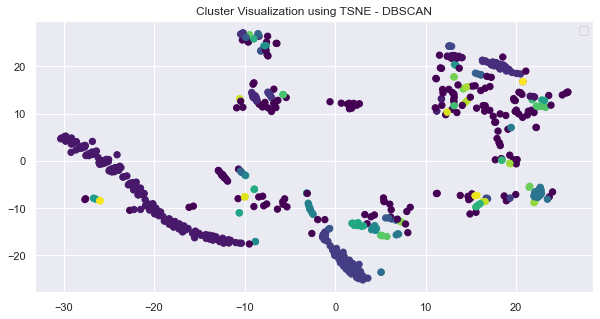

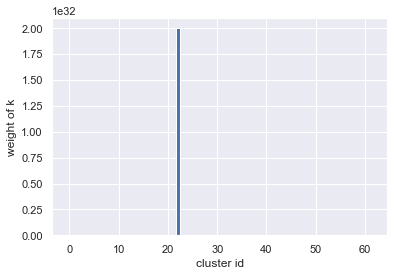

  2%|▉                                           | 1/50 [00:02<02:12,  2.70s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 11  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 10
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

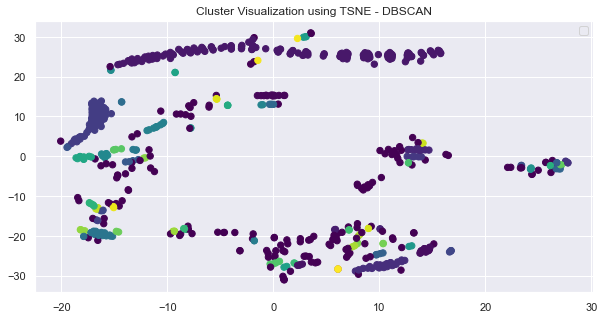

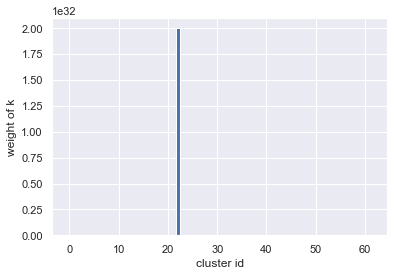

  4%|█▊                                          | 2/50 [00:06<02:44,  3.42s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 12  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 11
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

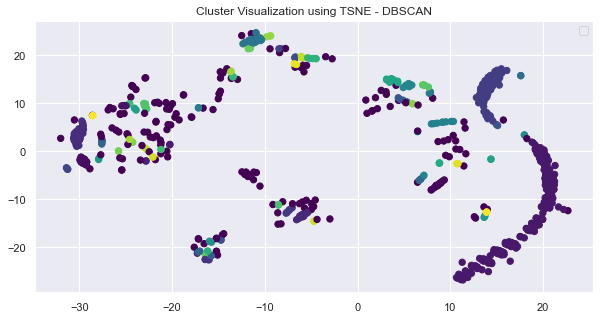

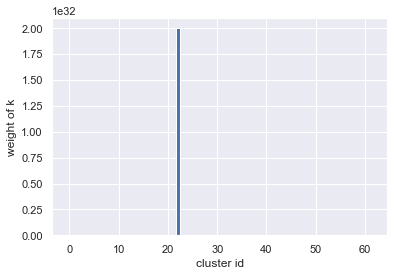

  6%|██▋                                         | 3/50 [00:11<03:21,  4.29s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 13  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 12
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

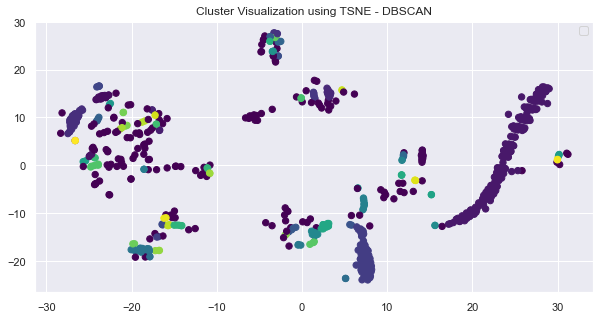

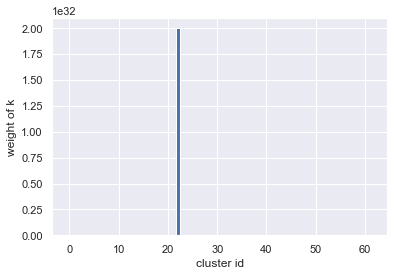

  8%|███▌                                        | 4/50 [00:15<03:12,  4.19s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 14  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 13
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

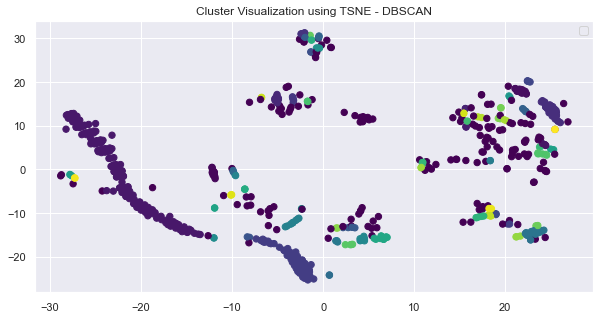

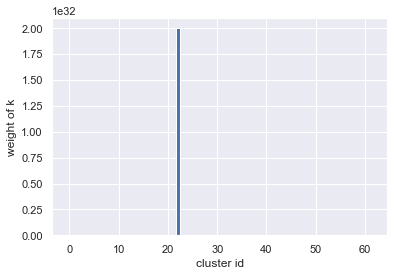

 10%|████▍                                       | 5/50 [00:19<02:49,  3.77s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 15  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 14
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

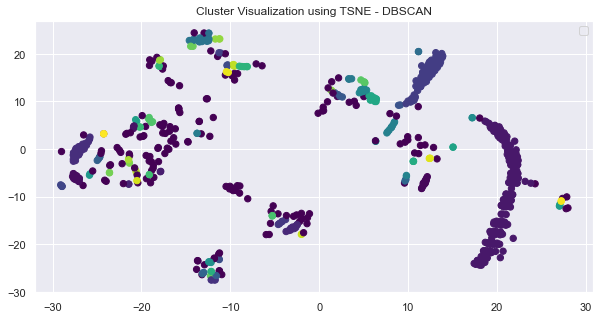

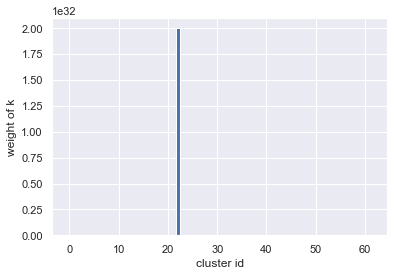

 12%|█████▎                                      | 6/50 [00:21<02:30,  3.43s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 16  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 15
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

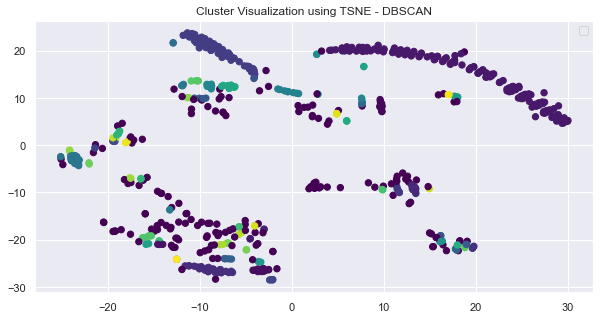

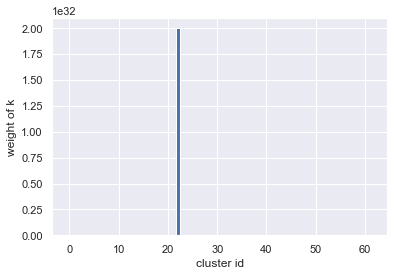

 14%|██████▏                                     | 7/50 [00:24<02:14,  3.12s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 17  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 16
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

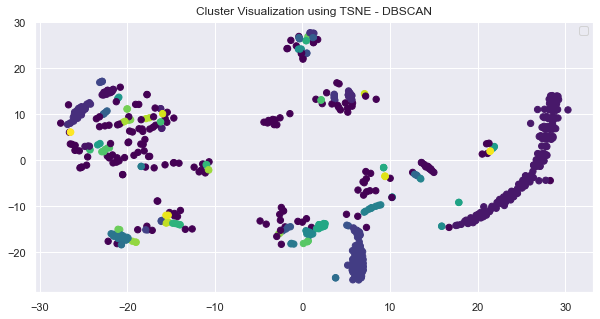

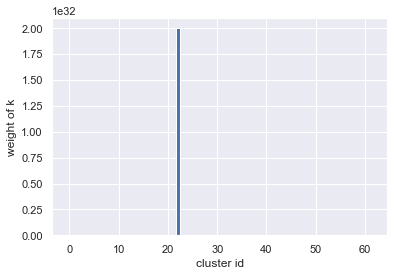

 16%|███████                                     | 8/50 [00:27<02:11,  3.13s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 18  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 17
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

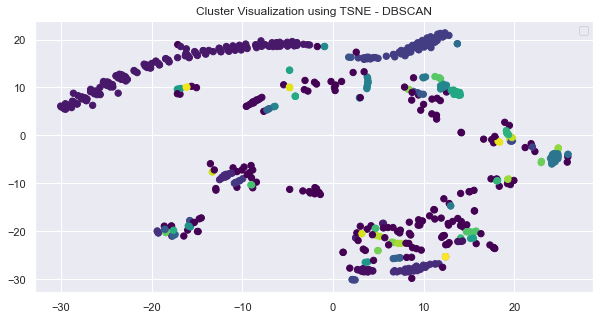

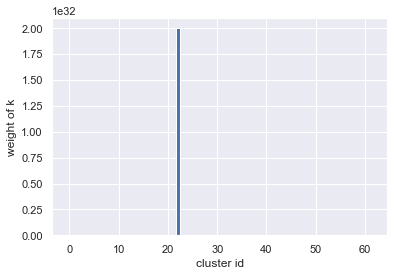

 18%|███████▉                                    | 9/50 [00:31<02:21,  3.45s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 19  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 18
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

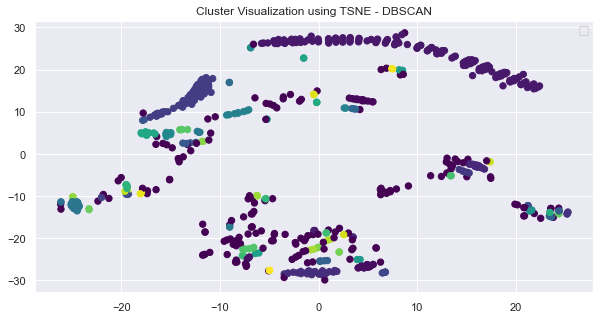

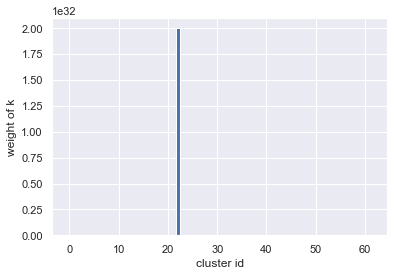

 20%|████████▌                                  | 10/50 [00:34<02:13,  3.33s/it]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 20  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2] 19
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

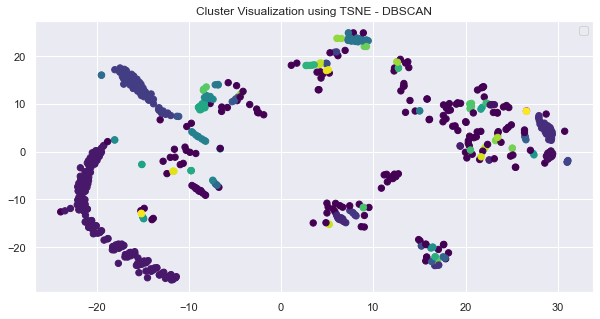

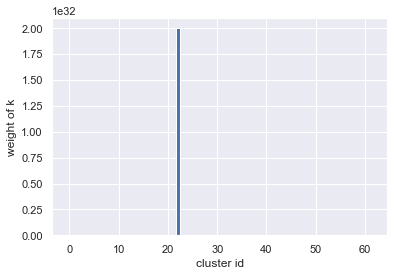

 22%|█████████▍                                 | 11/50 [00:38<02:12,  3.40s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 21  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 20
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

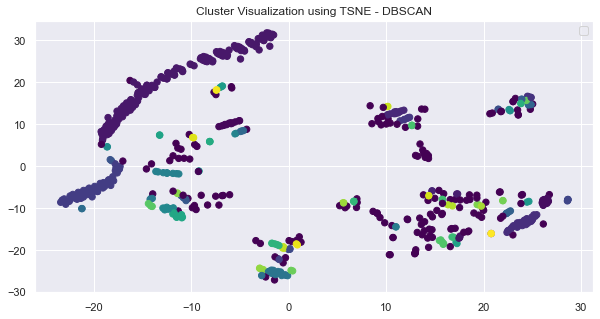

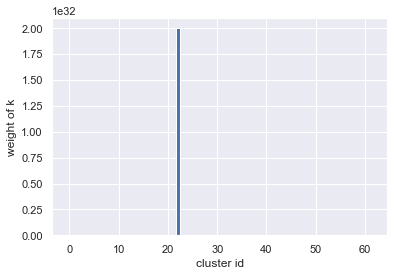

 24%|██████████▎                                | 12/50 [00:41<02:10,  3.43s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 22  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 21
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

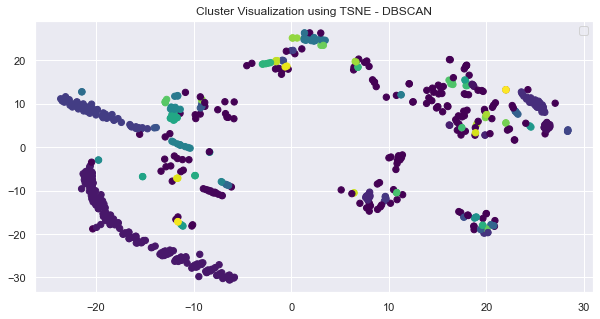

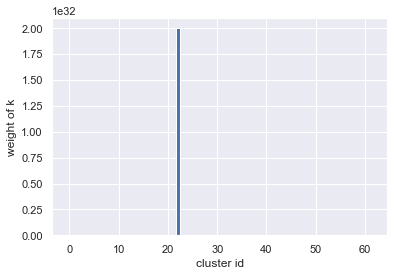

 26%|███████████▏                               | 13/50 [00:45<02:06,  3.43s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 23  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 22
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

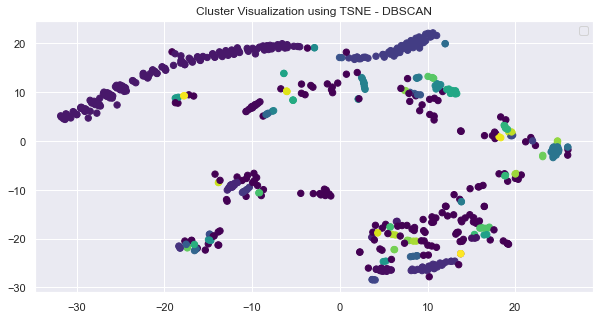

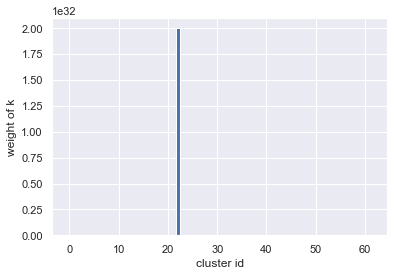

 28%|████████████                               | 14/50 [00:48<02:03,  3.44s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 24  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 23
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

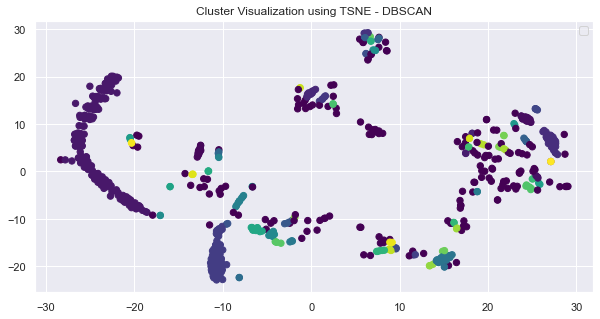

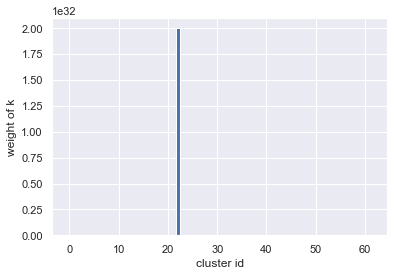

 30%|████████████▉                              | 15/50 [00:51<01:58,  3.39s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 25  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 24
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

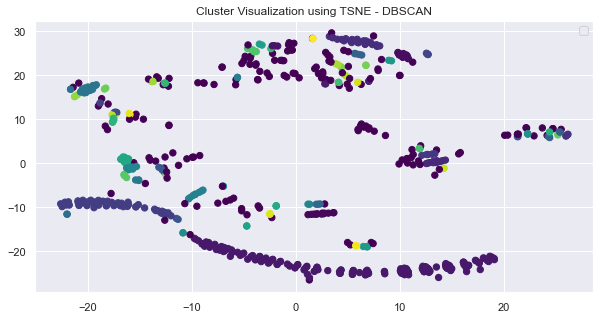

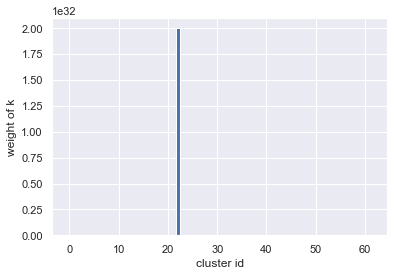

 32%|█████████████▊                             | 16/50 [00:55<01:53,  3.33s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 26  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 25
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

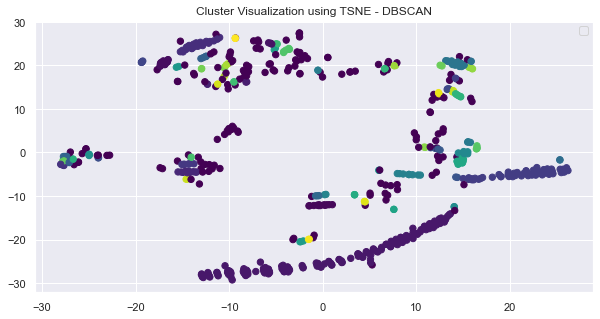

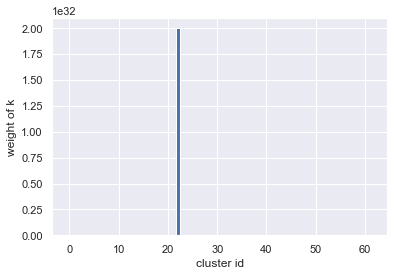

 34%|██████████████▌                            | 17/50 [00:58<01:47,  3.26s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 27  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 26
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

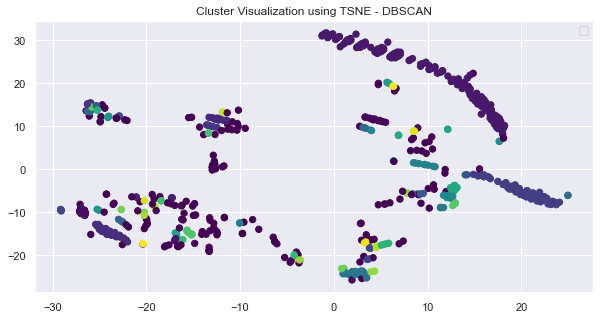

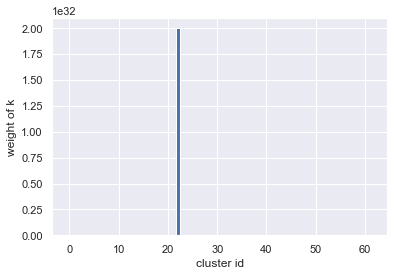

 36%|███████████████▍                           | 18/50 [01:01<01:43,  3.25s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 28  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 27
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

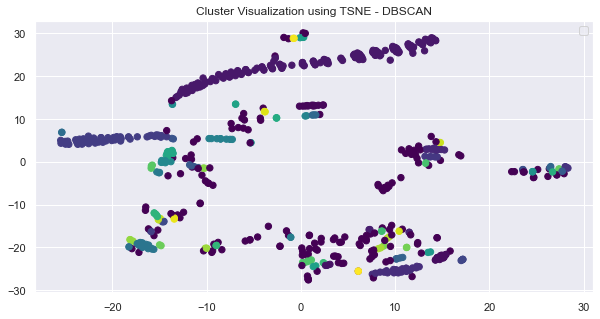

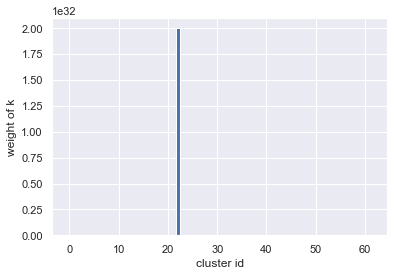

 38%|████████████████▎                          | 19/50 [01:04<01:41,  3.26s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 29  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 28
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

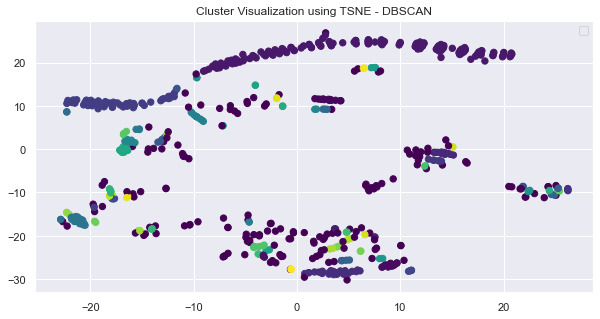

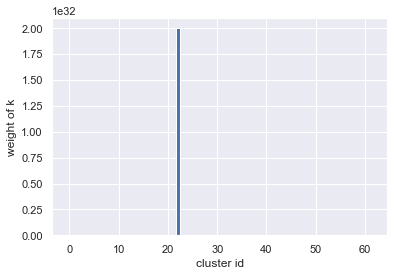

 40%|█████████████████▏                         | 20/50 [01:07<01:37,  3.24s/it]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 30  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3] 29
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

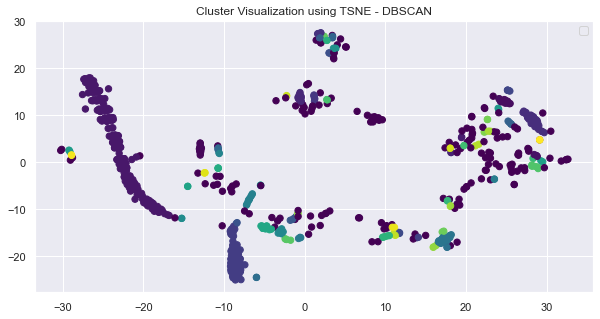

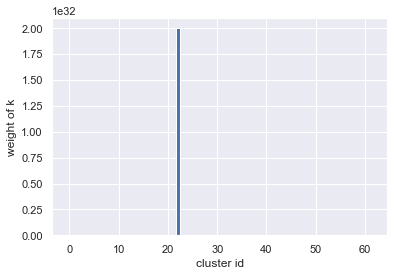

 42%|██████████████████                         | 21/50 [01:10<01:32,  3.20s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 31  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 30
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

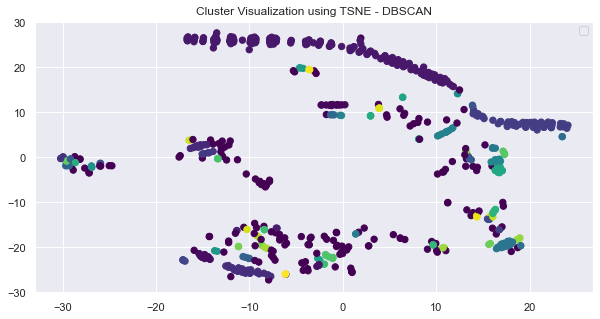

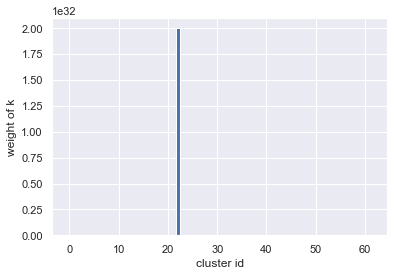

 44%|██████████████████▉                        | 22/50 [01:13<01:28,  3.15s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 32  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 31
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

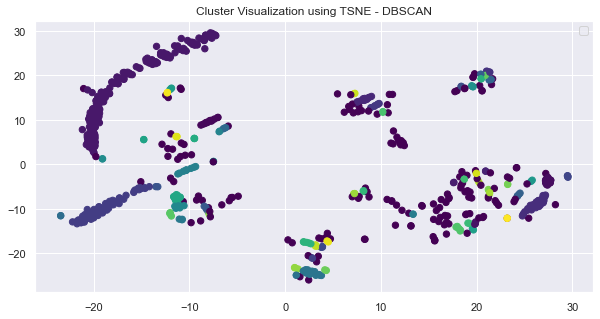

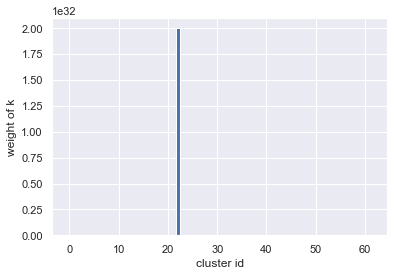

 46%|███████████████████▊                       | 23/50 [01:17<01:27,  3.22s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 33  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 32
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

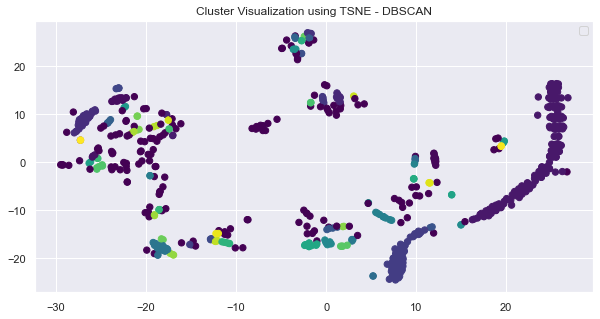

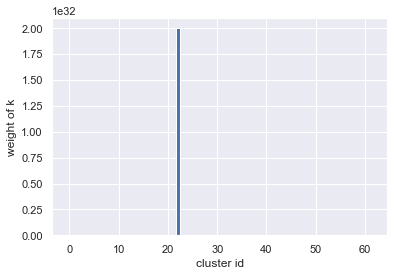

 48%|████████████████████▋                      | 24/50 [01:20<01:25,  3.29s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 33  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 33
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

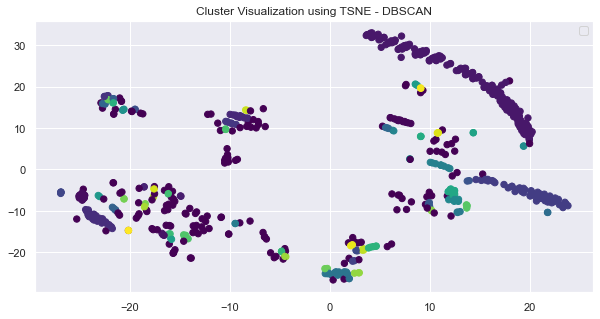

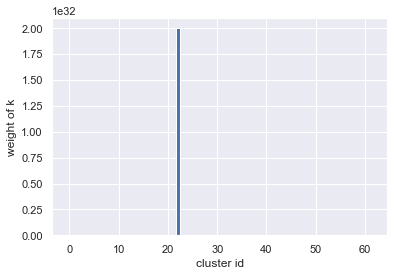

 50%|█████████████████████▌                     | 25/50 [01:23<01:19,  3.18s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 35  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 34
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

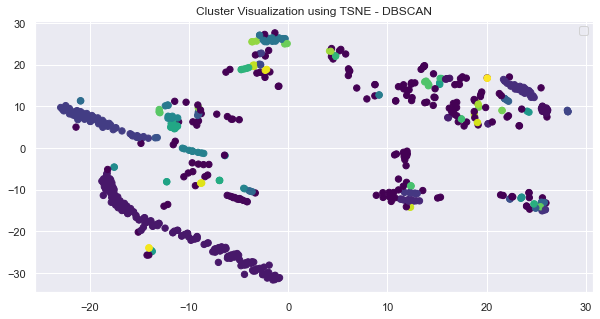

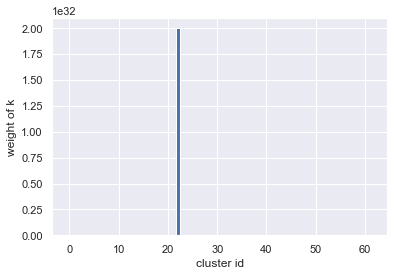

 52%|██████████████████████▎                    | 26/50 [01:27<01:17,  3.22s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 36  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 35
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

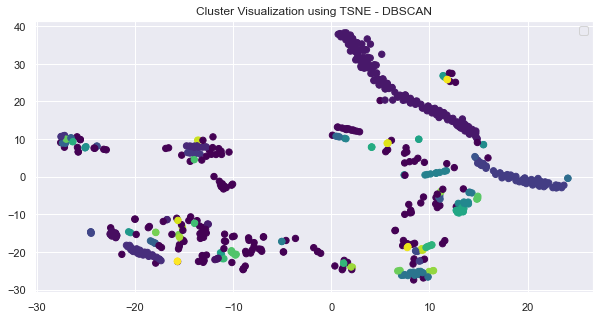

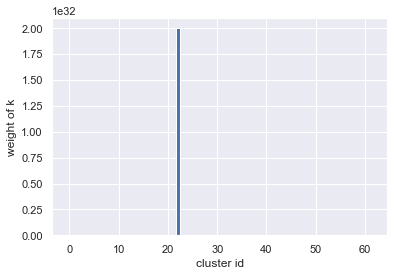

 54%|███████████████████████▏                   | 27/50 [01:30<01:15,  3.28s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 37  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 36
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

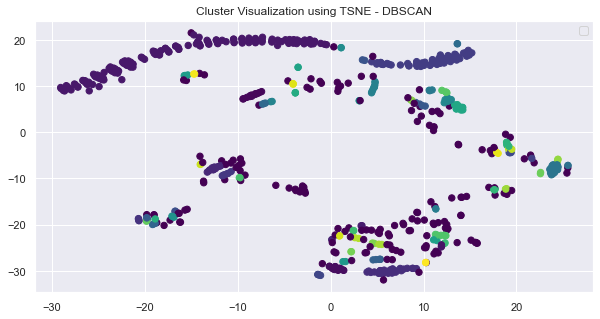

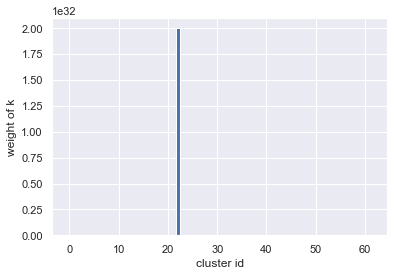

 56%|████████████████████████                   | 28/50 [01:33<01:12,  3.31s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 38  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 37
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

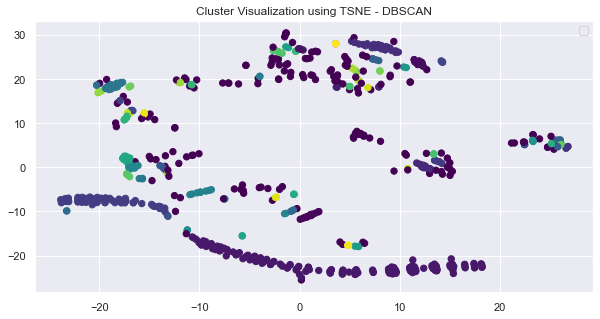

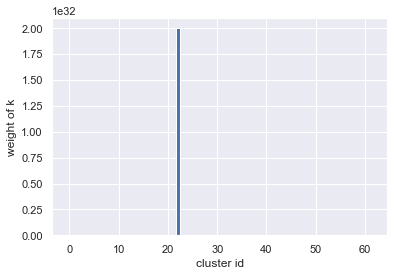

 58%|████████████████████████▉                  | 29/50 [01:37<01:14,  3.52s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 39  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 38
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

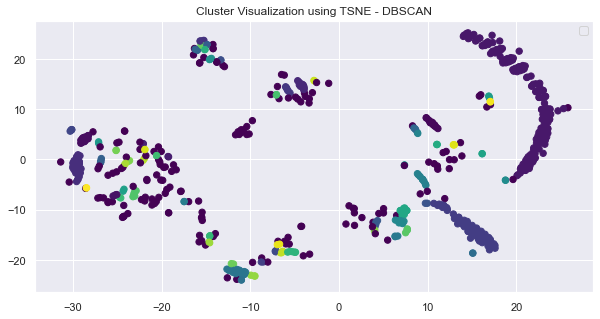

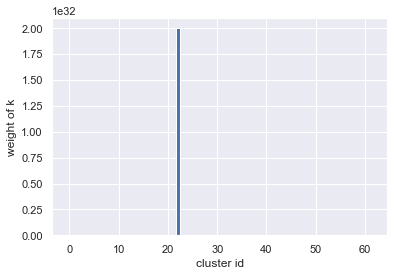

 60%|█████████████████████████▊                 | 30/50 [01:41<01:10,  3.52s/it]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 40  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4] 39
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

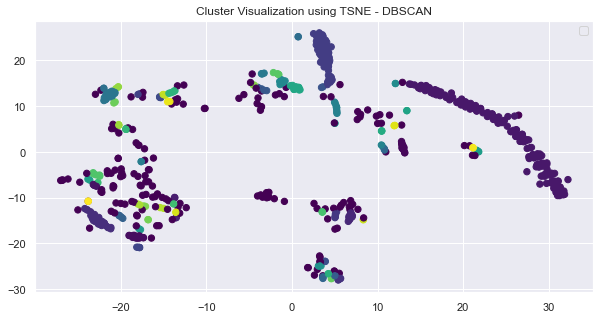

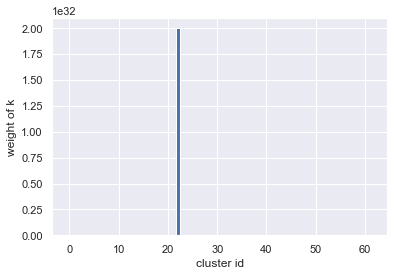

 62%|██████████████████████████▋                | 31/50 [01:45<01:07,  3.55s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 41  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 40
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

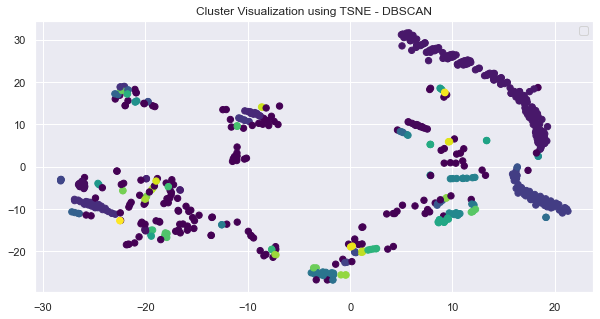

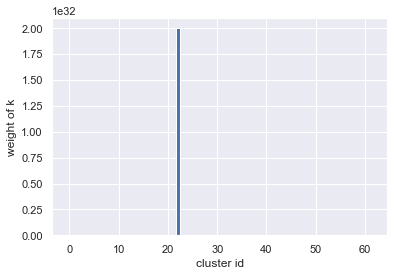

 64%|███████████████████████████▌               | 32/50 [01:48<01:04,  3.56s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 42  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 41
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

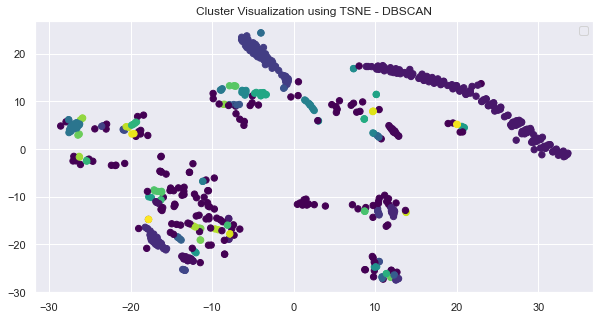

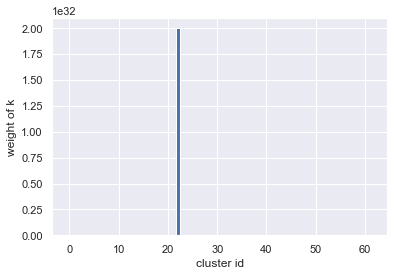

 66%|████████████████████████████▍              | 33/50 [01:52<01:01,  3.63s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 43  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 42
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

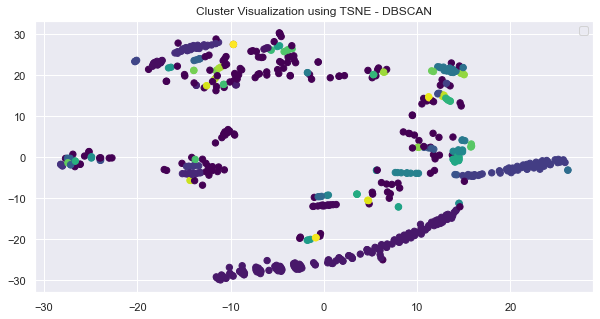

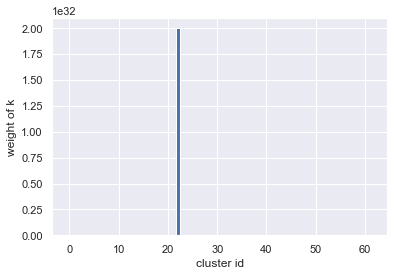

 68%|█████████████████████████████▏             | 34/50 [01:56<01:00,  3.76s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 44  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 43
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

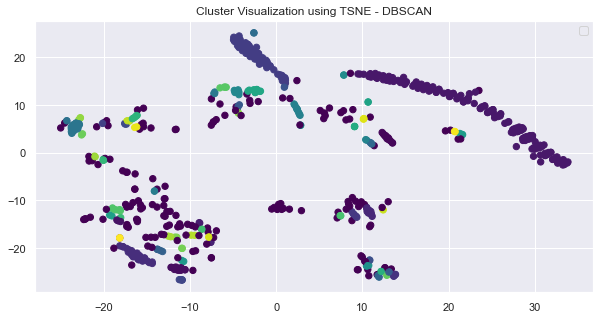

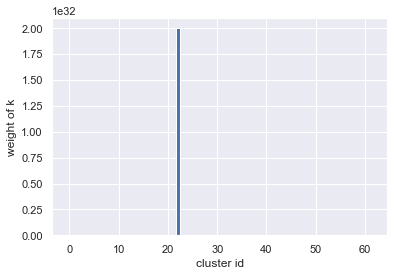

 70%|██████████████████████████████             | 35/50 [01:59<00:54,  3.64s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 45  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 44
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

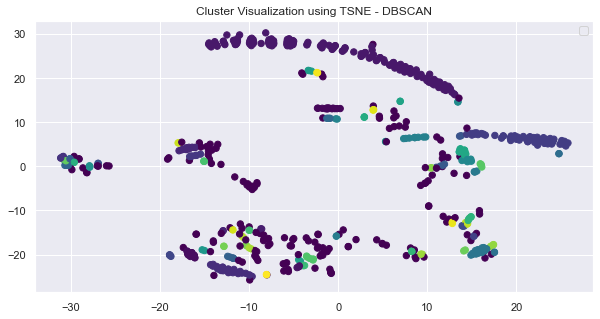

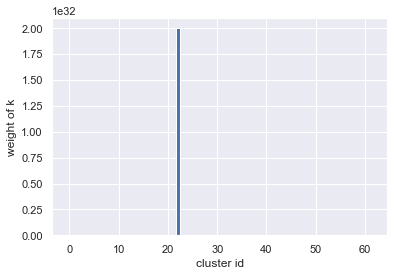

 72%|██████████████████████████████▉            | 36/50 [02:03<00:49,  3.50s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 46  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 45
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

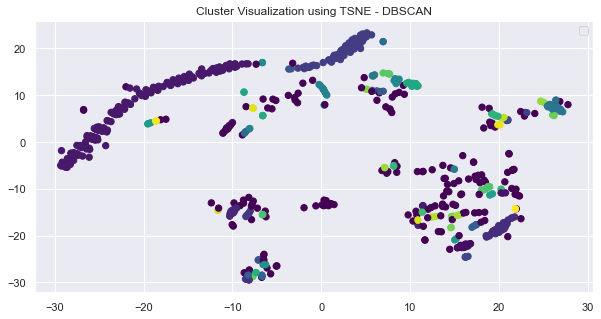

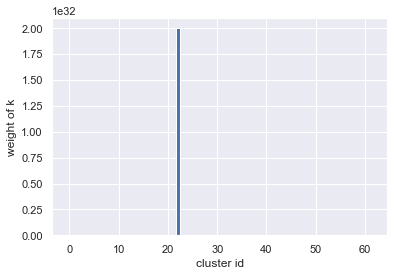

 74%|███████████████████████████████▊           | 37/50 [02:06<00:46,  3.54s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 47  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 46
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

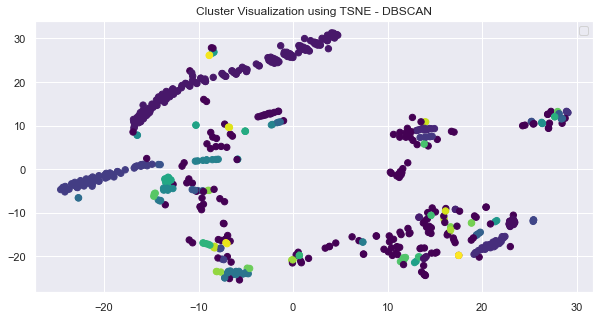

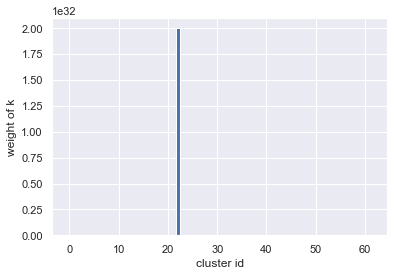

 76%|████████████████████████████████▋          | 38/50 [02:10<00:44,  3.74s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 48  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 47
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

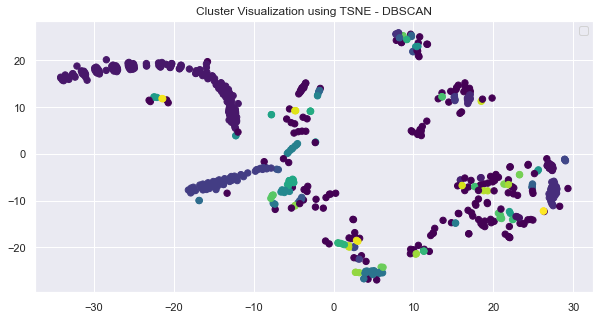

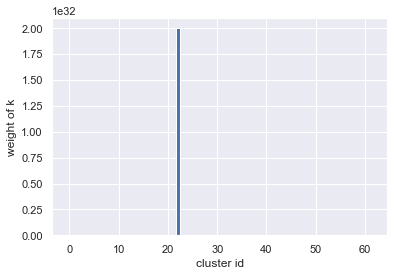

 78%|█████████████████████████████████▌         | 39/50 [02:14<00:40,  3.67s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 49  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 48
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

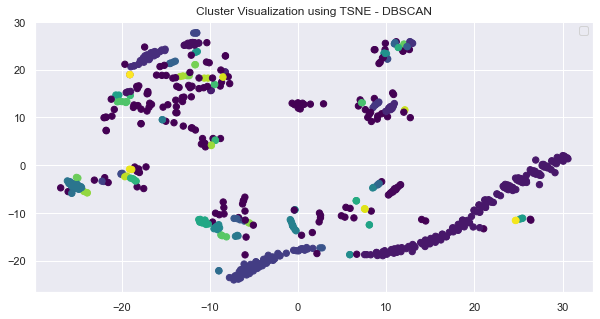

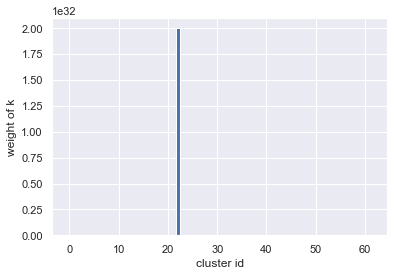

 80%|██████████████████████████████████▍        | 40/50 [02:17<00:35,  3.52s/it]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 50  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5] 49
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

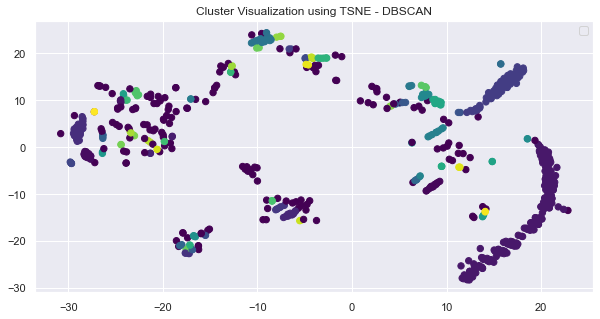

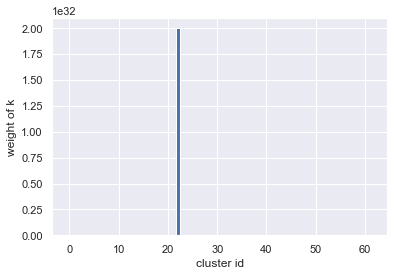

 82%|███████████████████████████████████▎       | 41/50 [02:20<00:30,  3.37s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 51  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 50
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

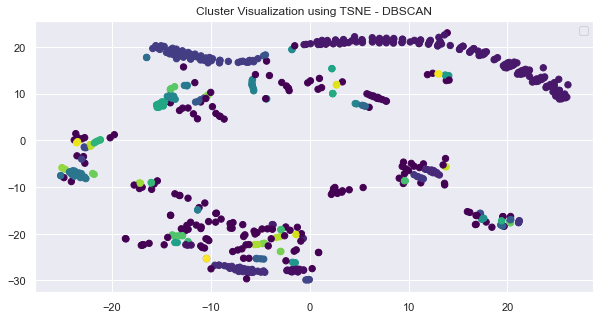

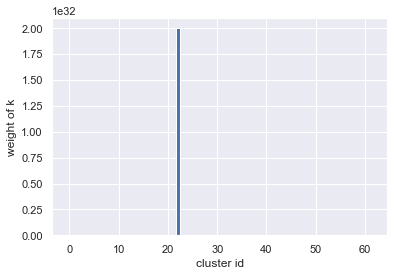

 84%|████████████████████████████████████       | 42/50 [02:24<00:27,  3.40s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 52  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 51
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

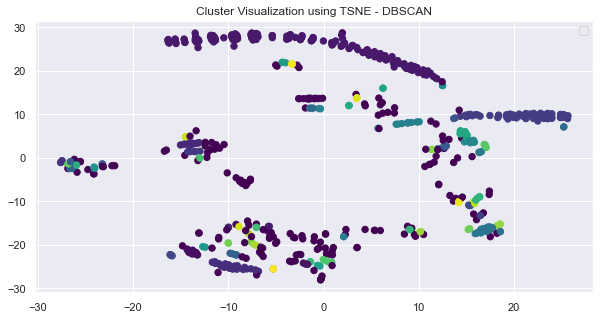

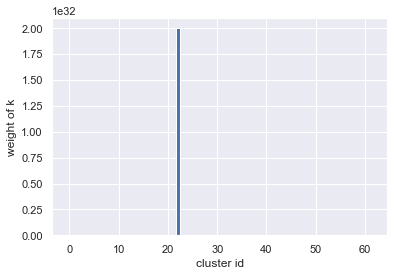

 86%|████████████████████████████████████▉      | 43/50 [02:27<00:24,  3.47s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 53  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 52
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

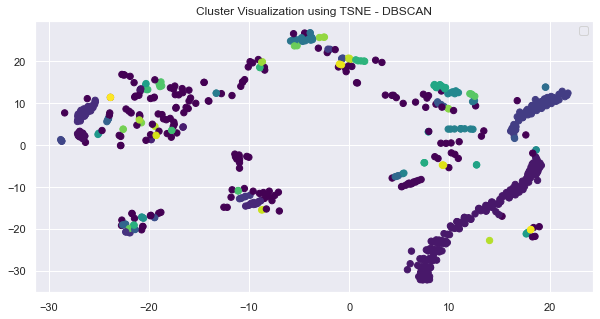

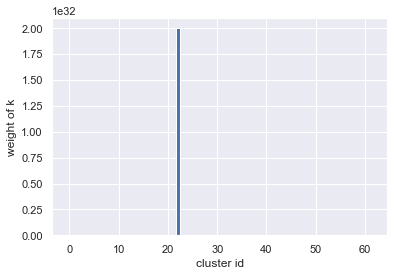

 88%|█████████████████████████████████████▊     | 44/50 [02:31<00:22,  3.71s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 54  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 53
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

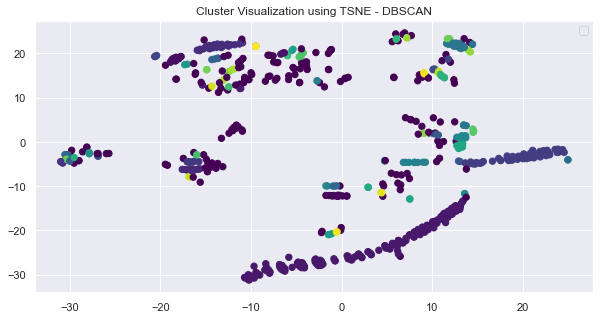

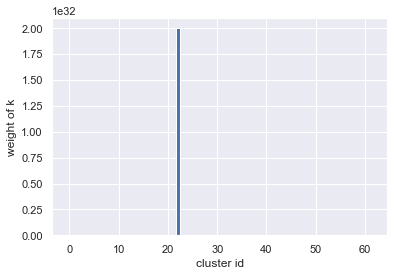

 90%|██████████████████████████████████████▋    | 45/50 [02:35<00:18,  3.62s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 55  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 54
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

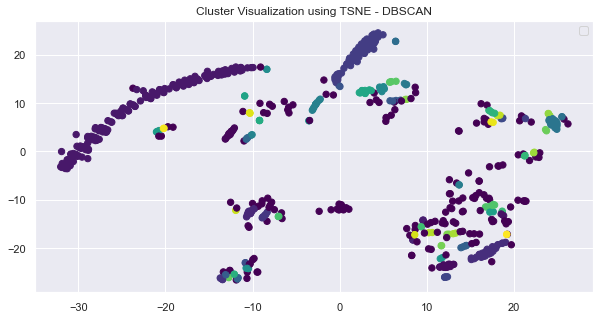

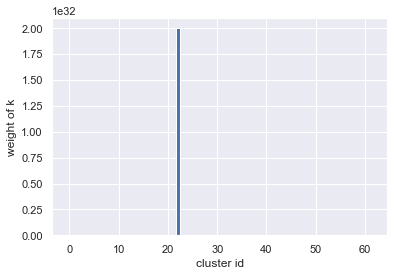

 92%|███████████████████████████████████████▌   | 46/50 [02:39<00:14,  3.65s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 56  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 55
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

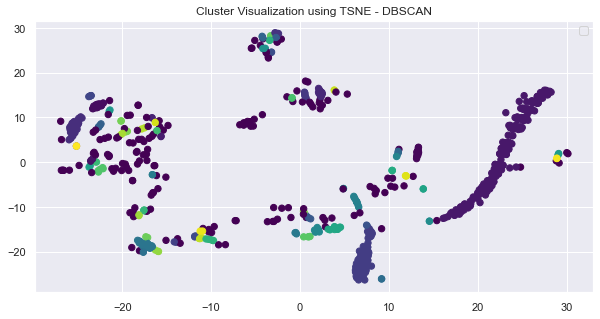

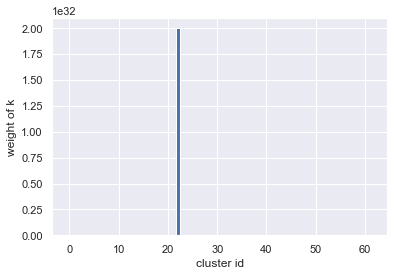

 94%|████████████████████████████████████████▍  | 47/50 [02:42<00:10,  3.65s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 57  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 56
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

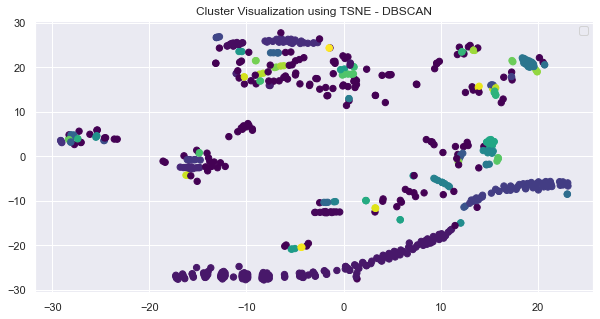

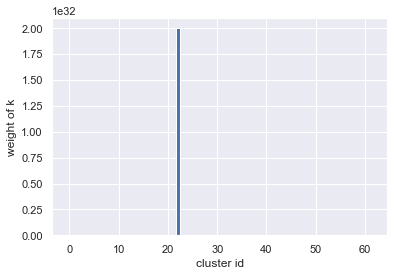

 96%|█████████████████████████████████████████▎ | 48/50 [02:46<00:07,  3.64s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 58  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 57
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

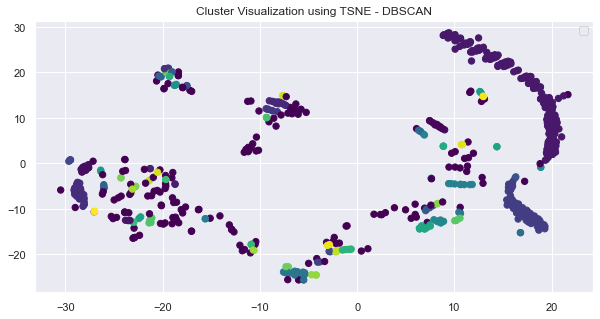

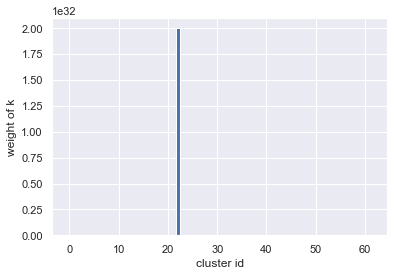

 98%|██████████████████████████████████████████▏| 49/50 [02:49<00:03,  3.61s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 59  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 58
noisy data count: 167


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

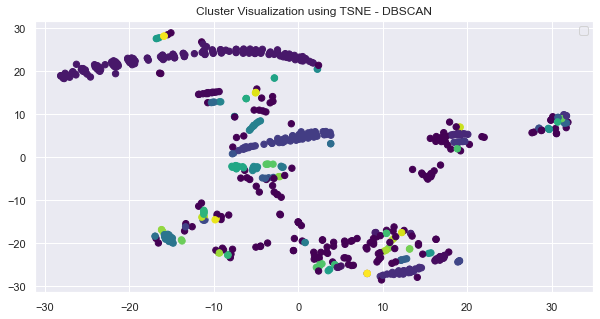

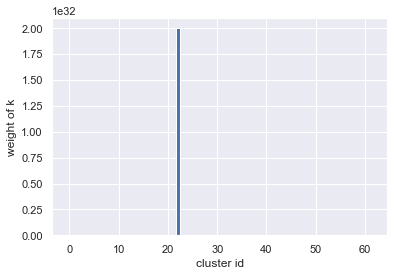

100%|███████████████████████████████████████████| 50/50 [02:53<00:00,  3.47s/it]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 59  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6] 59


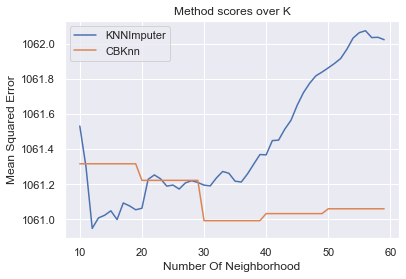

defaultdict(list,
            {'KNNImputer': [1061.5315214574305,
              1061.298344177253,
              1060.947946504019,
              1061.0076513446797,
              1061.0229638006379,
              1061.0482415931833,
              1060.9985378886076,
              1061.093029816081,
              1061.076562024602,
              1061.0542513145454,
              1061.0626960609368,
              1061.2276114711667,
              1061.2527677405046,
              1061.2307697259525,
              1061.1890419787276,
              1061.1950497884604,
              1061.1724049152956,
              1061.2074097530049,
              1061.2199283799275,
              1061.2099088638047,
              1061.1946230936958,
              1061.1903657605224,
              1061.2357362959824,
              1061.2725414398249,
              1061.2623023026142,
              1061.2172095788903,
              1061.21236393448,
              1061.2587033735122,
              1061.314

In [79]:
density_based_knn(X, y_true, min_samples=2)

### Let's try with more nan values(40%)

In [ ]:
df, y_true = load_titanic(nan_percentage=0.4, uniform_nan=True)
X = df.values
df.head()

In [ ]:
eval_methods_over_k(X, y_true)

In [ ]:
density_based_knn(X, y_true, min_samples=2)

## Load Mnist(digit) Dataset
feature at the middle of the image will be missing

In [80]:
df, y_true = load_mnist(nan_percentage=0.2)
X = df.values
df.head()

,0,1,2,3,4,5,6,7,8,9,...,54,55,56,57,58,59,60,61,62,63
0,0.0,-0.335016,-0.043081,0.274072,-0.664478,-0.844129,-0.409724,-0.125023,-0.059078,-0.624009,...,-0.757436,-0.209785,-0.023596,-0.299081,0.086719,0.208293,-0.366771,-1.146647,-0.505670,-0.196008
1,0.0,-0.335016,-1.094937,0.038648,0.268751,-0.138020,-0.409724,-0.125023,-0.059078,-0.624009,...,-0.757436,-0.209785,-0.023596,-0.299081,-1.089383,-0.249010,0.849632,0.548561,-0.505670,-0.196008
2,0.0,-0.335016,-1.094937,-1.844742,0.735366,1.097673,-0.409724,-0.125023,-0.059078,-0.624009,...,0.259230,-0.209785,-0.023596,-0.299081,-1.089383,-2.078218,-0.164037,1.565686,1.695137,-0.196008
3,0.0,-0.335016,0.377661,0.744919,0.268751,-0.844129,-0.409724,-0.125023,-0.059078,1.879691,...,1.072563,-0.209785,-0.023596,-0.299081,0.282736,0.208293,0.241430,0.379040,-0.505670,-0.196008
4,0.0,-0.335016,-1.094937,-2.551014,-0.197863,-1.020657,-0.409724,-0.125023,-0.059078,-0.624009,...,-0.757436,-0.209785,-0.023596,-0.299081,-1.089383,-2.306869,0.849632,-0.468564,-0.505670,-0.196008


100%|███████████████████████████████████████████| 37/37 [00:15<00:00,  2.38it/s]


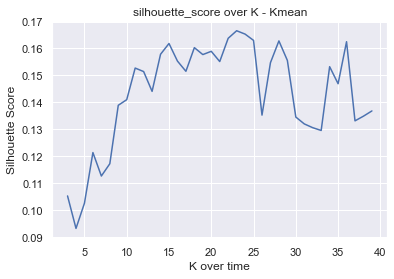

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

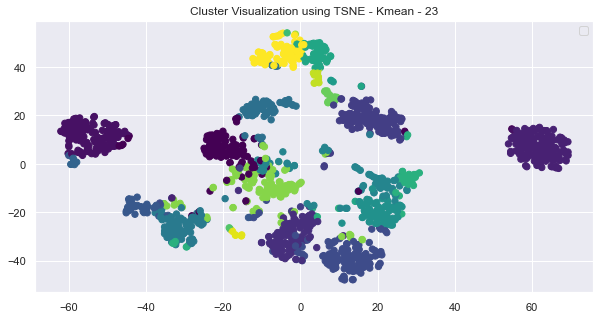

Kmean - 23, score: 0.16657948117537036


100%|███████████████████████████████████████████| 37/37 [00:44<00:00,  1.20s/it]


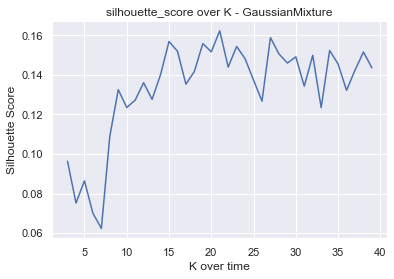

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

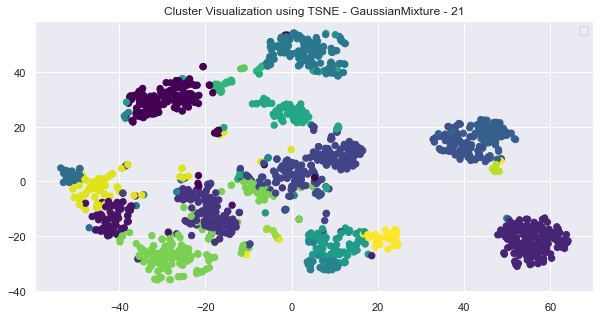

GaussianMixture - 21, score: 0.16224239022459655


100%|███████████████████████████████████████████| 37/37 [00:03<00:00, 12.29it/s]


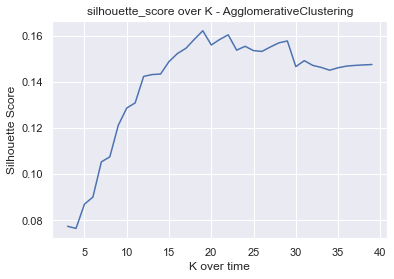

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

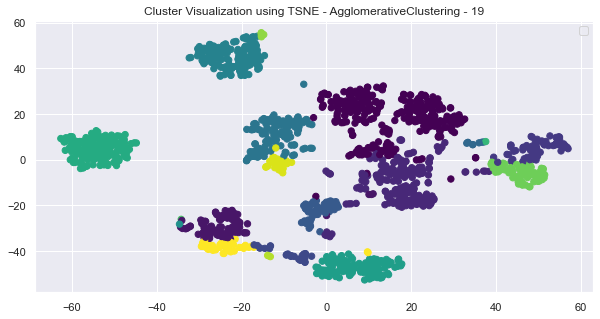

AgglomerativeClustering - 19, score: 0.16211030961950257


100%|███████████████████████████████████████████| 37/37 [00:05<00:00,  6.66it/s]


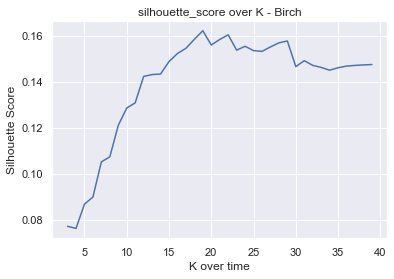

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

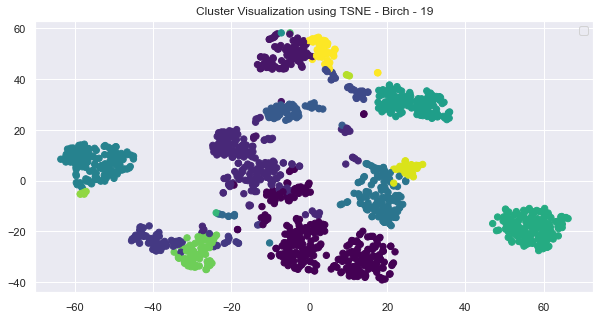

Birch - 19, score: 0.16211030961950257


100%|██████████████████████████████████████████| 23/23 [00:00<00:00, 778.74it/s]


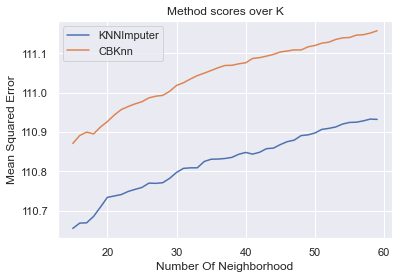

In [81]:
eval_methods_over_k(X, y_true)

noisy data count with eps=0.1: 1446
noisy data count with eps=0.10990990990990991: 1446
noisy data count with eps=0.11981981981981983: 1446
noisy data count with eps=0.12972972972972974: 1446
noisy data count with eps=0.13963963963963966: 1446
noisy data count with eps=0.14954954954954958: 1446
noisy data count with eps=0.15945945945945947: 1446
noisy data count with eps=0.1693693693693694: 1446
noisy data count with eps=0.17927927927927928: 1446
noisy data count with eps=0.1891891891891892: 1446
noisy data count with eps=0.19909909909909912: 1446
noisy data count with eps=0.20900900900900904: 1446
noisy data count with eps=0.21891891891891893: 1446
noisy data count with eps=0.22882882882882885: 1446
noisy data count with eps=0.23873873873873877: 1446
noisy data count with eps=0.24864864864864866: 1446
noisy data count with eps=0.2585585585585586: 1446
noisy data count with eps=0.2684684684684685: 1446
noisy data count with eps=0.2783783783783784: 1446
noisy data count with eps=0.28828

noisy data count with eps=1.794594594594595: 1437
noisy data count with eps=1.8045045045045047: 1437
noisy data count with eps=1.8144144144144148: 1435
noisy data count with eps=1.8243243243243246: 1435
noisy data count with eps=1.8342342342342346: 1434
noisy data count with eps=1.8441441441441444: 1433
noisy data count with eps=1.8540540540540544: 1433
noisy data count with eps=1.8639639639639642: 1433
noisy data count with eps=1.8738738738738743: 1433
noisy data count with eps=1.883783783783784: 1433
noisy data count with eps=1.893693693693694: 1432
noisy data count with eps=1.903603603603604: 1430
noisy data count with eps=1.9135135135135137: 1430
noisy data count with eps=1.9234234234234238: 1427
noisy data count with eps=1.9333333333333336: 1427
noisy data count with eps=1.9432432432432436: 1426
noisy data count with eps=1.9531531531531534: 1426
noisy data count with eps=1.9630630630630634: 1426
noisy data count with eps=1.9729729729729732: 1426
noisy data count with eps=1.9828828

noisy data count with eps=3.4099099099099104: 838
noisy data count with eps=3.4198198198198204: 832
noisy data count with eps=3.42972972972973: 823
noisy data count with eps=3.43963963963964: 811
noisy data count with eps=3.44954954954955: 804
noisy data count with eps=3.45945945945946: 800
noisy data count with eps=3.4693693693693697: 795
noisy data count with eps=3.4792792792792797: 788
noisy data count with eps=3.4891891891891897: 781
noisy data count with eps=3.4990990990990998: 774
noisy data count with eps=3.5090090090090094: 763
noisy data count with eps=3.5189189189189194: 751
noisy data count with eps=3.5288288288288294: 744
noisy data count with eps=3.538738738738739: 739
noisy data count with eps=3.548648648648649: 732
noisy data count with eps=3.558558558558559: 729
noisy data count with eps=3.568468468468469: 719
noisy data count with eps=3.5783783783783787: 715
noisy data count with eps=3.5882882882882887: 705
noisy data count with eps=3.5981981981981987: 693
noisy data c

noisy data count with eps=5.114414414414415: 111
noisy data count with eps=5.124324324324324: 105
noisy data count with eps=5.134234234234235: 105
noisy data count with eps=5.1441441441441444: 105
noisy data count with eps=5.154054054054054: 104
noisy data count with eps=5.1639639639639645: 102
noisy data count with eps=5.173873873873874: 101
noisy data count with eps=5.183783783783784: 100
noisy data count with eps=5.193693693693694: 98
noisy data count with eps=5.203603603603604: 97
noisy data count with eps=5.213513513513513: 96
noisy data count with eps=5.223423423423424: 96
noisy data count with eps=5.233333333333333: 95
noisy data count with eps=5.243243243243244: 94
noisy data count with eps=5.2531531531531535: 92
noisy data count with eps=5.263063063063063: 92
noisy data count with eps=5.2729729729729735: 92
noisy data count with eps=5.282882882882883: 90
noisy data count with eps=5.292792792792793: 89
noisy data count with eps=5.302702702702703: 89
noisy data count with eps=5.

noisy data count with eps=6.809009009009009: 27
noisy data count with eps=6.81891891891892: 27
noisy data count with eps=6.828828828828829: 27
noisy data count with eps=6.838738738738739: 27
noisy data count with eps=6.848648648648649: 27
noisy data count with eps=6.858558558558559: 26
noisy data count with eps=6.8684684684684685: 26
noisy data count with eps=6.878378378378379: 26
noisy data count with eps=6.8882882882882885: 26
noisy data count with eps=6.898198198198199: 26
noisy data count with eps=6.908108108108109: 26
noisy data count with eps=6.918018018018018: 26
noisy data count with eps=6.927927927927929: 25
noisy data count with eps=6.937837837837838: 25
noisy data count with eps=6.947747747747748: 25
noisy data count with eps=6.957657657657658: 25
noisy data count with eps=6.967567567567568: 25
noisy data count with eps=6.9774774774774775: 25
noisy data count with eps=6.987387387387388: 25
noisy data count with eps=6.9972972972972975: 25
noisy data count with eps=7.007207207

noisy data count with eps=8.513513513513514: 11
noisy data count with eps=8.523423423423424: 11
noisy data count with eps=8.533333333333333: 11
noisy data count with eps=8.543243243243245: 11
noisy data count with eps=8.553153153153154: 11
noisy data count with eps=8.563063063063064: 11
noisy data count with eps=8.572972972972973: 11
noisy data count with eps=8.582882882882883: 11
noisy data count with eps=8.592792792792794: 11
noisy data count with eps=8.602702702702704: 11
noisy data count with eps=8.612612612612613: 11
noisy data count with eps=8.622522522522523: 11
noisy data count with eps=8.632432432432433: 11
noisy data count with eps=8.642342342342342: 11
noisy data count with eps=8.652252252252254: 11
noisy data count with eps=8.662162162162163: 11
noisy data count with eps=8.672072072072073: 11
noisy data count with eps=8.681981981981982: 11
noisy data count with eps=8.691891891891892: 11
noisy data count with eps=8.701801801801803: 11
noisy data count with eps=8.711711711711

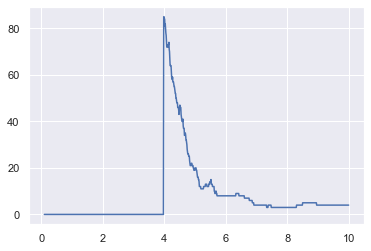

noisy data count: 433


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


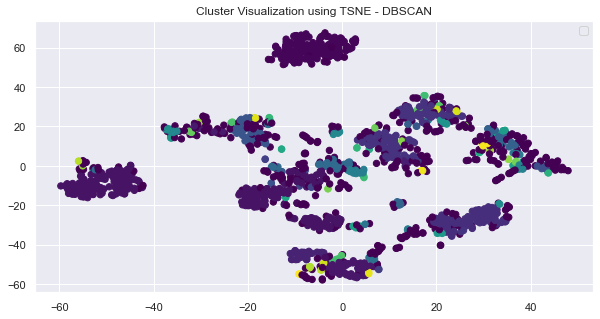

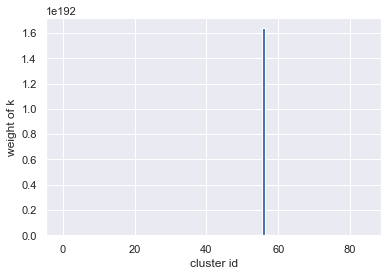

  2%|▉                                           | 1/50 [00:00<00:06,  7.11it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 11  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 10
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 12  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 11


  6%|██▋                                         | 3/50 [00:00<00:06,  7.48it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 13  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 12
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 14  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 13


 10%|████▍                                       | 5/50 [00:00<00:05,  7.73it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 15  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 14
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 16  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 15


 14%|██████▏                                     | 7/50 [00:00<00:05,  7.67it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 16  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 16
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 18  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 17


 18%|███████▉                                    | 9/50 [00:01<00:05,  7.67it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 19  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 18
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2 20  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2] 19


 24%|██████████▎                                | 12/50 [00:01<00:04,  7.90it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 21  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 20
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 22  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 21


 26%|███████████▏                               | 13/50 [00:01<00:04,  7.77it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 23  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 22
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 24  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 23


 30%|████████████▉                              | 15/50 [00:01<00:04,  7.71it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 25  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 24
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 25  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 25


 34%|██████████████▌                            | 17/50 [00:02<00:04,  7.70it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 27  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 26
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 28  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 27


 38%|████████████████▎                          | 19/50 [00:02<00:04,  7.37it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 29  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 28
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3 30  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3] 29


 42%|██████████████████                         | 21/50 [00:02<00:03,  7.33it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 31  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 30
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 32  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 31


 48%|████████████████████▋                      | 24/50 [00:03<00:03,  7.62it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 32  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 32
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 34  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 33


 50%|█████████████████████▌                     | 25/50 [00:03<00:03,  7.64it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 35  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 34
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 36  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 35


 54%|███████████████████████▏                   | 27/50 [00:03<00:02,  7.74it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 37  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 36
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 38  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 37


 58%|████████████████████████▉                  | 29/50 [00:03<00:02,  7.46it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 39  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 38
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 40  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4] 39


 62%|██████████████████████████▋                | 31/50 [00:04<00:02,  7.44it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 41  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 40
[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 42  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 41


 66%|████████████████████████████▍              | 33/50 [00:04<00:02,  7.49it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 43  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 42
[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 44  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 43


 70%|██████████████████████████████             | 35/50 [00:04<00:02,  7.34it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 45  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 44
[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 46  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 45


 74%|███████████████████████████████▊           | 37/50 [00:04<00:01,  7.42it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 47  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 46
[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 48  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 47


 78%|█████████████████████████████████▌         | 39/50 [00:05<00:01,  7.56it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 49  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 48
[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 50  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5] 49


 82%|███████████████████████████████████▎       | 41/50 [00:05<00:01,  7.64it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 50  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 50
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 52  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 51


 86%|████████████████████████████████████▉      | 43/50 [00:05<00:00,  7.80it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 53  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 52
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 54  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 53


 90%|██████████████████████████████████████▋    | 45/50 [00:05<00:00,  7.73it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 55  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 54
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 55  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 55


 94%|████████████████████████████████████████▍  | 47/50 [00:06<00:00,  7.65it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 57  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 56
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 58  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 57


 98%|██████████████████████████████████████████▏| 49/50 [00:06<00:00,  7.61it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 59  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 58
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6 59  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6] 59


100%|███████████████████████████████████████████| 50/50 [00:06<00:00,  7.60it/s]


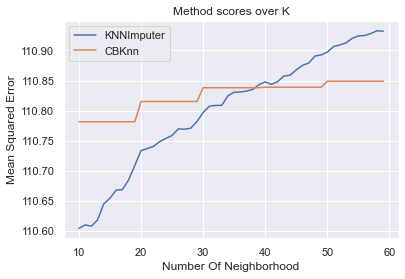

defaultdict(list,
            {'KNNImputer': [110.6041923940498,
              110.61011911432428,
              110.60783055036529,
              110.6182949547094,
              110.64508410034072,
              110.65440315265647,
              110.66792928075604,
              110.66859533080662,
              110.6848261398794,
              110.70876914914231,
              110.73346733801668,
              110.73698171417574,
              110.74057446558213,
              110.74845503008731,
              110.75379706696262,
              110.75875143337558,
              110.76970577131594,
              110.76912472239445,
              110.77077456456846,
              110.78187653106343,
              110.79695426995123,
              110.80728365374664,
              110.80860215514724,
              110.80875076656368,
              110.82480242827455,
              110.83058320544974,
              110.83099472240819,
              110.83243729558058,
              110.8

In [84]:
density_based_knn(X, y_true, min_samples=2)

### Let's try with more nan values (40%)

In [85]:
df, y_true = load_mnist(nan_percentage=0.4)
X = df.values
df.head()

,0,1,2,3,4,5,6,7,8,9,...,54,55,56,57,58,59,60,61,62,63
0,0.0,-0.335016,-0.043081,0.274072,-0.664478,-0.844129,-0.409724,-0.125023,-0.059078,-0.624009,...,-0.757436,-0.209785,-0.023596,-0.299081,0.086719,0.208293,-0.366771,-1.146647,-0.505670,-0.196008
1,0.0,-0.335016,-1.094937,0.038648,0.268751,-0.138020,-0.409724,-0.125023,-0.059078,-0.624009,...,-0.757436,-0.209785,-0.023596,-0.299081,-1.089383,-0.249010,0.849632,0.548561,-0.505670,-0.196008
2,0.0,-0.335016,-1.094937,-1.844742,0.735366,1.097673,-0.409724,-0.125023,-0.059078,-0.624009,...,0.259230,-0.209785,-0.023596,-0.299081,-1.089383,-2.078218,-0.164037,1.565686,1.695137,-0.196008
3,0.0,-0.335016,0.377661,0.744919,0.268751,-0.844129,-0.409724,-0.125023,-0.059078,1.879691,...,1.072563,-0.209785,-0.023596,-0.299081,0.282736,0.208293,0.241430,0.379040,-0.505670,-0.196008
4,0.0,-0.335016,-1.094937,-2.551014,-0.197863,-1.020657,-0.409724,-0.125023,-0.059078,-0.624009,...,-0.757436,-0.209785,-0.023596,-0.299081,-1.089383,-2.306869,0.849632,-0.468564,-0.505670,-0.196008


100%|███████████████████████████████████████████| 37/37 [00:13<00:00,  2.74it/s]


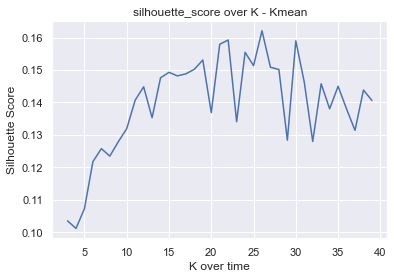

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

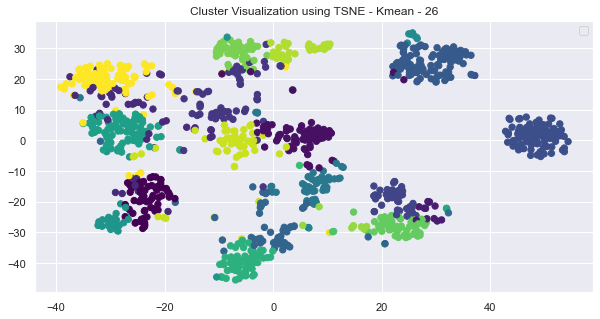

Kmean - 26, score: 0.16212047909509303


100%|███████████████████████████████████████████| 37/37 [00:21<00:00,  1.73it/s]


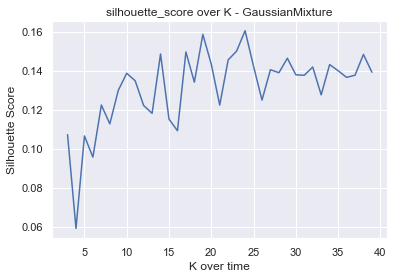

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

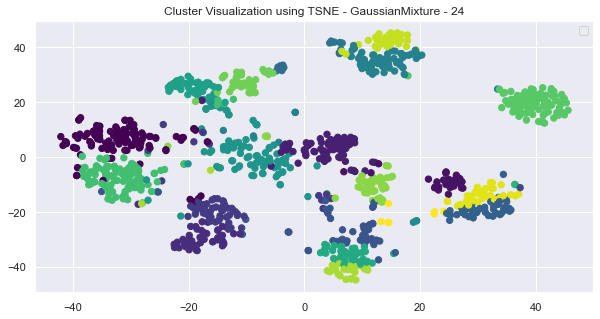

GaussianMixture - 24, score: 0.1604625459725018


100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 16.89it/s]


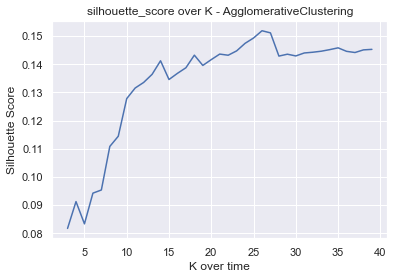

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

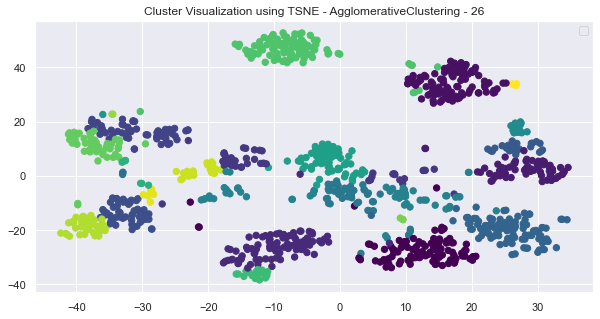

AgglomerativeClustering - 26, score: 0.15189100932718658


100%|███████████████████████████████████████████| 37/37 [00:04<00:00,  8.82it/s]


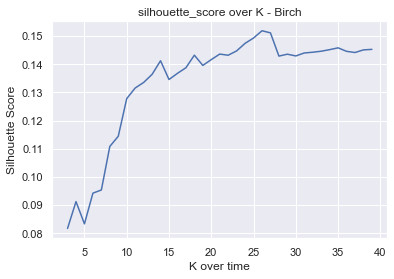

/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 432x288 with 0 Axes>

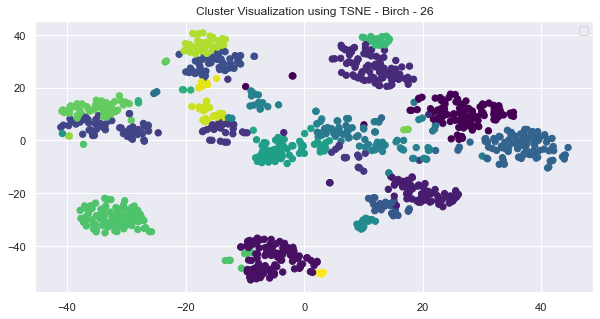

Birch - 26, score: 0.15189100932718658


100%|██████████████████████████████████████████| 26/26 [00:00<00:00, 675.73it/s]


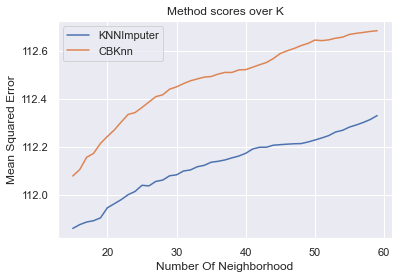

In [86]:
eval_methods_over_k(X, y_true)

noisy data count with eps=0.1: 1057
noisy data count with eps=0.10990990990990991: 1057
noisy data count with eps=0.11981981981981983: 1057
noisy data count with eps=0.12972972972972974: 1057
noisy data count with eps=0.13963963963963966: 1057
noisy data count with eps=0.14954954954954958: 1057
noisy data count with eps=0.15945945945945947: 1057
noisy data count with eps=0.1693693693693694: 1057
noisy data count with eps=0.17927927927927928: 1057
noisy data count with eps=0.1891891891891892: 1057
noisy data count with eps=0.19909909909909912: 1057
noisy data count with eps=0.20900900900900904: 1057
noisy data count with eps=0.21891891891891893: 1057
noisy data count with eps=0.22882882882882885: 1057
noisy data count with eps=0.23873873873873877: 1057
noisy data count with eps=0.24864864864864866: 1057
noisy data count with eps=0.2585585585585586: 1057
noisy data count with eps=0.2684684684684685: 1057
noisy data count with eps=0.2783783783783784: 1057
noisy data count with eps=0.28828

noisy data count with eps=1.9234234234234238: 1043
noisy data count with eps=1.9333333333333336: 1042
noisy data count with eps=1.9432432432432436: 1041
noisy data count with eps=1.9531531531531534: 1041
noisy data count with eps=1.9630630630630634: 1041
noisy data count with eps=1.9729729729729732: 1041
noisy data count with eps=1.9828828828828833: 1041
noisy data count with eps=1.992792792792793: 1039
noisy data count with eps=2.002702702702703: 1039
noisy data count with eps=2.012612612612613: 1039
noisy data count with eps=2.0225225225225225: 1039
noisy data count with eps=2.0324324324324325: 1039
noisy data count with eps=2.0423423423423426: 1039
noisy data count with eps=2.0522522522522526: 1039
noisy data count with eps=2.062162162162162: 1039
noisy data count with eps=2.0720720720720722: 1038
noisy data count with eps=2.0819819819819823: 1036
noisy data count with eps=2.0918918918918923: 1035
noisy data count with eps=2.1018018018018023: 1035
noisy data count with eps=2.1117117

noisy data count with eps=3.6180180180180184: 565
noisy data count with eps=3.6279279279279284: 560
noisy data count with eps=3.6378378378378384: 552
noisy data count with eps=3.6477477477477485: 545
noisy data count with eps=3.657657657657658: 539
noisy data count with eps=3.667567567567568: 536
noisy data count with eps=3.677477477477478: 530
noisy data count with eps=3.6873873873873877: 524
noisy data count with eps=3.6972972972972977: 521
noisy data count with eps=3.7072072072072078: 516
noisy data count with eps=3.717117117117118: 509
noisy data count with eps=3.7270270270270274: 504
noisy data count with eps=3.7369369369369374: 500
noisy data count with eps=3.7468468468468474: 499
noisy data count with eps=3.7567567567567575: 495
noisy data count with eps=3.766666666666667: 488
noisy data count with eps=3.776576576576577: 483
noisy data count with eps=3.786486486486487: 480
noisy data count with eps=3.7963963963963967: 475
noisy data count with eps=3.8063063063063067: 473
noisy d

noisy data count with eps=5.292792792792793: 79
noisy data count with eps=5.302702702702703: 77
noisy data count with eps=5.312612612612613: 77
noisy data count with eps=5.322522522522522: 77
noisy data count with eps=5.332432432432433: 76
noisy data count with eps=5.342342342342342: 73
noisy data count with eps=5.352252252252253: 71
noisy data count with eps=5.3621621621621625: 71
noisy data count with eps=5.372072072072072: 71
noisy data count with eps=5.3819819819819825: 71
noisy data count with eps=5.391891891891892: 71
noisy data count with eps=5.401801801801802: 70
noisy data count with eps=5.411711711711712: 70
noisy data count with eps=5.421621621621622: 69
noisy data count with eps=5.431531531531531: 69
noisy data count with eps=5.441441441441442: 69
noisy data count with eps=5.451351351351351: 67
noisy data count with eps=5.461261261261262: 66
noisy data count with eps=5.4711711711711715: 66
noisy data count with eps=5.481081081081081: 65
noisy data count with eps=5.490990990

noisy data count with eps=7.017117117117118: 21
noisy data count with eps=7.027027027027027: 21
noisy data count with eps=7.036936936936938: 21
noisy data count with eps=7.046846846846847: 21
noisy data count with eps=7.056756756756757: 21
noisy data count with eps=7.066666666666667: 21
noisy data count with eps=7.076576576576577: 21
noisy data count with eps=7.0864864864864865: 21
noisy data count with eps=7.096396396396397: 21
noisy data count with eps=7.1063063063063066: 21
noisy data count with eps=7.116216216216217: 21
noisy data count with eps=7.126126126126127: 21
noisy data count with eps=7.136036036036036: 21
noisy data count with eps=7.145945945945947: 21
noisy data count with eps=7.155855855855856: 21
noisy data count with eps=7.165765765765766: 21
noisy data count with eps=7.175675675675676: 21
noisy data count with eps=7.185585585585586: 21
noisy data count with eps=7.195495495495496: 21
noisy data count with eps=7.205405405405406: 21
noisy data count with eps=7.2153153153

noisy data count with eps=8.711711711711713: 10
noisy data count with eps=8.721621621621622: 10
noisy data count with eps=8.731531531531532: 10
noisy data count with eps=8.741441441441442: 9
noisy data count with eps=8.751351351351351: 9
noisy data count with eps=8.761261261261263: 9
noisy data count with eps=8.771171171171172: 9
noisy data count with eps=8.781081081081082: 9
noisy data count with eps=8.790990990990991: 9
noisy data count with eps=8.800900900900901: 9
noisy data count with eps=8.810810810810812: 9
noisy data count with eps=8.820720720720722: 9
noisy data count with eps=8.830630630630631: 9
noisy data count with eps=8.840540540540541: 9
noisy data count with eps=8.85045045045045: 9
noisy data count with eps=8.86036036036036: 9
noisy data count with eps=8.870270270270272: 9
noisy data count with eps=8.880180180180181: 9
noisy data count with eps=8.89009009009009: 9
noisy data count with eps=8.9: 9
noisy data count with eps=8.90990990990991: 9
noisy data count with eps=8.

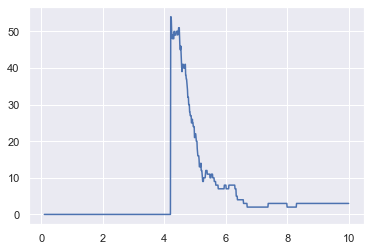

noisy data count: 315


/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


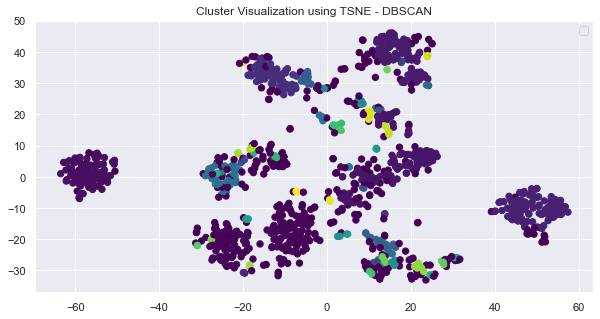

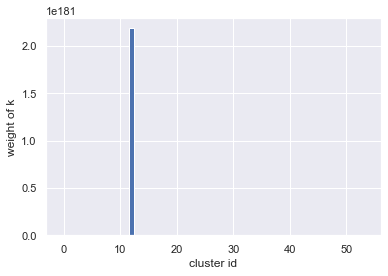

  2%|▉                                           | 1/50 [00:00<00:07,  6.74it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2 11  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 10
[ 2  2  2  2  2  2  2  2  2  2  2  2 12  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 11


  6%|██▋                                         | 3/50 [00:00<00:06,  6.91it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2 13  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 12
[ 2  2  2  2  2  2  2  2  2  2  2  2 14  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 13


 10%|████▍                                       | 5/50 [00:00<00:06,  6.86it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2 14  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 14
[ 2  2  2  2  2  2  2  2  2  2  2  2 16  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 15


 14%|██████▏                                     | 7/50 [00:01<00:06,  6.89it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2 17  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 16
[ 2  2  2  2  2  2  2  2  2  2  2  2 18  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 17


 20%|████████▌                                  | 10/50 [00:01<00:05,  6.92it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2 19  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 18
[ 2  2  2  2  2  2  2  2  2  2  2  2 20  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2] 19


 22%|█████████▍                                 | 11/50 [00:01<00:05,  6.69it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3 21  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 20
[ 3  3  3  3  3  3  3  3  3  3  3  3 22  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 21


 26%|███████████▏                               | 13/50 [00:01<00:05,  6.74it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3 23  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 22
[ 3  3  3  3  3  3  3  3  3  3  3  3 24  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 23


 30%|████████████▉                              | 15/50 [00:02<00:05,  6.71it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3 25  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 24
[ 3  3  3  3  3  3  3  3  3  3  3  3 26  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 25


 34%|██████████████▌                            | 17/50 [00:02<00:05,  6.51it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3 27  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 26
[ 3  3  3  3  3  3  3  3  3  3  3  3 27  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 27


 38%|████████████████▎                          | 19/50 [00:02<00:04,  6.30it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3 28  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 28
[ 3  3  3  3  3  3  3  3  3  3  3  3 30  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3  3  3  3  3] 29


 42%|██████████████████                         | 21/50 [00:03<00:04,  6.51it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4 31  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 30
[ 4  4  4  4  4  4  4  4  4  4  4  4 31  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 31


 46%|███████████████████▊                       | 23/50 [00:03<00:04,  6.56it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4 33  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 32
[ 4  4  4  4  4  4  4  4  4  4  4  4 34  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 33


 50%|█████████████████████▌                     | 25/50 [00:03<00:03,  6.62it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4 35  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 34
[ 4  4  4  4  4  4  4  4  4  4  4  4 36  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 35


 54%|███████████████████████▏                   | 27/50 [00:04<00:03,  6.48it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4 37  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 36
[ 4  4  4  4  4  4  4  4  4  4  4  4 38  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 37


 58%|████████████████████████▉                  | 29/50 [00:04<00:04,  5.16it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4 39  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 38
[ 4  4  4  4  4  4  4  4  4  4  4  4 40  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4] 39


 62%|██████████████████████████▋                | 31/50 [00:04<00:03,  5.22it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5 41  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 40
[ 5  5  5  5  5  5  5  5  5  5  5  5 42  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 41


 66%|████████████████████████████▍              | 33/50 [00:05<00:03,  5.51it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5 43  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 42
[ 5  5  5  5  5  5  5  5  5  5  5  5 44  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 43


 70%|██████████████████████████████             | 35/50 [00:05<00:02,  6.12it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5 45  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 44
[ 5  5  5  5  5  5  5  5  5  5  5  5 46  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 45


 74%|███████████████████████████████▊           | 37/50 [00:05<00:02,  6.43it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5 47  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 46
[ 5  5  5  5  5  5  5  5  5  5  5  5 48  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 47


 78%|█████████████████████████████████▌         | 39/50 [00:06<00:01,  6.65it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5 49  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 48
[ 5  5  5  5  5  5  5  5  5  5  5  5 50  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5] 49


 82%|███████████████████████████████████▎       | 41/50 [00:06<00:01,  6.49it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6 51  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 50
[ 6  6  6  6  6  6  6  6  6  6  6  6 52  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 51


 86%|████████████████████████████████████▉      | 43/50 [00:06<00:01,  6.62it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6 53  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 52
[ 6  6  6  6  6  6  6  6  6  6  6  6 54  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 53


 90%|██████████████████████████████████████▋    | 45/50 [00:07<00:00,  6.73it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6 54  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 54
[ 6  6  6  6  6  6  6  6  6  6  6  6 56  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 55


 94%|████████████████████████████████████████▍  | 47/50 [00:07<00:00,  6.81it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6 56  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 56
[ 6  6  6  6  6  6  6  6  6  6  6  6 58  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 57


 98%|██████████████████████████████████████████▏| 49/50 [00:07<00:00,  6.84it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6 59  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 58
[ 6  6  6  6  6  6  6  6  6  6  6  6 60  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6] 59


100%|███████████████████████████████████████████| 50/50 [00:07<00:00,  6.41it/s]


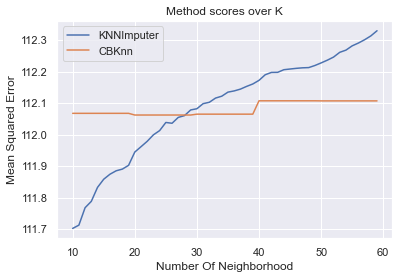

defaultdict(list,
            {'KNNImputer': [111.7022599813677,
              111.71263331631776,
              111.7680043174862,
              111.7881434121453,
              111.83251836075817,
              111.85845129081815,
              111.87426037040125,
              111.8852108008225,
              111.89055858633085,
              111.90251825011471,
              111.94466128977618,
              111.96163459733064,
              111.97879933961421,
              111.99936121785936,
              112.01280598496227,
              112.03863509973894,
              112.03612070164401,
              112.05472535493695,
              112.06035549819713,
              112.07839344835689,
              112.0822217708985,
              112.09833721168242,
              112.10267852112906,
              112.11605376297615,
              112.1220144117102,
              112.13494346349621,
              112.13879989234755,
              112.1444743691258,
              112.15312

In [87]:
density_based_knn(X, y_true, min_samples=2)

## Load Iris Dataset

In [39]:
df, y_true = load_iris_dataset(nan_percentage=0.2)
X = df.values
df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,-0.900681,1.019004,-1.340227,-1.288756,-1.224745
1,-1.143017,-0.131979,-1.340227,-1.288756,-1.224745
2,-1.385353,0.328414,-1.397064,-1.288756,-1.224745
3,-1.506521,0.098217,-1.283389,-1.288756,-1.224745
4,-1.021849,1.249201,-1.340227,-1.288756,-1.224745


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:02<00:00, 14.89it/s]


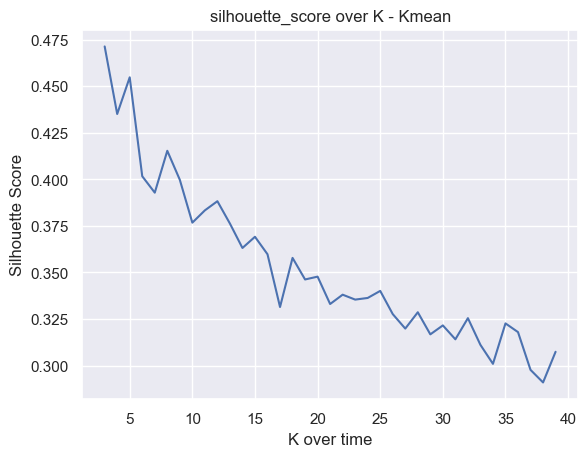

/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 640x480 with 0 Axes>

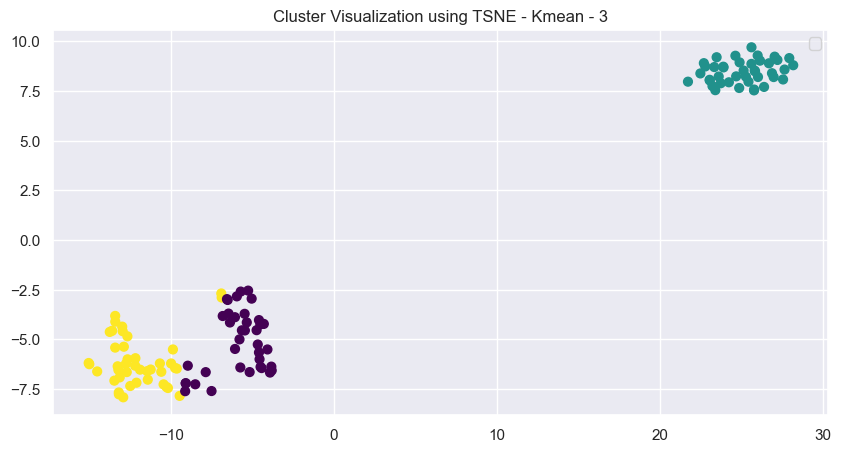

Kmean - 3, score: 0.47131159289386576


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:10<00:00,  3.66it/s]


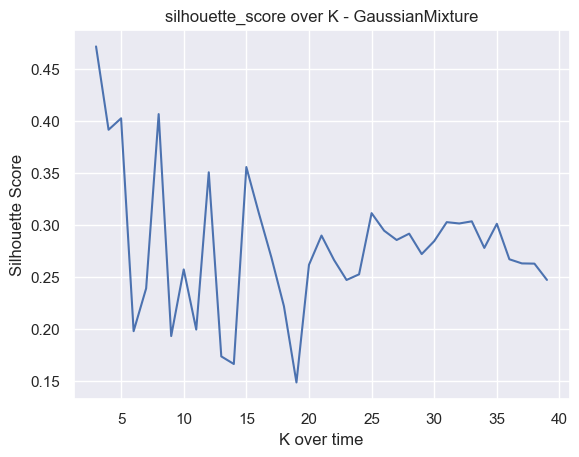

/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 640x480 with 0 Axes>

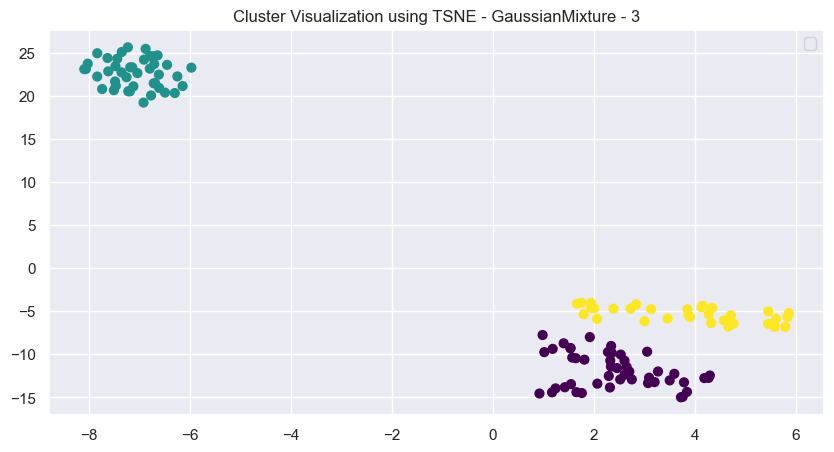

GaussianMixture - 3, score: 0.4714621723092454


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 387.22it/s]


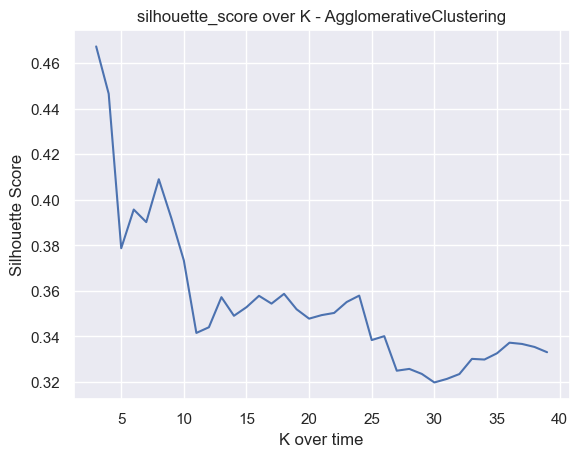

/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 640x480 with 0 Axes>

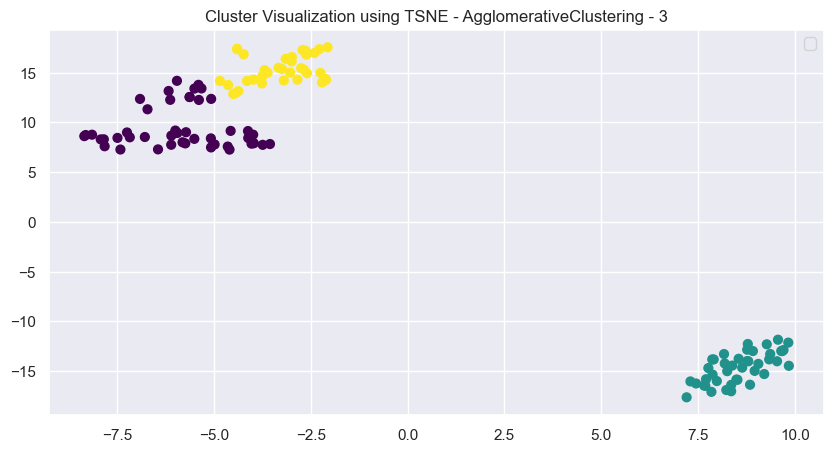

AgglomerativeClustering - 3, score: 0.46728508908359145


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 26/37 [00:00<00:00, 127.03it/s]/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/cluster/_birch.py:752: ConvergenceWarning: Number of subclusters found (28) by BIRCH is less than (29). Decrease the threshold.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/cluster/_birch.py:752: ConvergenceWarning: Number of subclusters found (28) by BIRCH is less than (30). Decrease the threshold.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/cluster/_birch.py:752: ConvergenceWarning: Number of subclusters found (28) by BIRCH is less than (31). Decrease the threshold.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/cluster/_birch.py:752: ConvergenceWarning: Number of subclusters found (28) by BIRCH is

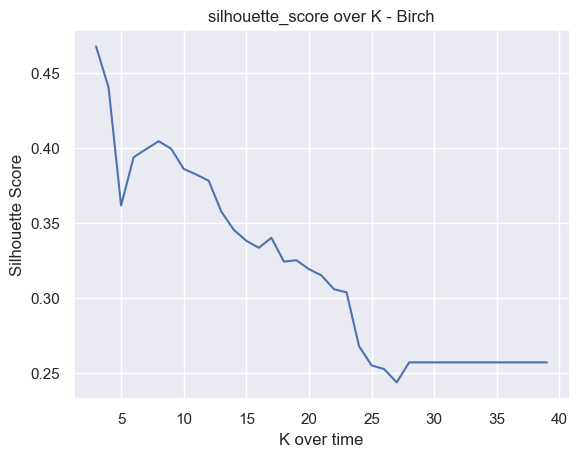

/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 640x480 with 0 Axes>

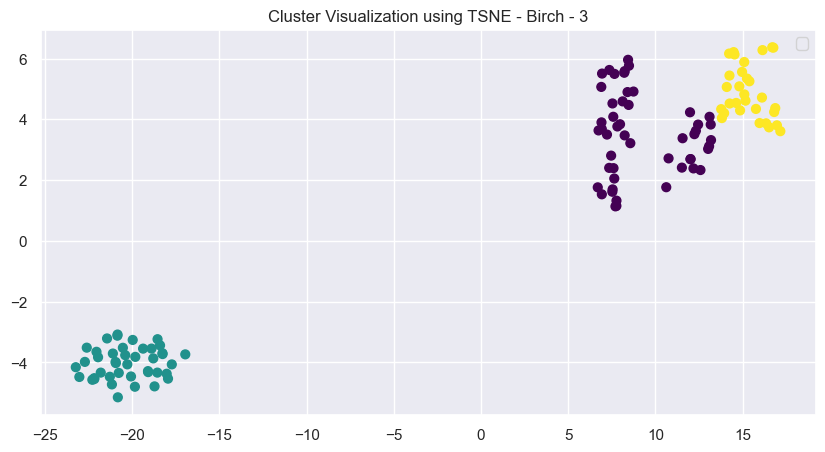

Birch - 3, score: 0.4677750864767627


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1451.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1185.28it/s]


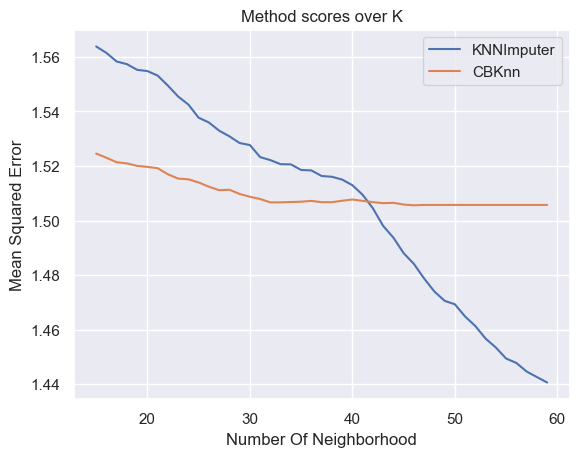

In [42]:
eval_methods_over_k(X, y_true)

noisy data count with eps=0.1: 120
noisy data count with eps=0.10990990990990991: 120
noisy data count with eps=0.11981981981981983: 120
noisy data count with eps=0.12972972972972974: 114
noisy data count with eps=0.13963963963963966: 105
noisy data count with eps=0.14954954954954958: 105
noisy data count with eps=0.15945945945945947: 105
noisy data count with eps=0.1693693693693694: 101
noisy data count with eps=0.17927927927927928: 95
noisy data count with eps=0.1891891891891892: 93
noisy data count with eps=0.19909909909909912: 93
noisy data count with eps=0.20900900900900904: 89
noisy data count with eps=0.21891891891891893: 86
noisy data count with eps=0.22882882882882885: 86
noisy data count with eps=0.23873873873873877: 84
noisy data count with eps=0.24864864864864866: 82
noisy data count with eps=0.2585585585585586: 79
noisy data count with eps=0.2684684684684685: 68
noisy data count with eps=0.2783783783783784: 66
noisy data count with eps=0.28828828828828834: 64
noisy data co

noisy data count with eps=1.7846846846846849: 0
noisy data count with eps=1.794594594594595: 0
noisy data count with eps=1.8045045045045047: 0
noisy data count with eps=1.8144144144144148: 0
noisy data count with eps=1.8243243243243246: 0
noisy data count with eps=1.8342342342342346: 0
noisy data count with eps=1.8441441441441444: 0
noisy data count with eps=1.8540540540540544: 0
noisy data count with eps=1.8639639639639642: 0
noisy data count with eps=1.8738738738738743: 0
noisy data count with eps=1.883783783783784: 0
noisy data count with eps=1.893693693693694: 0
noisy data count with eps=1.903603603603604: 0
noisy data count with eps=1.9135135135135137: 0
noisy data count with eps=1.9234234234234238: 0
noisy data count with eps=1.9333333333333336: 0
noisy data count with eps=1.9432432432432436: 0
noisy data count with eps=1.9531531531531534: 0
noisy data count with eps=1.9630630630630634: 0
noisy data count with eps=1.9729729729729732: 0
noisy data count with eps=1.9828828828828833

noisy data count with eps=5.4711711711711715: 0
noisy data count with eps=5.481081081081081: 0
noisy data count with eps=5.4909909909909915: 0
noisy data count with eps=5.500900900900901: 0
noisy data count with eps=5.510810810810811: 0
noisy data count with eps=5.520720720720721: 0
noisy data count with eps=5.530630630630631: 0
noisy data count with eps=5.540540540540541: 0
noisy data count with eps=5.550450450450451: 0
noisy data count with eps=5.56036036036036: 0
noisy data count with eps=5.570270270270271: 0
noisy data count with eps=5.5801801801801805: 0
noisy data count with eps=5.59009009009009: 0
noisy data count with eps=5.6000000000000005: 0
noisy data count with eps=5.60990990990991: 0
noisy data count with eps=5.61981981981982: 0
noisy data count with eps=5.62972972972973: 0
noisy data count with eps=5.63963963963964: 0
noisy data count with eps=5.64954954954955: 0
noisy data count with eps=5.65945945945946: 0
noisy data count with eps=5.669369369369369: 0
noisy data count 

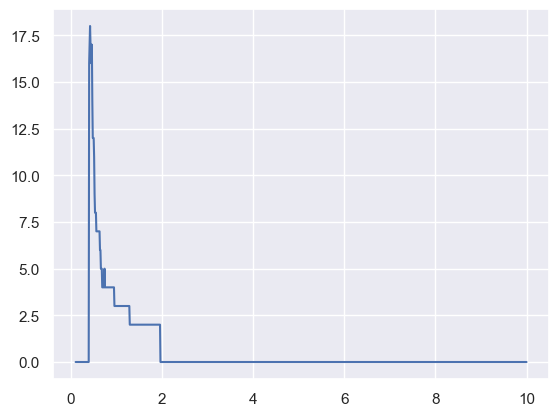

noisy data count: 30


/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


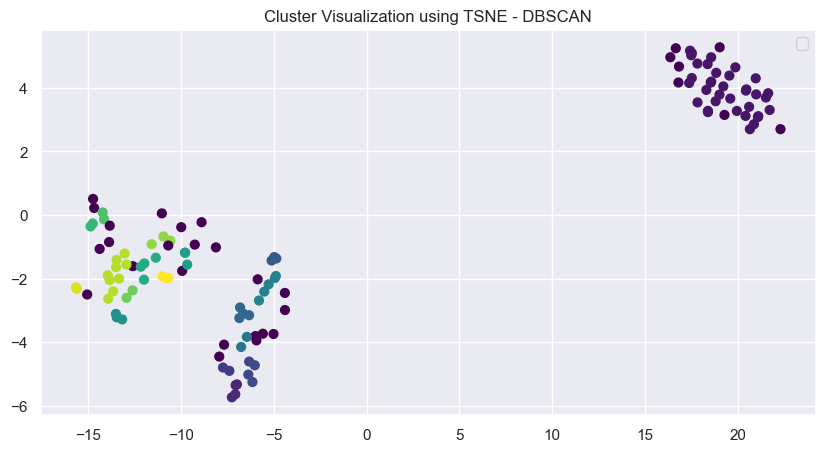

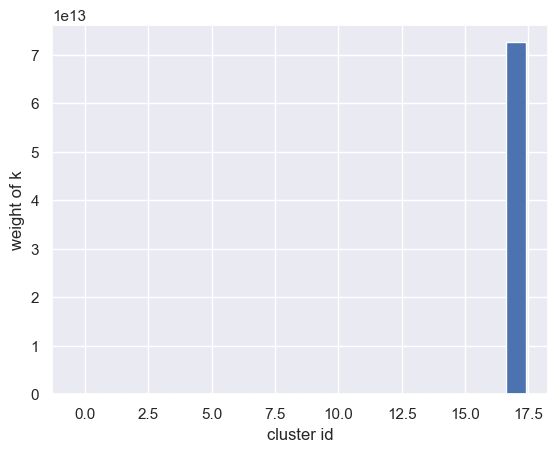

 44%|█████████████████████████████████████████████████████████████████████████████▍                                                                                                  | 22/50 [00:00<00:00, 218.82it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 11] 10
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 12] 11
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 13] 12
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 14] 13
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 15] 14
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 16] 15
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 17] 16
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 18] 17
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 19] 18
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 20] 19
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 21] 20
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 22] 21
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 23] 22
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 24] 23
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 25] 24
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 26] 25
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 27] 

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:00<00:00, 223.44it/s]


[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 57] 56
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 58] 57
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 59] 58
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 60] 59


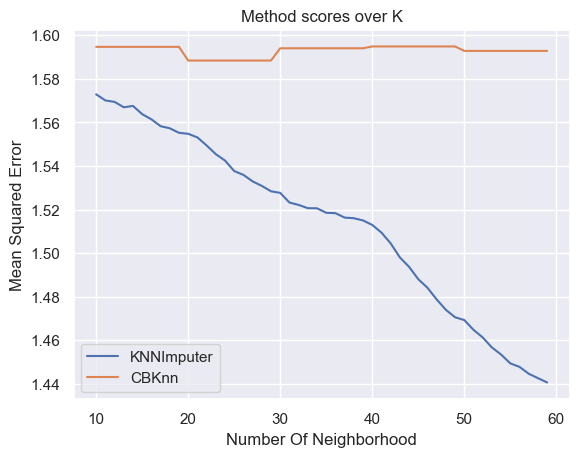

defaultdict(list,
            {'KNNImputer': [1.5728894908765847,
              1.5700983224492575,
              1.5694296472075993,
              1.5669528028646578,
              1.5675764504501466,
              1.5638014416197041,
              1.5614327770732652,
              1.558278833434853,
              1.5573112619244416,
              1.5552317122183485,
              1.5547831311607951,
              1.5531278886108677,
              1.5494508949215076,
              1.5454398674129761,
              1.5425026626831773,
              1.537682514076085,
              1.5359316769247418,
              1.5329403104835009,
              1.5308658997579045,
              1.5284002547075672,
              1.5276666974824369,
              1.5232432237627458,
              1.5221377800189237,
              1.5206446441031207,
              1.5205770828849998,
              1.5185333173612547,
              1.5183637133968295,
              1.516319250240178,
              1.516

In [43]:
density_based_knn(X, y_true, min_samples=2)

### Let's try with more nan values (40%)

In [44]:
df, y_true = load_mnist(nan_percentage=0.4)
X = df.values
df.head()

,0,1,2,3,4,5,6,7,8,9,...,54,55,56,57,58,59,60,61,62,63
0,0.0,-0.335016,-0.043081,0.274072,-0.664478,-0.844129,-0.409724,-0.125023,-0.059078,-0.624009,...,-0.757436,-0.209785,-0.023596,-0.299081,0.086719,0.208293,-0.366771,-1.146647,-0.505670,-0.196008
1,0.0,-0.335016,-1.094937,0.038648,0.268751,-0.138020,-0.409724,-0.125023,-0.059078,-0.624009,...,-0.757436,-0.209785,-0.023596,-0.299081,-1.089383,-0.249010,0.849632,0.548561,-0.505670,-0.196008
2,0.0,-0.335016,-1.094937,-1.844742,0.735366,1.097673,-0.409724,-0.125023,-0.059078,-0.624009,...,0.259230,-0.209785,-0.023596,-0.299081,-1.089383,-2.078218,-0.164037,1.565686,1.695137,-0.196008
3,0.0,-0.335016,0.377661,0.744919,0.268751,-0.844129,-0.409724,-0.125023,-0.059078,1.879691,...,1.072563,-0.209785,-0.023596,-0.299081,0.282736,0.208293,0.241430,0.379040,-0.505670,-0.196008
4,0.0,-0.335016,-1.094937,-2.551014,-0.197863,-1.020657,-0.409724,-0.125023,-0.059078,-0.624009,...,-0.757436,-0.209785,-0.023596,-0.299081,-1.089383,-2.306869,0.849632,-0.468564,-0.505670,-0.196008


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:48<00:00,  1.32s/it]


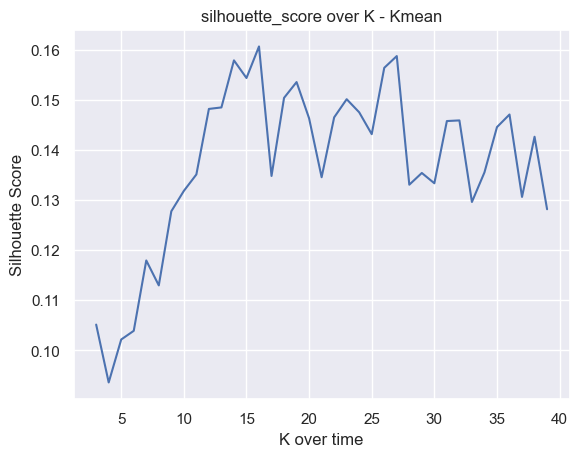

/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 640x480 with 0 Axes>

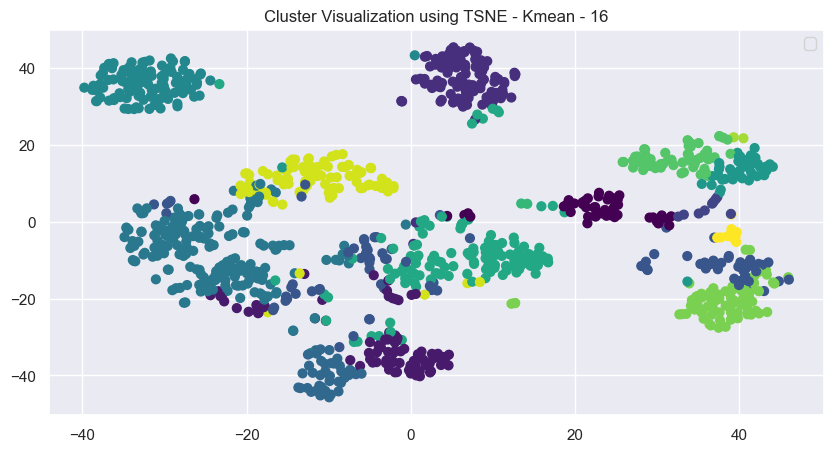

Kmean - 16, score: 0.16061276917204287


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [03:35<00:00,  5.83s/it]


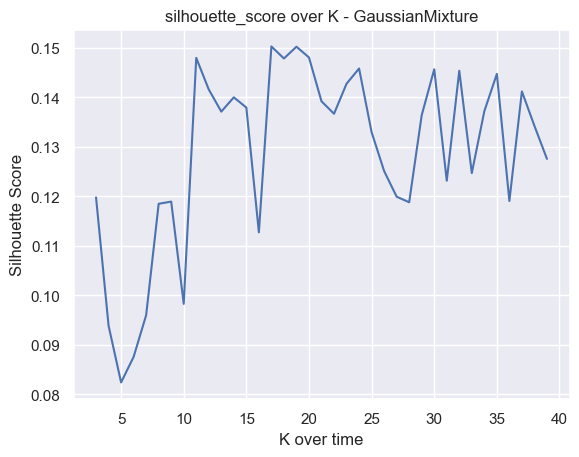

/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 640x480 with 0 Axes>

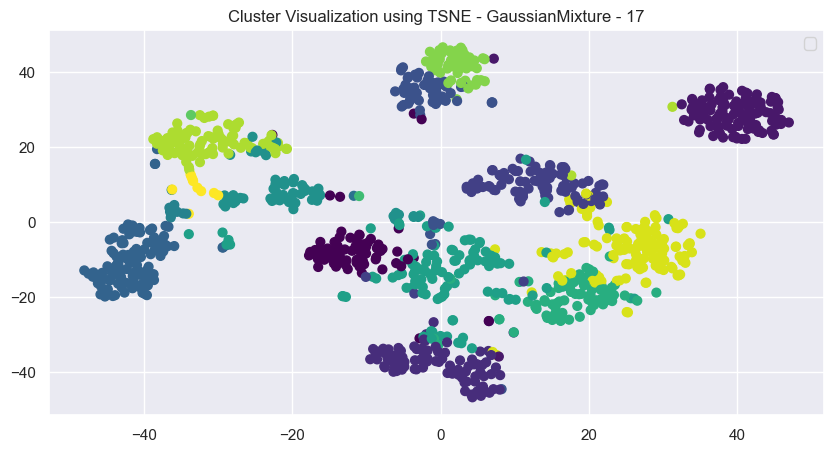

GaussianMixture - 17, score: 0.1503129382223801


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:03<00:00, 12.00it/s]


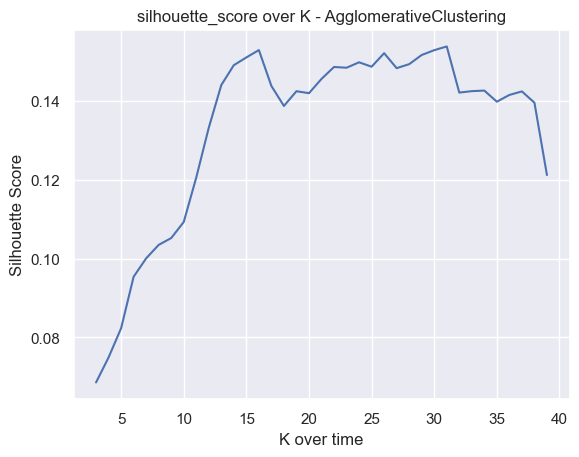

/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 640x480 with 0 Axes>

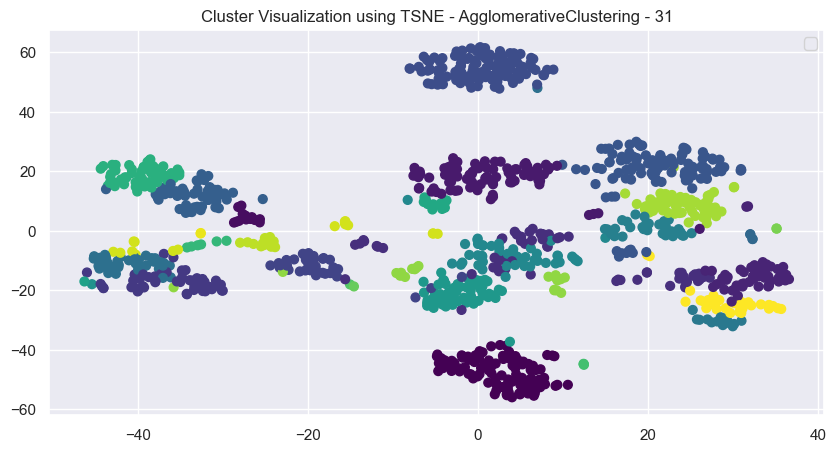

AgglomerativeClustering - 31, score: 0.1539090956287696


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:08<00:00,  4.56it/s]


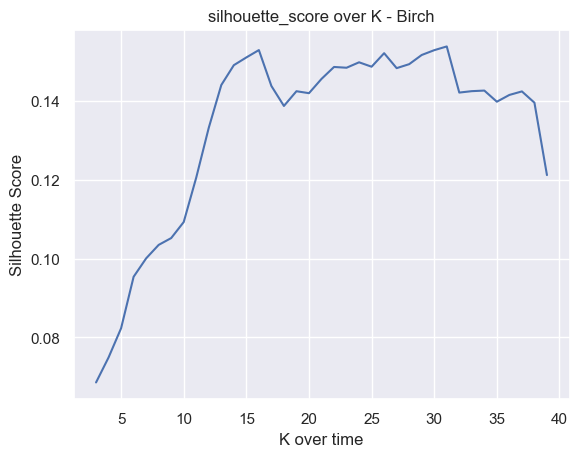

/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 640x480 with 0 Axes>

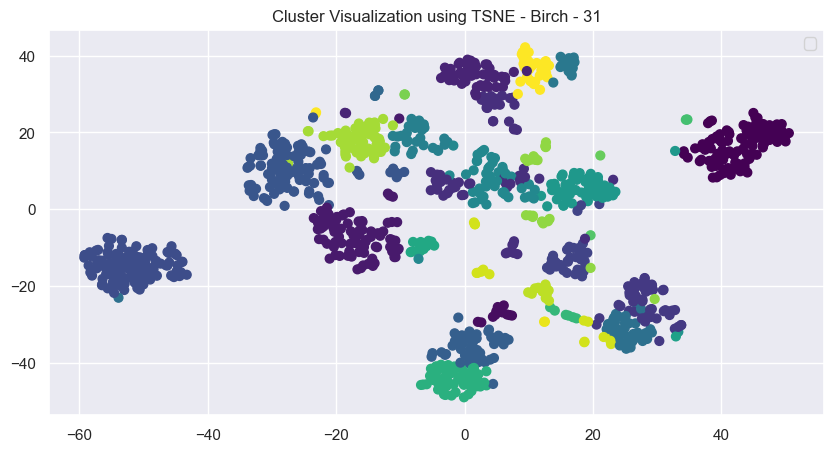

Birch - 31, score: 0.1539090956287696


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 163.84it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 100.14it/s]


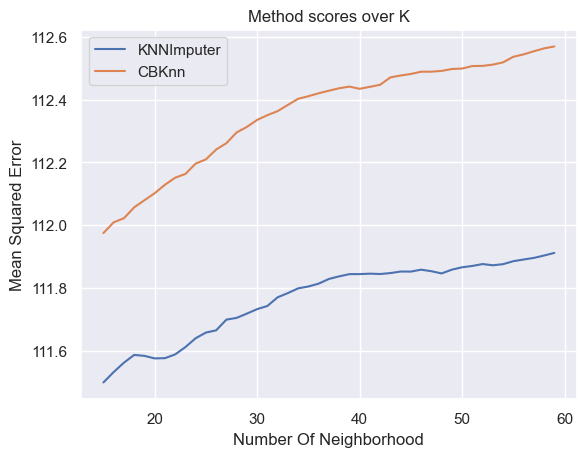

In [45]:
eval_methods_over_k(X, y_true)

noisy data count with eps=0.1: 1093
noisy data count with eps=0.10990990990990991: 1093
noisy data count with eps=0.11981981981981983: 1093
noisy data count with eps=0.12972972972972974: 1093
noisy data count with eps=0.13963963963963966: 1093
noisy data count with eps=0.14954954954954958: 1093
noisy data count with eps=0.15945945945945947: 1093
noisy data count with eps=0.1693693693693694: 1093
noisy data count with eps=0.17927927927927928: 1093
noisy data count with eps=0.1891891891891892: 1093
noisy data count with eps=0.19909909909909912: 1093
noisy data count with eps=0.20900900900900904: 1093
noisy data count with eps=0.21891891891891893: 1093
noisy data count with eps=0.22882882882882885: 1093
noisy data count with eps=0.23873873873873877: 1093
noisy data count with eps=0.24864864864864866: 1093
noisy data count with eps=0.2585585585585586: 1093
noisy data count with eps=0.2684684684684685: 1093
noisy data count with eps=0.2783783783783784: 1093
noisy data count with eps=0.28828

noisy data count with eps=1.7153153153153156: 1089
noisy data count with eps=1.7252252252252256: 1089
noisy data count with eps=1.7351351351351354: 1089
noisy data count with eps=1.7450450450450454: 1089
noisy data count with eps=1.7549549549549552: 1089
noisy data count with eps=1.764864864864865: 1089
noisy data count with eps=1.774774774774775: 1089
noisy data count with eps=1.7846846846846849: 1088
noisy data count with eps=1.794594594594595: 1088
noisy data count with eps=1.8045045045045047: 1088
noisy data count with eps=1.8144144144144148: 1087
noisy data count with eps=1.8243243243243246: 1085
noisy data count with eps=1.8342342342342346: 1085
noisy data count with eps=1.8441441441441444: 1085
noisy data count with eps=1.8540540540540544: 1085
noisy data count with eps=1.8639639639639642: 1084
noisy data count with eps=1.8738738738738743: 1083
noisy data count with eps=1.883783783783784: 1083
noisy data count with eps=1.893693693693694: 1083
noisy data count with eps=1.90360360

noisy data count with eps=3.3801801801801807: 704
noisy data count with eps=3.3900900900900908: 698
noisy data count with eps=3.4000000000000004: 695
noisy data count with eps=3.4099099099099104: 691
noisy data count with eps=3.4198198198198204: 685
noisy data count with eps=3.42972972972973: 675
noisy data count with eps=3.43963963963964: 668
noisy data count with eps=3.44954954954955: 660
noisy data count with eps=3.45945945945946: 657
noisy data count with eps=3.4693693693693697: 655
noisy data count with eps=3.4792792792792797: 651
noisy data count with eps=3.4891891891891897: 647
noisy data count with eps=3.4990990990990998: 642
noisy data count with eps=3.5090090090090094: 632
noisy data count with eps=3.5189189189189194: 622
noisy data count with eps=3.5288288288288294: 616
noisy data count with eps=3.538738738738739: 613
noisy data count with eps=3.548648648648649: 610
noisy data count with eps=3.558558558558559: 605
noisy data count with eps=3.568468468468469: 597
noisy data c

noisy data count with eps=5.035135135135135: 113
noisy data count with eps=5.045045045045045: 113
noisy data count with eps=5.0549549549549555: 112
noisy data count with eps=5.064864864864865: 111
noisy data count with eps=5.074774774774775: 111
noisy data count with eps=5.084684684684685: 110
noisy data count with eps=5.094594594594595: 109
noisy data count with eps=5.104504504504504: 108
noisy data count with eps=5.114414414414415: 108
noisy data count with eps=5.124324324324324: 107
noisy data count with eps=5.134234234234235: 107
noisy data count with eps=5.1441441441441444: 107
noisy data count with eps=5.154054054054054: 106
noisy data count with eps=5.1639639639639645: 104
noisy data count with eps=5.173873873873874: 104
noisy data count with eps=5.183783783783784: 101
noisy data count with eps=5.193693693693694: 98
noisy data count with eps=5.203603603603604: 98
noisy data count with eps=5.213513513513513: 96
noisy data count with eps=5.223423423423424: 95
noisy data count with

noisy data count with eps=6.74954954954955: 24
noisy data count with eps=6.7594594594594595: 24
noisy data count with eps=6.76936936936937: 23
noisy data count with eps=6.7792792792792795: 23
noisy data count with eps=6.78918918918919: 23
noisy data count with eps=6.7990990990991: 23
noisy data count with eps=6.809009009009009: 23
noisy data count with eps=6.81891891891892: 23
noisy data count with eps=6.828828828828829: 23
noisy data count with eps=6.838738738738739: 23
noisy data count with eps=6.848648648648649: 23
noisy data count with eps=6.858558558558559: 23
noisy data count with eps=6.8684684684684685: 23
noisy data count with eps=6.878378378378379: 23
noisy data count with eps=6.8882882882882885: 21
noisy data count with eps=6.898198198198199: 21
noisy data count with eps=6.908108108108109: 21
noisy data count with eps=6.918018018018018: 21
noisy data count with eps=6.927927927927929: 20
noisy data count with eps=6.937837837837838: 20
noisy data count with eps=6.94774774774774

noisy data count with eps=8.454054054054055: 14
noisy data count with eps=8.463963963963964: 14
noisy data count with eps=8.473873873873874: 14
noisy data count with eps=8.483783783783784: 14
noisy data count with eps=8.493693693693695: 14
noisy data count with eps=8.503603603603604: 12
noisy data count with eps=8.513513513513514: 12
noisy data count with eps=8.523423423423424: 12
noisy data count with eps=8.533333333333333: 12
noisy data count with eps=8.543243243243245: 12
noisy data count with eps=8.553153153153154: 12
noisy data count with eps=8.563063063063064: 12
noisy data count with eps=8.572972972972973: 12
noisy data count with eps=8.582882882882883: 12
noisy data count with eps=8.592792792792794: 12
noisy data count with eps=8.602702702702704: 12
noisy data count with eps=8.612612612612613: 12
noisy data count with eps=8.622522522522523: 12
noisy data count with eps=8.632432432432433: 12
noisy data count with eps=8.642342342342342: 12
noisy data count with eps=8.652252252252

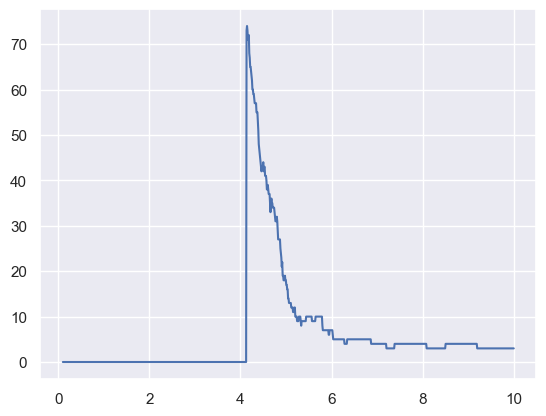

noisy data count: 320


/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/yosefdanan/miniforge3/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


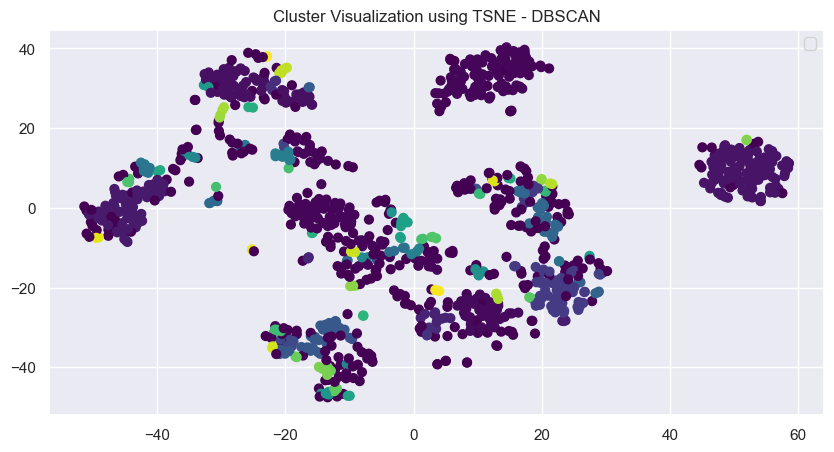

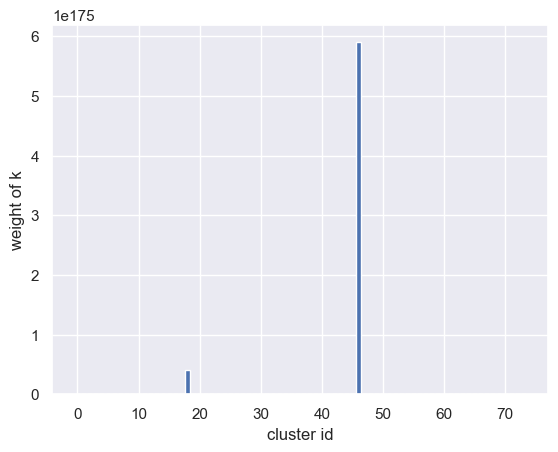

  2%|███▌                                                                                                                                                                              | 1/50 [00:00<00:11,  4.35it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 11  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 10


  6%|██████████▋                                                                                                                                                                       | 3/50 [00:00<00:08,  5.38it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 12  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 11
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 13  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 12


  8%|██████████████▏                                                                                                                                                                   | 4/50 [00:00<00:08,  5.29it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 14  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 13


 10%|█████████████████▊                                                                                                                                                                | 5/50 [00:01<00:09,  4.91it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 15  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 14
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 16  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 15


 14%|████████████████████████▉                                                                                                                                                         | 7/50 [00:01<00:08,  5.17it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 17  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 16


 16%|████████████████████████████▍                                                                                                                                                     | 8/50 [00:01<00:09,  4.54it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 18  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 17


 18%|████████████████████████████████                                                                                                                                                  | 9/50 [00:01<00:08,  4.65it/s]

[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 19  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 18
[ 2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  4  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 20  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2] 19


 22%|██████████████████████████████████████▉                                                                                                                                          | 11/50 [00:02<00:08,  4.51it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 21  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 20


 24%|██████████████████████████████████████████▍                                                                                                                                      | 12/50 [00:02<00:08,  4.70it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 22  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 21
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 23  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 22


 28%|█████████████████████████████████████████████████▌                                                                                                                               | 14/50 [00:02<00:07,  4.94it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 24  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 23


 30%|█████████████████████████████████████████████████████                                                                                                                            | 15/50 [00:03<00:07,  4.55it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 25  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 24


 32%|████████████████████████████████████████████████████████▋                                                                                                                        | 16/50 [00:03<00:07,  4.28it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 26  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 25
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 27  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 26


 36%|███████████████████████████████████████████████████████████████▋                                                                                                                 | 18/50 [00:03<00:06,  4.79it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 28  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 27


 38%|███████████████████████████████████████████████████████████████████▎                                                                                                             | 19/50 [00:03<00:06,  4.92it/s]

[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 29  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 28
[ 3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3 30  3
  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3
  3  3] 29


 42%|██████████████████████████████████████████████████████████████████████████▎                                                                                                      | 21/50 [00:04<00:05,  4.85it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  5  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 31  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 30
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  5  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 32  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 31


 46%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                               | 23/50 [00:04<00:05,  4.80it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 33  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 32
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 34  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 33


 50%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                                        | 25/50 [00:05<00:05,  4.50it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 35  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 34
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 36  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 35


 54%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 27/50 [00:05<00:04,  4.61it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 37  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 36
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  6  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 38  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 37


 58%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 29/50 [00:06<00:04,  4.99it/s]

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  7  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 39  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 38
[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  7  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4 40  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4] 39


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 31/50 [00:06<00:03,  4.78it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  7  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 41  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 40


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 33/50 [00:06<00:03,  5.06it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  7  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 42  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 41
[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  7  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 43  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 42


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 34/50 [00:07<00:03,  5.11it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  7  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 44  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 43
[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 45  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 44


 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 36/50 [00:07<00:02,  5.22it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 46  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 45


 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 37/50 [00:07<00:02,  4.85it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 47  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 46
[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 48  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 47


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 39/50 [00:08<00:02,  4.89it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 49  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 48


 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 41/50 [00:08<00:01,  5.12it/s]

[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  8  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5 50  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5] 49
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  9  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 51  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 50


 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 42/50 [00:08<00:01,  4.72it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  9  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 52  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 51
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  9  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 53  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 52


 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 45/50 [00:09<00:00,  5.37it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  9  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 54  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 53
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  9  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 55  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 54


 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 46/50 [00:09<00:00,  5.11it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  9  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 56  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 55
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 57  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 56


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 48/50 [00:09<00:00,  5.26it/s]

[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 58  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 57
[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 59  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 58


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:10<00:00,  4.85it/s]


[ 6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 10  6  6  6  6  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6 60  6
  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6  6
  6  6] 59


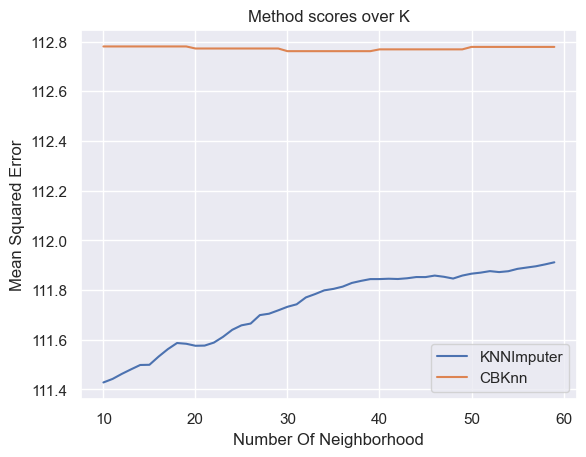

defaultdict(list,
            {'KNNImputer': [111.42827565185935,
              111.44254599642393,
              111.462725280449,
              111.48099626468182,
              111.4985774248248,
              111.49932576708042,
              111.53242525995365,
              111.56225126265211,
              111.58694772385472,
              111.5839399850877,
              111.57587763876045,
              111.57660270391438,
              111.5885644797123,
              111.61186721181494,
              111.64008991191876,
              111.65809246844624,
              111.66524508196994,
              111.6992899388516,
              111.70486418596883,
              111.71847040785755,
              111.73273076455409,
              111.7427636301578,
              111.77038522586255,
              111.78384297879305,
              111.79887546680207,
              111.80477284929182,
              111.81384371787597,
              111.8287221091479,
              111.837016

In [46]:
density_based_knn(X, y_true, min_samples=2)